# Results reproduction: Model M

In [1]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os 
import matplotlib.pyplot as plt

In [2]:
# 0.1 load the model
model_path = "models/model_M/model_training/model_M_23Apr06_0811PM" # <------------------------------------------------------------------------change

query_size, key_size, value_size, num_hiddens = 512, 512, 512, 512
num_layers, dropout = 6, 0.2
lr, training_steps, batch_size, label_smoothing = 0.0004, 300000, 4096, 0.1
ffn_num_input, ffn_num_hiddens, num_heads = 512, 2048, 8

norm_shape = [512] # 512 corresponds to the dim of such number to normalize
device = d2l.try_gpu()

encoder_standard = TransformerEncoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout)
decoder_standard = TransformerDecoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout, shared_embedding=encoder_standard.embedding)
model_standard = EncoderDecoder(encoder_standard, decoder_standard)

model_standard_total_params = sum(p.numel() for p in model_standard.parameters())
model_standard_total_trainable_params = sum(p.numel() for p in model_standard.parameters() if p.requires_grad)

state_dict = torch.load(model_path,map_location=('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in state_dict.items():
	name = k[7:] #remove 'module'
	new_state_dict[name] = v

model_standard.load_state_dict(new_state_dict)

model_use = model_standard # <------------------------------------------------------------------------change
prediction_length = 8 # <------------------------------------------------------------------------change

folder_path  = "models/model_M"
dataset_path = "datasets/dataset_l8_hyper"

# 0.2 create a txt file to record the results
print('Standard model: total number of parameters: {}'.format(model_standard_total_params))
print('Standard model: total number of trainable parameters: {}'.format(model_standard_total_trainable_params))

Standard model: total number of parameters: 44126232
Standard model: total number of trainable parameters: 44126232


## Load training, validation data and all analysis data

In [3]:
import numpy as np

# load training data
train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

# load validation data
validation_dict = np.load('{}/validation_l8_anti/validation_dict_fold0.npy'.format(dataset_path), allow_pickle=True) # <------------------------------------------------------------------------change
validation_dict = validation_dict.tolist()
validation_list = []
for target, value_dict in validation_dict.items():
    for comp, count in value_dict.items():
        validation_list.append([target, comp, count])
validation_array = np.array(validation_list)

# Calculate the split index
split_index = len(validation_array) // 2

# split the data
test_array = validation_array[split_index:]
validation_array = validation_array[:split_index]

# load the data
peptide_pred = np.load('{}/model_evaluation/peptide_pred.npy'.format(folder_path), allow_pickle=True)
peptide_eval = np.load('{}/model_evaluation/peptide_eval.npy'.format(folder_path), allow_pickle=True)
peptide_eval_shuffled = np.load('{}/model_evaluation/peptide_eval_shuffled.npy'.format(folder_path), allow_pickle=True)
peptide_eval_random = np.load('{}/model_evaluation/peptide_eval_random.npy'.format(folder_path), allow_pickle=True)
peptide_samp = np.load('{}/model_evaluation/peptide_samp.npy'.format(folder_path), allow_pickle=True)

# Split peptide_pred
peptide_pred_test = peptide_pred[split_index:]
peptide_pred = peptide_pred[:split_index]

# Split peptide_eval
peptide_eval_test = peptide_eval[split_index:]
peptide_eval = peptide_eval[:split_index]

# Split peptide_eval_shuffled
peptide_eval_shuffled_test = peptide_eval_shuffled[split_index:]
peptide_eval_shuffled = peptide_eval_shuffled[:split_index]

# Split peptide_eval_random
peptide_eval_random_test = peptide_eval_random[split_index:]
peptide_eval_random = peptide_eval_random[:split_index]

# Split peptide_samp
peptide_samp_test = peptide_samp[split_index:]
peptide_samp = peptide_samp[:split_index]

# print all the shapes
print('peptide_pred shape: {}'.format(peptide_pred.shape))
print('peptide_eval shape: {}'.format(peptide_eval.shape))
print('peptide_eval_shuffled shape: {}'.format(peptide_eval_shuffled.shape))
print('peptide_eval_random shape: {}'.format(peptide_eval_random.shape))
print('peptide_samp shape: {}'.format(peptide_samp.shape))
print('peptide_pred_test shape: {}'.format(peptide_pred_test.shape))
print('peptide_eval_test shape: {}'.format(peptide_eval_test.shape))
print('peptide_eval_shuffled_test shape: {}'.format(peptide_eval_shuffled_test.shape))
print('peptide_eval_random_test shape: {}'.format(peptide_eval_random_test.shape))
print('peptide_samp_test shape: {}'.format(peptide_samp_test.shape))
print('train_array shape: {}'.format(train_array.shape))
print('validation_array shape: {}'.format(validation_array.shape))
print('test_array shape: {}'.format(test_array.shape))

peptide_pred shape: (107440, 3)
peptide_eval shape: (107440, 3)
peptide_eval_shuffled shape: (107440, 3)
peptide_eval_random shape: (107440, 3)
peptide_samp shape: (107440, 3)
peptide_pred_test shape: (107441, 3)
peptide_eval_test shape: (107441, 3)
peptide_eval_shuffled_test shape: (107441, 3)
peptide_eval_random_test shape: (107441, 3)
peptide_samp_test shape: (107441, 3)
train_array shape: (1933932, 3)
validation_array shape: (107440, 3)
test_array shape: (107441, 3)


## report validation and test results

#### Validation data report

In [4]:
print("Greedy minibatch prediction number: \n", len(peptide_pred))
print("Greedy minibatch prediction example data: \n", peptide_pred[:10])
correct = 0
for pred, truth in zip(peptide_pred[:, 1], validation_array[:, 1]):
	if pred == truth:
		correct += 1
print("Number of correct prediction: ", correct)
print("Number of total prediction: ", len(peptide_pred))
print("Greedy minibatch prediction accuracy: \n", correct / len(peptide_pred))


print("minibatch evaluatiion number: \n", len(peptide_eval))
print("minibatch evaluatiion example data: \n", peptide_eval[:10])
y = peptide_eval[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_shuffled))
print("minibatch evaluatiion example data: \n", peptide_eval_shuffled[:10])
y = peptide_eval_shuffled[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_random))
print("minibatch evaluatiion example data: \n", peptide_eval_random[:10])
y = peptide_eval_random[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("Candidate single sampling number: \n", len(peptide_samp))
print("Candidate single sampling example data: \n", peptide_samp[:10])
y = peptide_samp[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch samples average log probability: \n", average_log_prob)
print("Minibatch samples median probability: \n", median_prob)

Greedy minibatch prediction number: 
 107440
Greedy minibatch prediction example data: 
 [['KVKTTSLN' 'QYITIQIE' '5.581703953794204e-05']
 ['AVMMATQA' 'TAVVLSGL' '0.030630558729171753']
 ['WYECKVVF' 'KKEWQLVY' '0.03653259575366974']
 ['EVSLHEGA' 'VIKISWFT' '0.004050780087709427']
 ['TQLRLDVI' 'FSQVASLN' '0.08029989898204803']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['LQVHIVYV' 'ISCVLLTV' '0.0013594536576420069']
 ['YHHEVTVP' 'HHLTVTIT' '0.0049583520740270615']
 ['GEVRLGRD' 'GMLSVTSR' '0.2346641570329666']]
Number of correct prediction:  8843
Number of total prediction:  107440
Greedy minibatch prediction accuracy: 
 0.08230640357408786
minibatch evaluatiion number: 
 107440
minibatch evaluatiion example data: 
 [['KVKTTSLN' 'TSEAYHAN' '1.8919321557124948e-15']
 ['AVMMATQA' 'PILYVYGE' '4.880531844278762e-15']
 ['WYECKVVF' 'KKDWQLVY' '0.00025892897974699736']
 ['EVSLHEGA' 'LVRIKWFP' '0.00017169052443932742']
 ['TQLRLDVI' 'FSQVLSLN' '0.

#### Test data report

In [5]:
print("Greedy minibatch prediction number: \n", len(peptide_pred_test))
print("Greedy minibatch prediction example data: \n", peptide_pred_test[:10])
correct = 0
for pred, truth in zip(peptide_pred_test[:, 1], test_array[:, 1]):
	if pred == truth:
		correct += 1
print("Number of correct prediction: ", correct)
print("Number of total prediction: ", len(peptide_pred_test))
print("Greedy minibatch prediction accuracy: \n", correct / len(peptide_pred_test))


print("minibatch evaluatiion number: \n", len(peptide_eval_test))
print("minibatch evaluatiion example data: \n", peptide_eval_test[:10])
y = peptide_eval_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_shuffled_test))
print("minibatch evaluatiion example data: \n", peptide_eval_shuffled_test[:10])
y = peptide_eval_shuffled_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_random_test))
print("minibatch evaluatiion example data: \n", peptide_eval_random_test[:10])
y = peptide_eval_random_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("Candidate single sampling number: \n", len(peptide_samp_test))
print("Candidate single sampling example data: \n", peptide_samp_test[:10])
y = peptide_samp_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch samples average log probability: \n", average_log_prob)
print("Minibatch samples median probability: \n", median_prob)

Greedy minibatch prediction number: 
 107441
Greedy minibatch prediction example data: 
 [['QYYLFIST' 'YIVLHPRE' '0.00810073222965002']
 ['AVTSVLQT' 'LRAFIMRG' '0.06014161556959152']
 ['RDEVWTFI' 'GTQVEIFE' '0.17443186044692993']
 ['WTGTLVNR' 'ITLEALYL' '0.3396604657173157']
 ['KIQIHVSA' 'IAFAQVDV' '0.14546561241149902']
 ['LMDSVVIL' 'LLVTGITV' '0.0001502561935922131']
 ['GFVFIASI' 'HIHLTINK' '0.20423248410224915']
 ['QYFGAIFD' 'VARGRYIR' '0.0006397266406565905']
 ['DVLKDTYT' 'VFLELAVE' '0.05456528067588806']
 ['FKIISESS' 'TVAEIRRI' '0.13329297304153442']]
Number of correct prediction:  9162
Number of total prediction:  107441
Greedy minibatch prediction accuracy: 
 0.08527470891000642
minibatch evaluatiion number: 
 107441
minibatch evaluatiion example data: 
 [['QYYLFIST' 'HWFVEPAE' '2.3730560769763542e-06']
 ['AVTSVLQT' 'LRGFIMKG' '0.002037555444985628']
 ['RDEVWTFI' 'GSQVEIFL' '0.0005159052670933306']
 ['WTGTLVNR' 'ITLEALYD' '0.003138496307656169']
 ['KIQIHVSA' 'VAFTQVDV' '0.000608

## Frequency plot 

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import matplotlib.colors as mcolors
from scipy.stats import gaussian_kde
from sklearn.neighbors import NearestNeighbors

In [20]:
amino_dict_freq = {'A': 0, 'C': 1, 'D': 2, 'E': 3, 'F': 4, 'G': 5, 'H': 6,
                   'I': 7, 'K': 8, 'L': 9, 'M': 10, 'N': 11, 'P': 12, 'Q': 13,
                   'R': 14, 'S': 15, 'T': 16, 'V': 17, 'W': 18, 'Y': 19}

def calculate_amino_freq(data_array):
    amino_count = np.zeros((len(data_array[0][1]), len(amino_dict_freq)))

    for i in range(len(data_array)):
        for j in range(len(data_array[i][1])):
            amino_count[j][amino_dict_freq[data_array[i][1][j]]] += 1

    amino_freq = amino_count / np.sum(amino_count, axis=1)[:, None]
    return amino_freq


def calculate_amino_freq_2_sites(data_array, amino_freq):
    amino_count_2_sites = np.zeros((len(data_array[0][1]), len(data_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

    for i in range(len(data_array)):
        for j in range(len(data_array[i][1])):
            # If any of the amino acid in the data is not in the dictionary, skip this whole sequence
            if any(amino not in amino_dict_freq for amino in data_array[i][1]):
                break
            for k in range(len(data_array[i][1])):
                amino_count_2_sites[j][k][amino_dict_freq[data_array[i][1][j]]][amino_dict_freq[data_array[i][1][k]]] += 1

    amino_freq_2_sites = amino_count_2_sites / np.sum(amino_count_2_sites, axis=(2, 3))[:, :, None, None]
    amino_freq_2_sites_corr = amino_freq_2_sites - np.einsum('ij,kl->ikjl', amino_freq, amino_freq)

    return amino_freq_2_sites_corr

def plot_data(amino_freq, amino_freq_pred, data_label, start_x, end_x, output_file=None):

    r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1] ** 2
    mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
    formatted_mae = format(mae, '.8g')
    pearson_corr, _ = pearsonr(amino_freq.flatten(), amino_freq_pred.flatten())

    print(data_label + ":")
    print("R2:", r2)
    print("Mean Absolute Error:", formatted_mae)
    print("Pearson's correlation coefficient:", pearson_corr)
    print("color bar: 'Normalized Density'")

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    x_data = amino_freq.flatten()
    y_data = amino_freq_pred.flatten()
    
    # Create the scatter plot using the normalized density values as colors
    plt.scatter(x_data, y_data, c="r", s=200, marker="x", linewidth=2)
    
    x = np.linspace(start_x, end_x, 100)
    y = x
    plt.plot(x, y, 'gray', linestyle='--', linewidth=3)  # Change the y=x line to gray
    
    plt.grid(True)  # Add grid lines
    
    if output_file != None:
        plt.savefig(output_file, format='png', bbox_inches='tight', dpi=300)
    
    plt.show()

def plot_data_exclude_diagonal(amino_freq, amino_freq_pred, data_label, start_x, end_x, output_file=None):

    # Determine the dimensionality of the input data
    data_dims = len(amino_freq.shape)
    
    mask = np.ones(amino_freq.shape, dtype=bool)
    
    if data_dims == 4:
        for i in range(amino_freq.shape[0]):
            for j in range(amino_freq.shape[1]):
                if i == j:
                    mask[i, j, :, :] = False
                    
    elif data_dims == 6:
        for i in range(amino_freq.shape[0]):
            for j in range(amino_freq.shape[1]):
                for k in range(amino_freq.shape[2]):
                    if i == j or i == k or j == k:
                        mask[i, j, k, :, :, :] = False
    
    # Flatten the arrays considering the mask
    amino_freq = amino_freq[mask].flatten()
    amino_freq_pred = amino_freq_pred[mask].flatten()

    r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1] ** 2
    mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
    formatted_mae = format(mae, '.8g')
    pearson_corr, _ = pearsonr(amino_freq.flatten(), amino_freq_pred.flatten())

    print(data_label + ":")
    print("R2:", r2)
    print("Mean Absolute Error:", formatted_mae)
    print("Pearson's correlation coefficient:", pearson_corr)
    print("color bar: 'Normalized Density'")

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    x_data = amino_freq.flatten()
    y_data = amino_freq_pred.flatten()
    
    # Create the scatter plot using the normalized density values as colors
    plt.scatter(x_data, y_data, c="r", s=200, marker="x", linewidth=2)
    
    x = np.linspace(start_x, end_x, 100)
    y = x
    plt.plot(x, y, 'gray', linestyle='--', linewidth=3)  # Change the y=x line to gray
    
    plt.grid(True)  # Add grid lines
    
    if output_file != None:
        plt.savefig(output_file, format='png', bbox_inches='tight', dpi=300)
    
    plt.show()

In [77]:
# Calculate amino frequencies
amino_freq = calculate_amino_freq(validation_array)
amino_freq_train = calculate_amino_freq(train_array)
amino_freq_pred = calculate_amino_freq(peptide_samp)
print("frequency calculation done")

amino_corr = calculate_amino_freq_2_sites(validation_array, amino_freq)
amino_corr_train = calculate_amino_freq_2_sites(train_array, amino_freq_train)
amino_corr_pred = calculate_amino_freq_2_sites(peptide_samp, amino_freq_pred)
print("correlation calculation done")

frequency calculation done
correlation calculation done


In [78]:
amino_freq_3_sites_corr = np.load('{}/model_evaluation/amino_freq_3_sites_corr.npy'.format(folder_path), allow_pickle=True)
amino_freq_3_sites_train_corr = np.load('{}/model_evaluation/amino_freq_3_sites_train_corr.npy'.format(folder_path), allow_pickle=True)
amino_freq_3_sites_pred_corr = np.load('{}/model_evaluation/amino_freq_3_sites_pred_corr.npy'.format(folder_path), allow_pickle=True)

Validation data, 1-site:
R2: 0.9987097749871108
Mean Absolute Error: 0.00092516754
Pearson's correlation coefficient: 0.9993546792741361
color bar: 'Normalized Density'


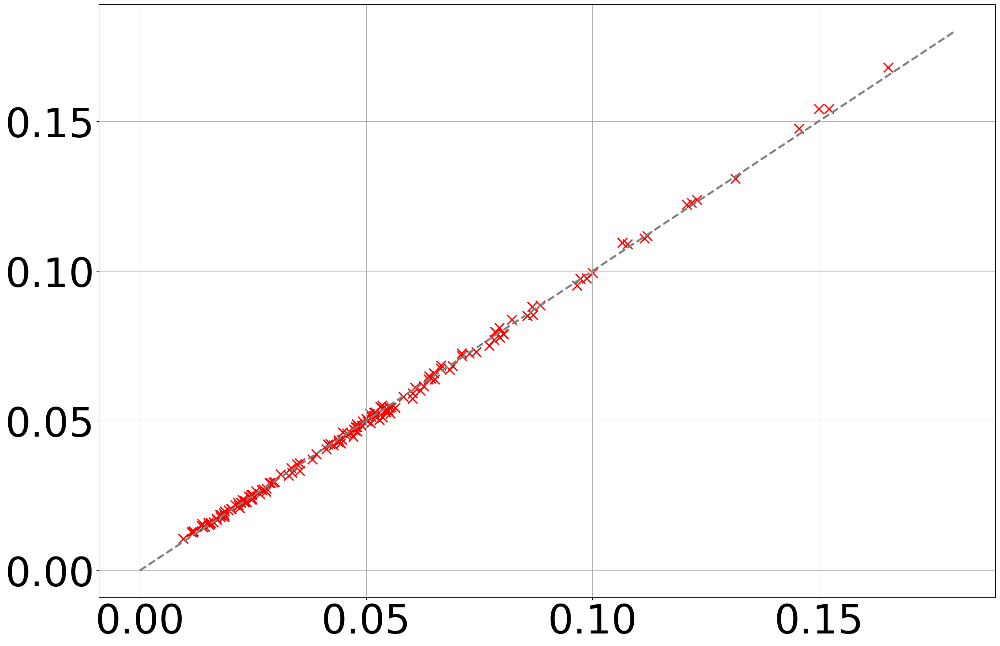

Training data, 1-site:
R2: 0.9985468464573349
Mean Absolute Error: 0.00091261325
Pearson's correlation coefficient: 0.9992731590798059
color bar: 'Normalized Density'


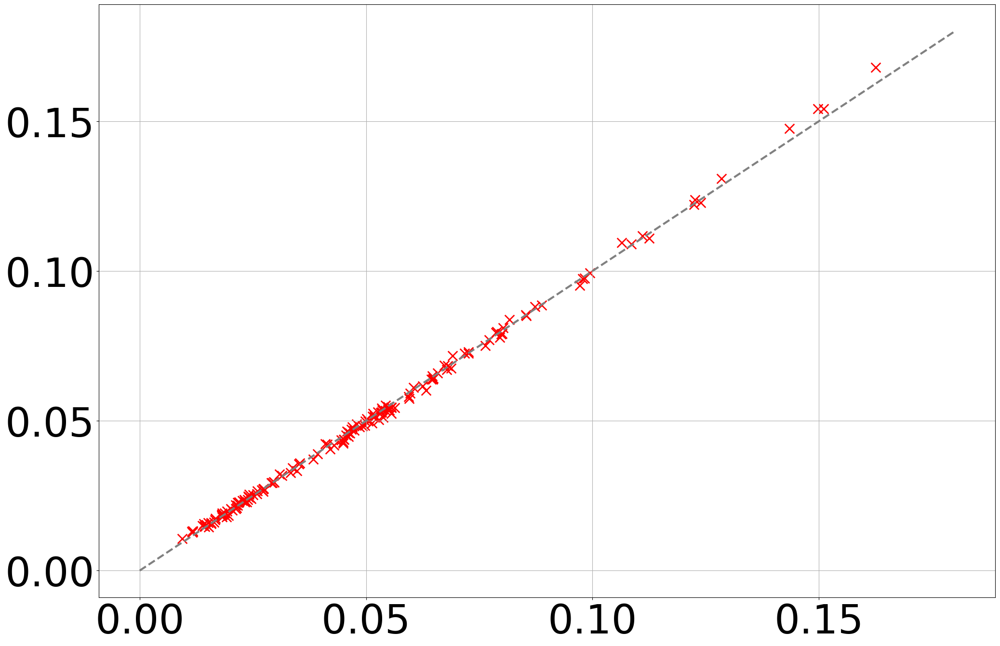

Validation data, 2-sites:
R2: 0.9062398464532575
Mean Absolute Error: 0.00013309604
Pearson's correlation coefficient: 0.9519663053140368
color bar: 'Normalized Density'


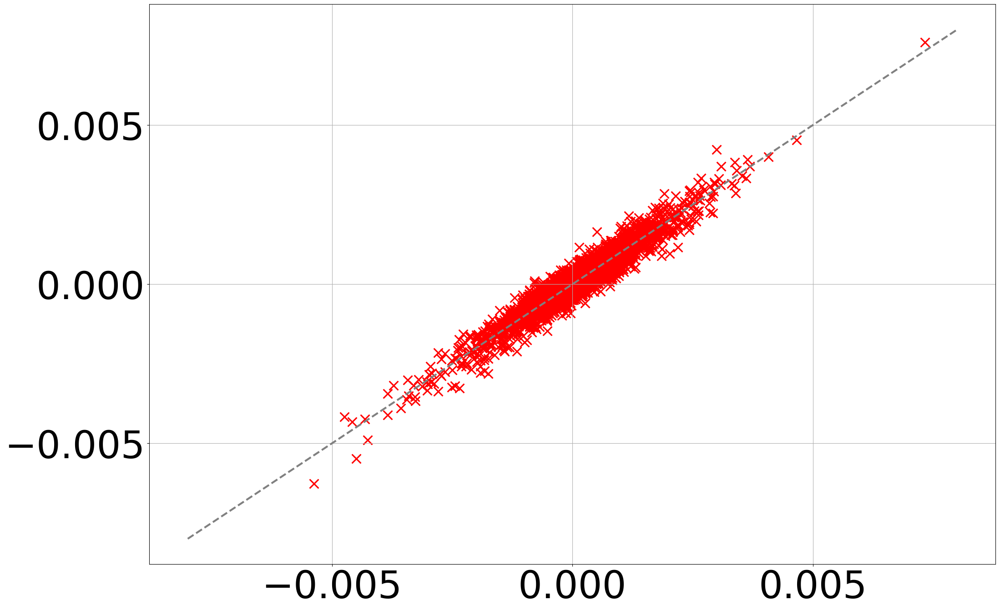

Training data, 2-sites:
R2: 0.9309985009813536
Mean Absolute Error: 0.00011378134
Pearson's correlation coefficient: 0.9648826358585547
color bar: 'Normalized Density'


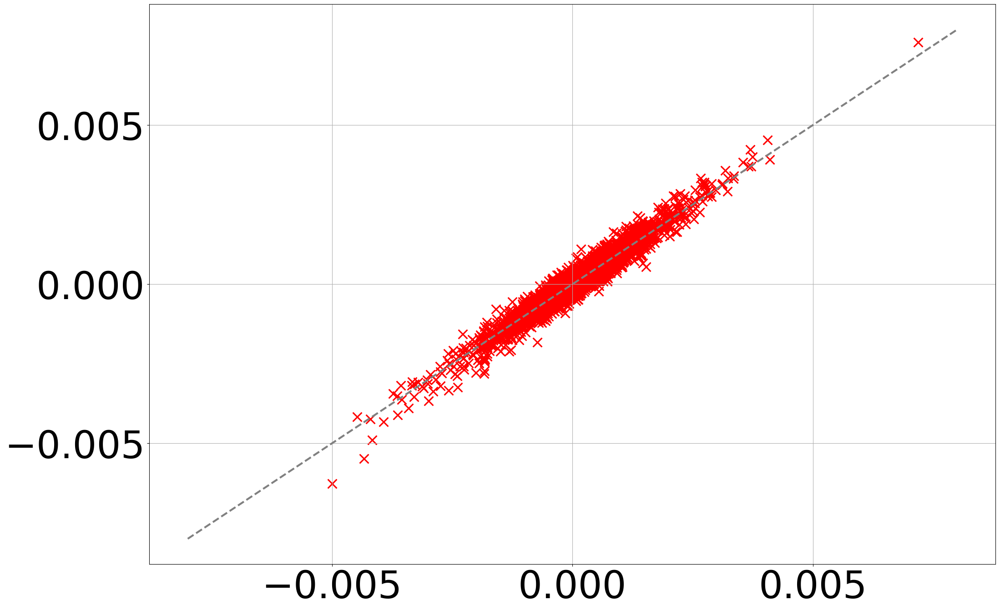

Validation data, 3-sites:
R2: 0.46089116240656675
Mean Absolute Error: 2.781484e-05
Pearson's correlation coefficient: 0.6788896540724192
color bar: 'Normalized Density'


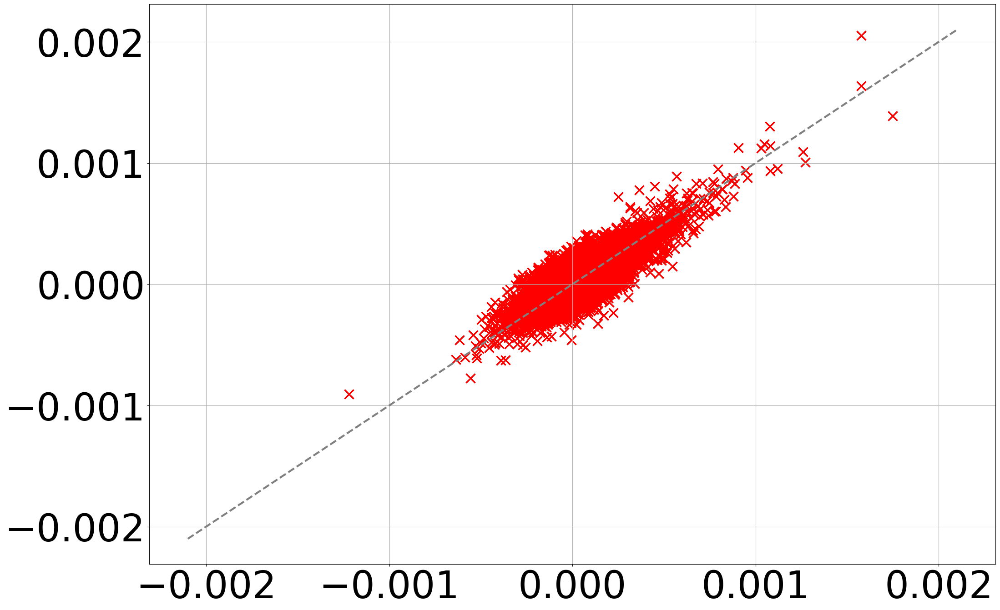

Training data, 3-sites:
R2: 0.5819409873660262
Mean Absolute Error: 2.2233181e-05
Pearson's correlation coefficient: 0.7628505668648491
color bar: 'Normalized Density'


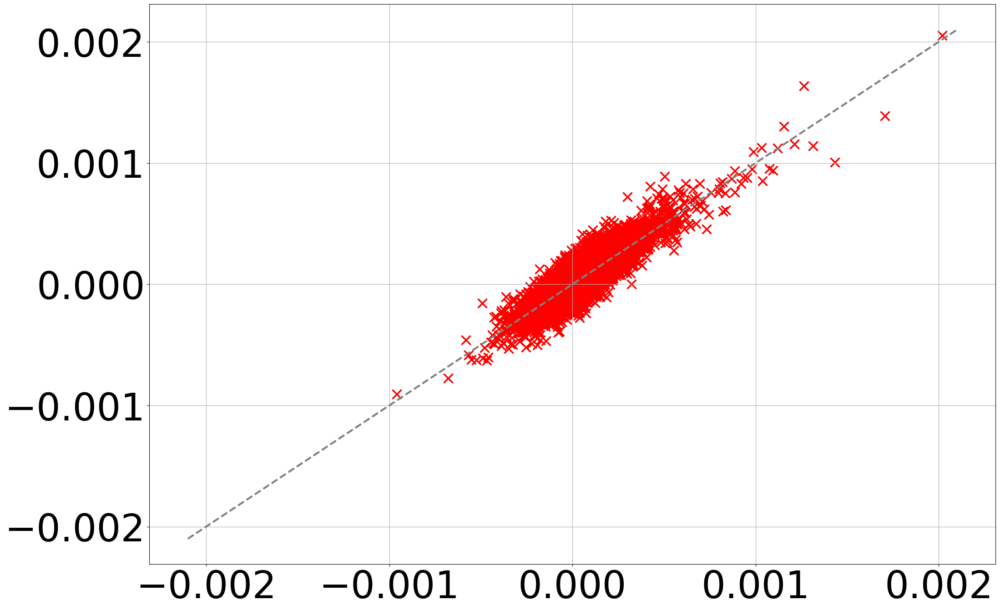

In [82]:
plt.rcParams.update({
    'font.size': 60,
    'font.family': 'Calibre',
    'lines.linewidth': 3,
})

# Plot data for amino acid frequencies and correlations and 3-site correlations
plot_data_exclude_diagonal(amino_freq, amino_freq_pred, "Validation data, 1-site", 0, 0.18, "{}/model_evaluation/adobe_plots/amino_freq_validation_exclude_diagonal.png".format(folder_path))
plot_data_exclude_diagonal(amino_freq_train, amino_freq_pred, "Training data, 1-site", 0, 0.18, "{}/model_evaluation/adobe_plots/amino_freq_train_exclude_diagonal.png".format(folder_path))
plot_data_exclude_diagonal(amino_corr, amino_corr_pred, "Validation data, 2-sites", -0.008, 0.008, "{}/model_evaluation/adobe_plots/amino_2_sites_validation_exclude_diagonal.png".format(folder_path))
plot_data_exclude_diagonal(amino_corr_train, amino_corr_pred, "Training data, 2-sites", -0.008, 0.008, "{}/model_evaluation/adobe_plots/amino_2_sites_train_exclude_diagonal.png".format(folder_path))
plot_data_exclude_diagonal(amino_freq_3_sites_corr, amino_freq_3_sites_pred_corr, "Validation data, 3-sites", -0.0021, 0.0021, "{}/model_evaluation/adobe_plots/amino_3_sites_validation_exclude_diagonal.png".format(folder_path))
plot_data_exclude_diagonal(amino_freq_3_sites_train_corr, amino_freq_3_sites_pred_corr, "Training data, 3-sites", -0.0021, 0.0021, "{}/model_evaluation/adobe_plots/amino_3_sites_train_exclude_diagonal.png".format(folder_path))

In [46]:
import numpy as np
import os

# Define a function to reverse a string
def reverse_string(s):
    return s[::-1]

# Vectorize the function
vfunc = np.vectorize(reverse_string)

# Define the function to calculate amino frequencies incrementally
def calculate_amino_freq_incrementally(data_array, amino_count):
    for i in range(len(data_array)):
        for j in range(len(data_array[i])):
            amino_count[j][amino_dict_freq[data_array[i][j]]] += 1
    return amino_count

# Initialize amino_count for targets and comps
amino_count_target = np.zeros((8, len(amino_dict_freq)))  # Assuming length 8 strands
amino_count_comp = np.zeros((8, len(amino_dict_freq)))  # Assuming length 8 strands

# Load length 8 antiparallel data from the AF2 beta strand database
type = 'antiparallel'
length = 'length_8'
length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)

for subfolder in length_subfolders:
    data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True).tolist()
    
    # Update amino_count incrementally for each target and comp
    for target, comps in data.items():
        amino_count_target = calculate_amino_freq_incrementally([target], amino_count_target)
        
        # Reverse each comp string and update amino_count for comps
        comps_reversed = vfunc(list(comps.keys()))
        amino_count_comp = calculate_amino_freq_incrementally(comps_reversed, amino_count_comp)

# Calculate amino frequencies
amino_freq_antiparallel_target = amino_count_target / np.sum(amino_count_target, axis=1)[:, None]
amino_freq_antiparallel_comp = amino_count_comp / np.sum(amino_count_comp, axis=1)[:, None]

print("frequency calculation done")

frequency calculation done


Training data, target and comp:
R2: 0.9923156900571183
Mean Absolute Error: 0.002126369
Pearson's correlation coefficient: 0.9961504354549662
color bar: 'Normalized Density'


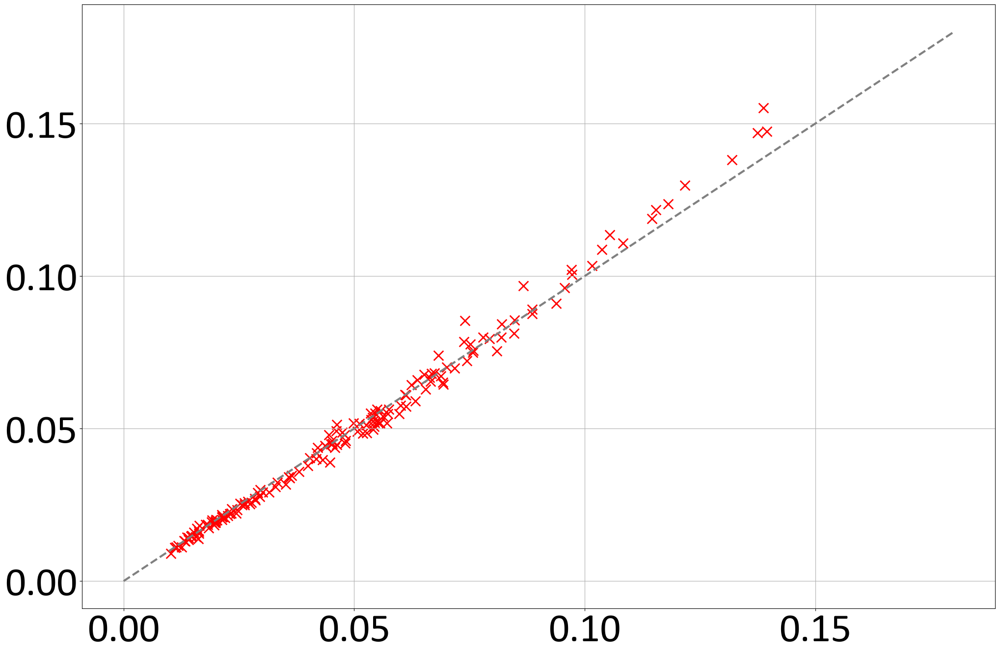

In [48]:
# Plot data for amino acid frequencies and correlations and 3-site correlations
plot_data_exclude_diagonal(amino_freq_antiparallel_target, amino_freq_antiparallel_comp, "Training data, target and comp", 0, 0.18, "{}/model_evaluation/adobe_plots/amino_freq_train_target_comp_exclude_diagonal.png".format(folder_path))

#### property plot

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
from scipy.stats import ks_2samp
from astropy.stats import kuiper_two
from Bio.SeqUtils.ProtParam import ProteinAnalysis

In [17]:
kyte_doolittle_scale = {
    'A': 1.8, 'R': -4.5, 'N': -3.5, 'D': -3.5, 'C': 2.5,
    'Q': -3.5, 'E': -3.5, 'G': -0.4, 'H': -3.2, 'I': 4.5,
    'L': 3.8, 'K': -3.9, 'M': 1.9, 'F': 2.8, 'P': -1.6,
    'S': -0.8, 'T': -0.7, 'W': -0.9, 'Y': -1.3, 'V': 4.2
}

def hydrophobicity(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

def calculate_hydrophobicity_array(peptide_array, scale):
    return np.array([hydrophobicity(sequence, scale) for sequence in peptide_array[:, 1]])

def calculate_charge_array(peptide_array):
    amino_positive = ['R', 'K', 'H']
    amino_negative = ['D', 'E']
    charge_array = []
    for peptide in peptide_array:
        sequence = peptide[1]
        charge = sum(1 for aa in sequence if aa in amino_positive) - sum(1 for aa in sequence if aa in amino_negative)
        charge_array.append(charge)
    return np.array(charge_array)

molecular_weights = {
    'A': 89.094,   # Alanine
    'R': 174.203,  # Arginine
    'N': 132.119,  # Asparagine
    'D': 133.104,  # Aspartic acid
    'C': 121.154,  # Cysteine
    'E': 147.131,  # Glutamic acid
    'Q': 146.146,  # Glutamine
    'G': 75.067,   # Glycine
    'H': 155.156,  # Histidine
    'I': 131.175,  # Isoleucine
    'L': 131.175,  # Leucine
    'K': 146.189,  # Lysine
    'M': 149.208,  # Methionine
    'F': 165.192,  # Phenylalanine
    'P': 115.132,  # Proline
    'S': 105.093,  # Serine
    'T': 119.120,  # Threonine
    'W': 204.228,  # Tryptophan
    'Y': 181.191,  # Tyrosine
    'V': 117.148,  # Valine
}

def calculate_molecular_weights(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

def calculate_molecular_weight_array(peptide_array, scale):
    return np.array([calculate_molecular_weights(sequence, scale) for sequence in peptide_array[:, 1]])

def calculate_isoelectric_point(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.isoelectric_point()

def calculate_isoelectric_point_array(peptide_array):
    return np.array([calculate_isoelectric_point(sequence) for sequence in peptide_array[:, 1]])

def calculate_aromaticity(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.aromaticity()

def calculate_aromaticity_array(peptide_array):
    return np.array([calculate_aromaticity(sequence) for sequence in peptide_array[:, 1]])


def plot_cdf(data_arrays, labels, colors, linestyles, markers, x_label, y_label, title, filename, legend_filename=None):
    fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))

    lines = []
    for data_array, label, color, linestyle, marker in zip(data_arrays, labels, colors, linestyles, markers):
        hist, bin_edges = np.histogram(data_array, bins=100, density=True)
        cdf = np.cumsum(hist) / hist.sum()
        line, = ax.step(bin_edges[:-1], cdf, color=color, alpha=0.8, lw=8, linestyle=linestyle, marker=marker, markevery=10, markersize=35, label=label)
        lines.append(line)

    # ax.set_xlabel(x_label)
    # ax.set_ylabel(y_label)
    # ax.set_title(title)
    fig.savefig(filename, format='png', bbox_inches='tight', dpi=300)
    plt.show()

    # Create a separate figure for the legend
    if legend_filename is not None:
        legend_fig, legend_ax = plt.subplots()
        legend_ax.axis('off')
        legend_fig.legend(lines, labels, loc='center', fontsize=35)
        legend_fig.savefig(legend_filename, format='png', bbox_inches='tight', dpi=300)
        plt.show()


def plot_cdf(data_arrays, labels, colors, linestyles, markers, x_label, y_label, title, filename, legend_filename=None):
    fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))

    lines = []
    for data_array, label, color, linestyle, marker in zip(data_arrays, labels, colors, linestyles, markers):
        hist, bin_edges = np.histogram(data_array, bins=100, density=True)
        cdf = np.cumsum(hist) / hist.sum()
        line, = ax.step(bin_edges[:-1], cdf, color=color, alpha=0.8, lw=8, linestyle=linestyle, marker=marker, markevery=10, markersize=35, label=label)
        lines.append(line)

    # ax.set_xlabel(x_label)
    # ax.set_ylabel(y_label)
    # ax.set_title(title)savefig(filename, format='png', bbox_inches='tight', dpi=300)
    fig.savefig(filename, format='png', bbox_inches='tight', dpi=300)
    plt.show()

    # Calculate and print Kolmogorov-Smirnov test statistics
    for i in range(len(data_arrays)):
        for j in range(i+1, len(data_arrays)):
            D, p = ks_2samp(data_arrays[i], data_arrays[j])
            print(f'{labels[i]} vs. {labels[j]}: D = {D}, p-value = {p}')

    # Create a separate figure for the legend
    if legend_filename is not None:
        legend_fig, legend_ax = plt.subplots()
        legend_ax.axis('off')
        legend_fig.legend(lines, labels, loc='center', fontsize=35)
        legend_fig.savefig(legend_filename, format='png', bbox_inches='tight', dpi=300)
        plt.show()

In [19]:
# a more streamline version using validation only as natural:

# Calculate charge arrays
charge_arrays = [
    calculate_charge_array(validation_array),
    calculate_charge_array(peptide_samp),
    calculate_charge_array(peptide_eval_random),
]
print("charge calculation done")

# Calculate hydrophobicity arrays
hydrophobicity_arrays = [
    calculate_hydrophobicity_array(validation_array, kyte_doolittle_scale),
    calculate_hydrophobicity_array(peptide_samp, kyte_doolittle_scale),
    calculate_hydrophobicity_array(peptide_eval_random, kyte_doolittle_scale),
]
print("hydrophobicity calculation done")

# Calculate molecular weight arrays
molecular_weight_arrays = [
    calculate_molecular_weight_array(validation_array, molecular_weights),
    calculate_molecular_weight_array(peptide_samp, molecular_weights),
    calculate_molecular_weight_array(peptide_eval_random, molecular_weights),
]
print("molecular weight calculation done")

# Calculate isoelectric point arrays
isoelectric_point_arrays = [
    calculate_isoelectric_point_array(validation_array),
    calculate_isoelectric_point_array(peptide_samp),
    calculate_isoelectric_point_array(peptide_eval_random),
]
print("isoelectric point calculation done")

# Calculate aromaticity arrays
aromaticity_arrays = [
    calculate_aromaticity_array(validation_array),
    calculate_aromaticity_array(peptide_samp),
    calculate_aromaticity_array(peptide_eval_random),
]
print("aromaticity calculation done")

charge calculation done
hydrophobicity calculation done
molecular weight calculation done
isoelectric point calculation done
aromaticity calculation done


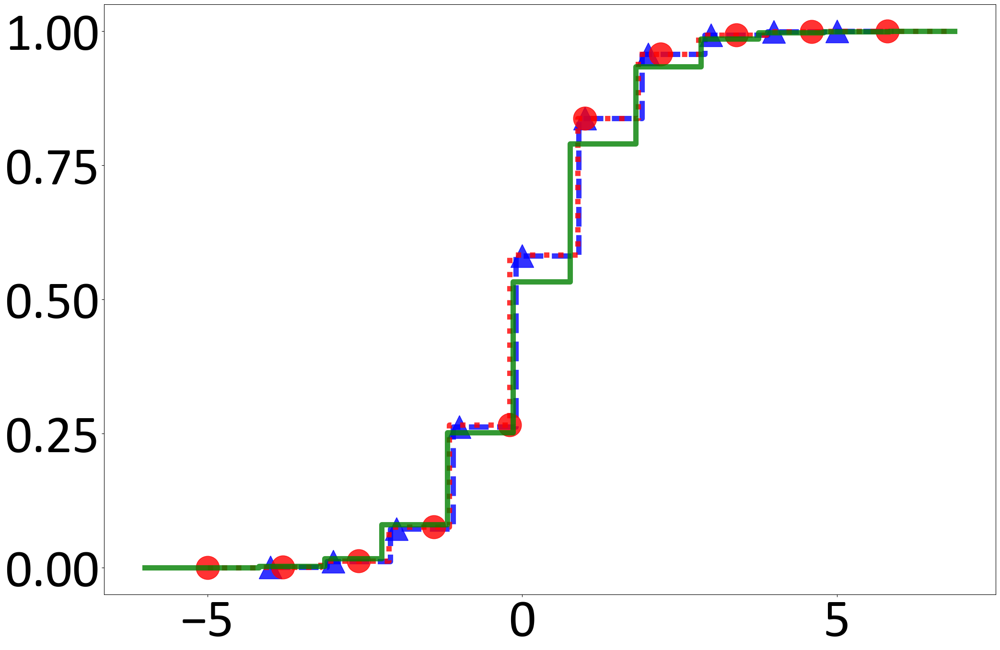

Natural vs. Generated: D = 0.0033786299329858493, p-value = 0.5707068213389728
Natural vs. Random: D = 0.04842702903946394, p-value = 6.353039821776527e-110
Generated vs. Random: D = 0.05033507073715571, p-value = 1.0001992434764388e-118


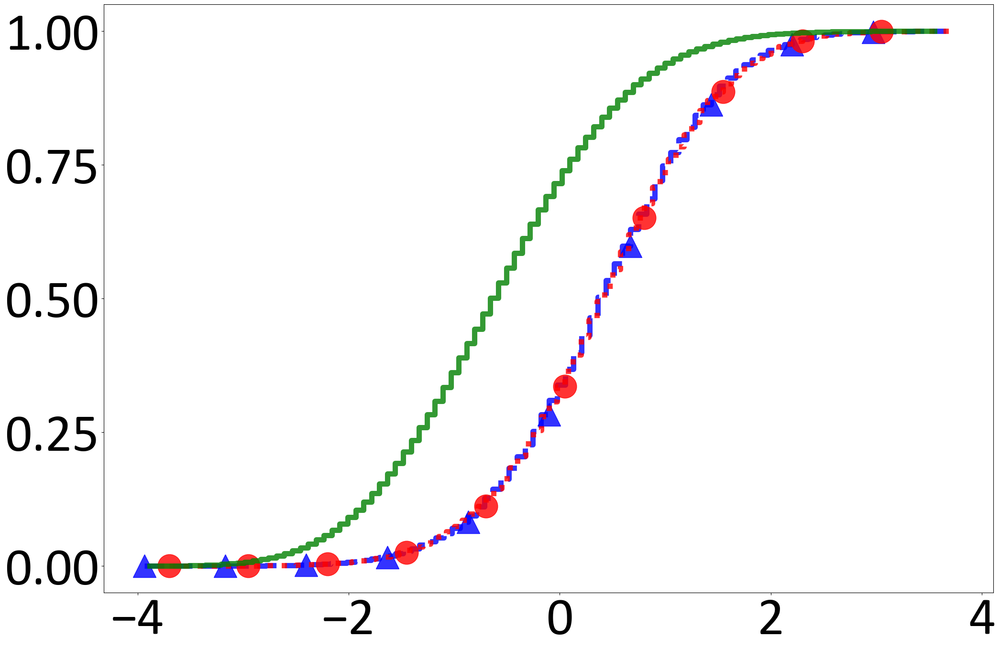

Natural vs. Generated: D = 0.002997021593447502, p-value = 0.7189542823750583
Natural vs. Random: D = 0.3976917349218168, p-value = 0.0
Generated vs. Random: D = 0.39571854058078926, p-value = 0.0


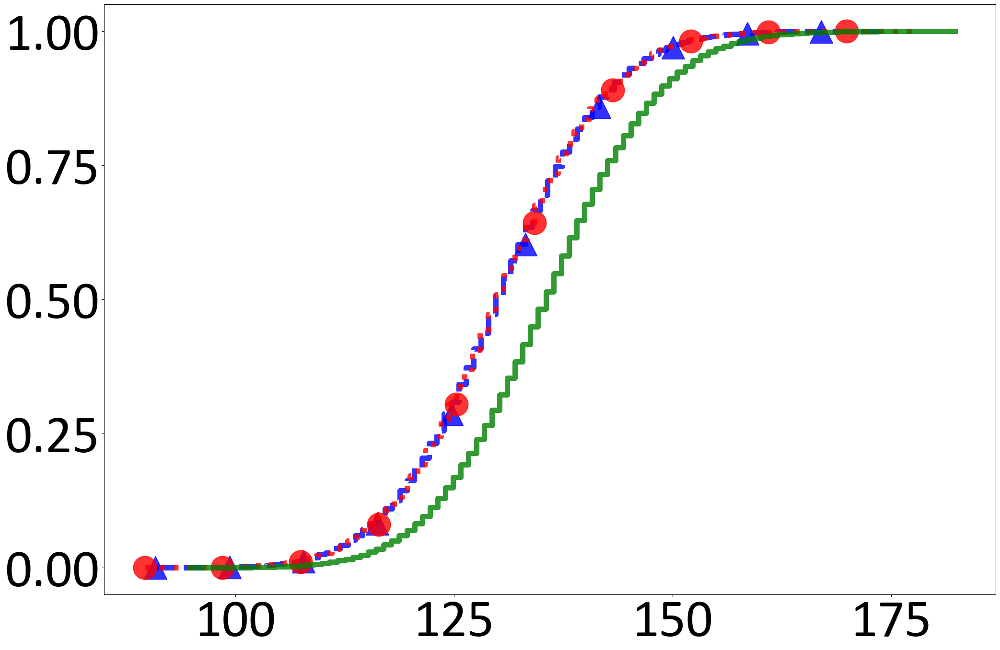

Natural vs. Generated: D = 0.003322784810126586, p-value = 0.5921957567628379
Natural vs. Random: D = 0.2098938942665674, p-value = 0.0
Generated vs. Random: D = 0.20997766195085632, p-value = 0.0


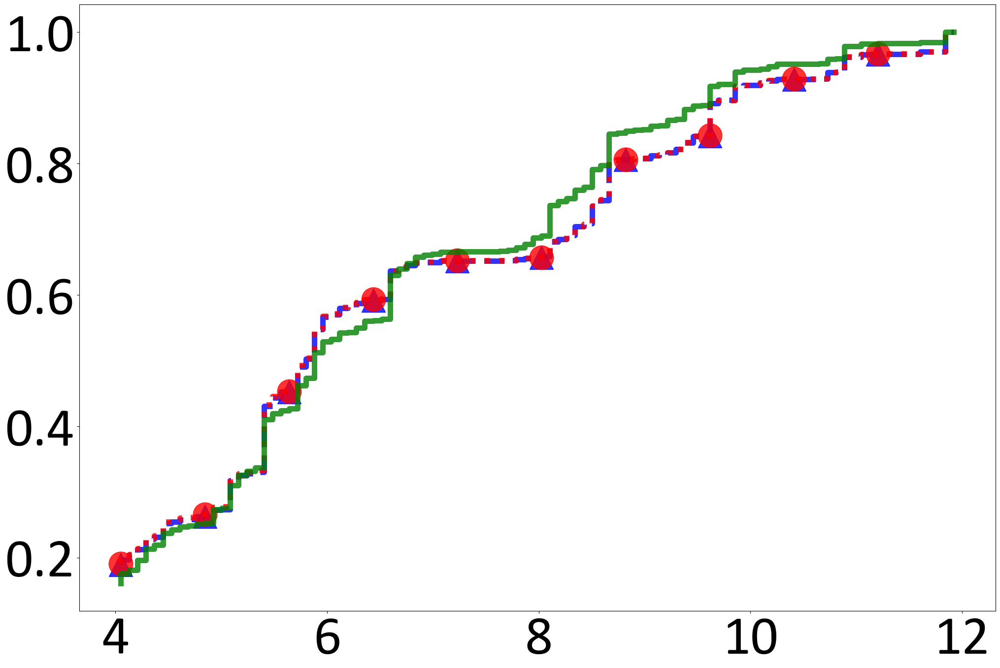

Natural vs. Generated: D = 0.004430379746835467, p-value = 0.2416073567057463
Natural vs. Random: D = 0.05868391660461658, p-value = 2.962225272374192e-161
Generated vs. Random: D = 0.05849776619508562, p-value = 3.0977923506972293e-160


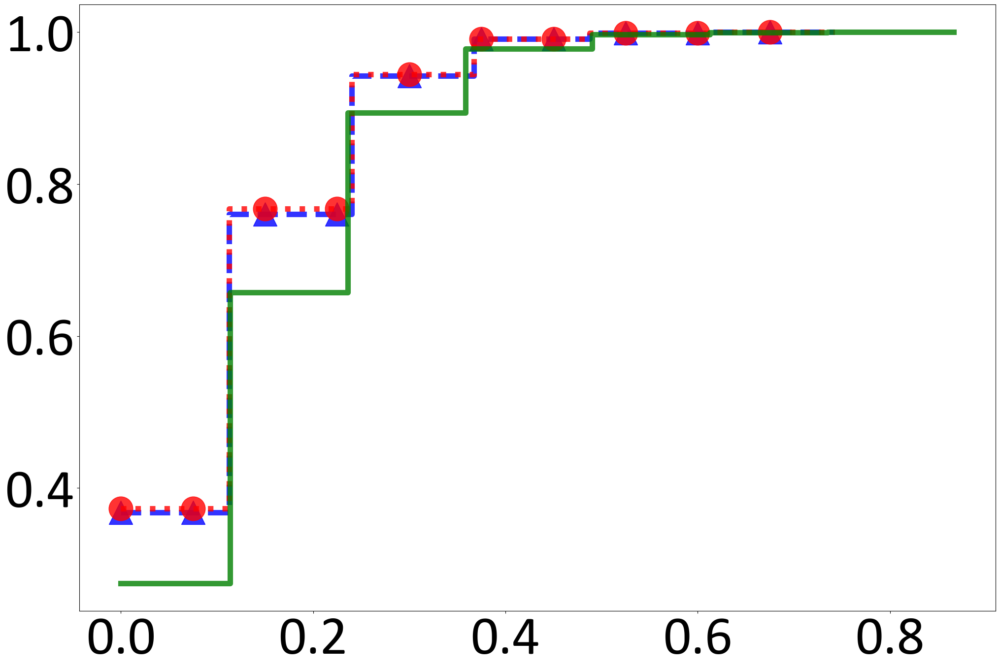

Natural vs. Generated: D = 0.006841027550260614, p-value = 0.013041739874348262
Natural vs. Random: D = 0.10315524944154886, p-value = 0.0
Generated vs. Random: D = 0.10999627699180947, p-value = 0.0


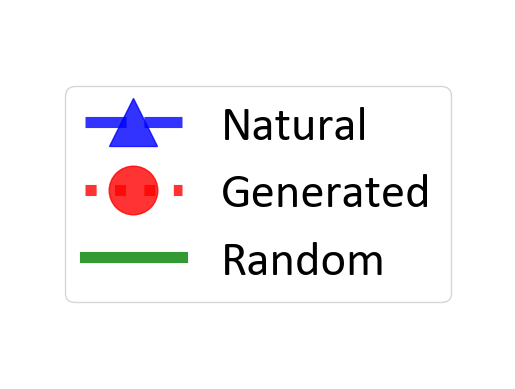

In [27]:
plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Calibri',
    'lines.linewidth': 3,
})

labels = [
    'Natural',
    'Generated',
    'Random'
]

colors = ['b', 'r', 'g']
linestyles = ['--', ':', '-']
markers = ['^', 'o', None]

# Plot charge CDF
plot_cdf(
    data_arrays=charge_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Normalized net charge',
    y_label='Cumulative probability density',
    title='Charge CDF',
    filename='{}/model_evaluation/adobe_plots/charge_distribution_CDF.png'.format(folder_path)
)


# Plot hydrophobicity CDF
plot_cdf(
    data_arrays=hydrophobicity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Hydrophobicity',
    y_label='Cumulative probability density',
    title='Hydrophobicity CDF',
    filename='{}/model_evaluation/adobe_plots/hydrophobicity_distribution_CDF.png'.format(folder_path)
)

# Plot molecular weight CDF
plot_cdf(
    data_arrays=molecular_weight_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Molecular weight',
    y_label='Cumulative probability density',
    title='Molecular weight CDF',
    filename='{}/model_evaluation/adobe_plots/molecular_weight_distribution_CDF.png'.format(folder_path)
)

# Plot isoelectric point CDF
plot_cdf(
    data_arrays=isoelectric_point_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Isoelectric point',
    y_label='Cumulative probability density',
    title='Isoelectric point CDF',
    filename='{}/model_evaluation/adobe_plots/isoelectric_point_distribution_CDF.png'.format(folder_path)
)

# Plot aromaticity CDF
plot_cdf(
    data_arrays=aromaticity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Aromaticity',
    y_label='Cumulative probability density',
    title='Aromaticity CDF',
    filename='{}/model_evaluation/adobe_plots/aromaticity_distribution_CDF.png'.format(folder_path),
    legend_filename='{}/model_evaluation/adobe_plots/aromaticity_distribution_legend.png'.format(folder_path)
)

#### tsne-distribution comparison

#### Run tsne distribution test script for large number of data

In [25]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import scipy.spatial.distance as ssd
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib.colors as mcolors
import matplotlib as mpl

In [26]:
def plot_tsne_density(all_tsne, n_samples, output_file=None, threshold0=None, threshold1=None, threshold2=None):
    # Create labels for the datasets
    labels = ['Test Data'] * n_samples + ['Peptide Sample Test Data'] * n_samples + ['Peptide Random Test Data'] * n_samples

    # Determine number of rows depending on thresholds
    thresholds = [threshold for threshold in [threshold0, threshold1, threshold2] if threshold is not None]
    n_rows = len(thresholds)

    # Create subplots with shared x and y axes within the same row
    fig, axes = plt.subplots(n_rows, 3, figsize=(48, 16*n_rows), sharex='row', sharey='row')

    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
        'lines.linewidth': 3,
    })

    # Loop over rows
    for row in range(n_rows):
        if n_rows == 1:
            ax_list = axes
        else:
            ax_list = axes[row]
        for ax, label in zip(ax_list, ['Test Data', 'Peptide Sample Test Data', 'Peptide Random Test Data']):
            indices = [i for i, x in enumerate(labels) if x == label]

            # Data for this subplot
            x_data = all_tsne[indices, 0]
            y_data = all_tsne[indices, 1]
            
            # if n_rows > 0 and row > 0:  # Apply filtering if it's not the first row
            center = np.array([np.mean(x_data), np.mean(y_data)])
            distances = np.linalg.norm(np.vstack([x_data, y_data]) - center[:, None], axis=0)
            # get the threshold value as a quantile of the distances
            thres_val = np.percentile(distances, 100*(1-thresholds[row]))
            mask = distances <= thres_val
            x_data = x_data[mask]
            y_data = y_data[mask]

            # Calculate the density of the points
            xy = np.vstack([x_data, y_data])
            z = gaussian_kde(xy)(xy)

            # Normalize the density values to the range of 0 to 1
            z_normalized = z / z.max()

            # Create the scatter plot using the normalized density values as colors
            scatter = ax.scatter(x_data, y_data, c=z_normalized, s=100, cmap='coolwarm', alpha=0.5)
            
        # Create a colorbar for this row
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=mcolors.Normalize(vmin=0, vmax=1))
        sm.set_array([])
        fig.colorbar(sm, ax=ax_list.tolist(), orientation='vertical', shrink=1.0, pad=0.04)
    
    if output_file is not None:
        plt.savefig(output_file, format='png', bbox_inches='tight', dpi=300)
        
    plt.show()

In [34]:
validation_array_sequences = validation_array[:, 1]
peptide_samp_validation_sequences = peptide_samp[:, 1]
peptide_eval_random_validation_sequences = peptide_eval_random[:, 1]

# small number of example
# Convert sequences to numerical sequences
validation_num, _ = seq2num(validation_array_sequences, validation_array_sequences, amino_dict)
peptide_samp_validation_num, _ = seq2num(peptide_samp_validation_sequences, peptide_samp_validation_sequences, amino_dict)
peptide_random_validation_num, _ = seq2num(peptide_eval_random_validation_sequences, peptide_eval_random_validation_sequences, amino_dict)

# Sample 5000 sequences from each dataset
np.random.seed(42)
n_samples = 5000
validation_indices = np.random.choice(len(validation_num), n_samples, replace=False)

# Get the corresponding sequences
validation_sample = validation_num[validation_indices]
peptide_samp_validation_sample = peptide_samp_validation_num[validation_indices]
peptide_random_validation_sample = peptide_random_validation_num[validation_indices]

# Combine all sampled datasets
all_samples = np.concatenate([validation_sample, peptide_samp_validation_sample, peptide_random_validation_sample])

# Compute the distance matrix for the combined dataset
all_distance_matrix = ssd.squareform(ssd.pdist(all_samples, 'hamming'))

# Apply t-SNE to the combined distance matrix
tsne = TSNE(n_components=2, perplexity=30, random_state=42, metric='precomputed')  # Use precomputed distances
all_tsne = tsne.fit_transform(all_distance_matrix)

c:\Users\10331\anaconda3\envs\UROP_TransformerBeta\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\10331\anaconda3\envs\UROP_TransformerBeta\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


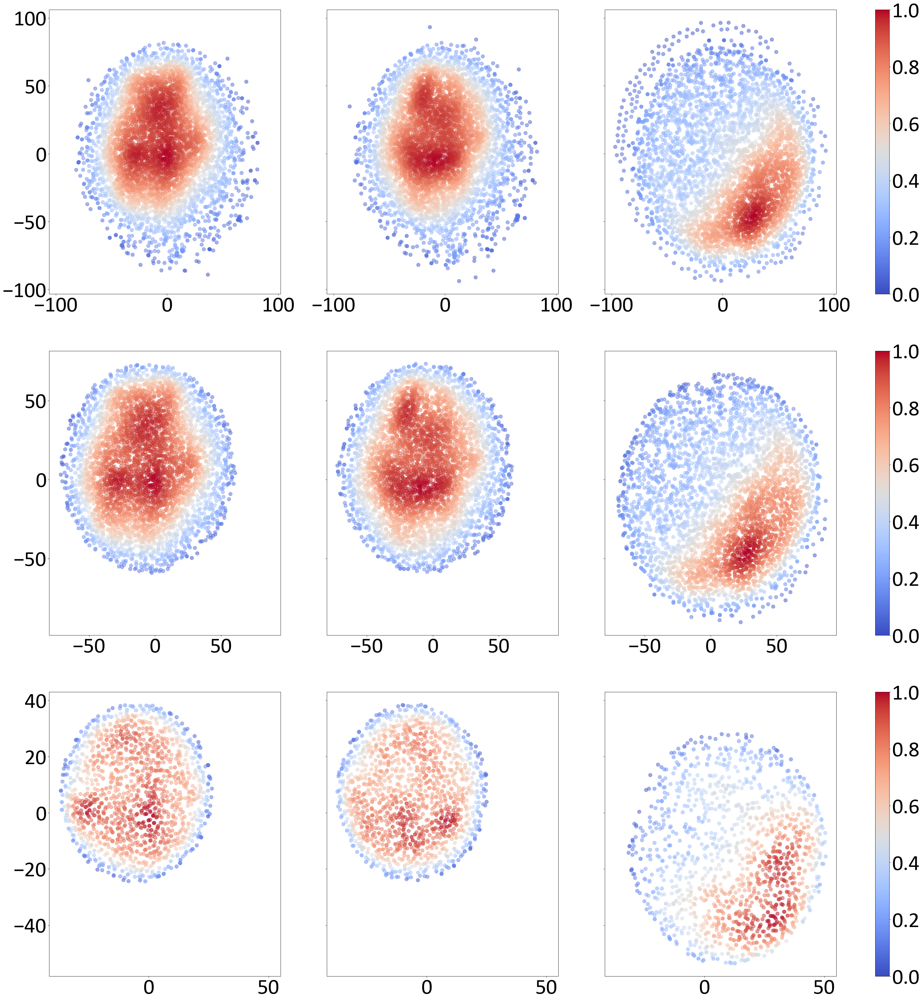

In [35]:
# Call the function
# plot_tsne_density(all_tsne, n_samples, output_file='output.png')
plot_tsne_density(all_tsne, n_samples, output_file='{}/model_evaluation/adobe_plots/tsne_distribution_validation.png'.format(folder_path), threshold0 = 0, threshold1=0.1, threshold2=0.7)

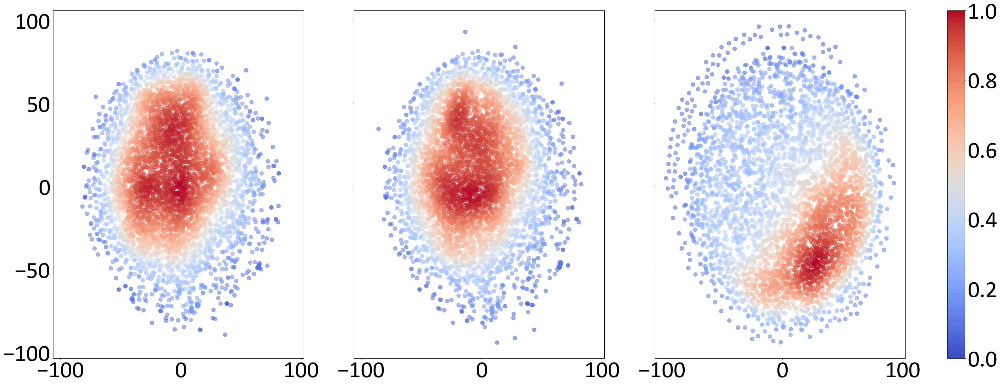

In [15]:
plot_tsne_density(all_tsne, n_samples, output_file='{}/model_evaluation/adobe_plots/tsne_distribution_validation_row2.png'.format(folder_path), threshold1=0)

#### tsne-test 10000

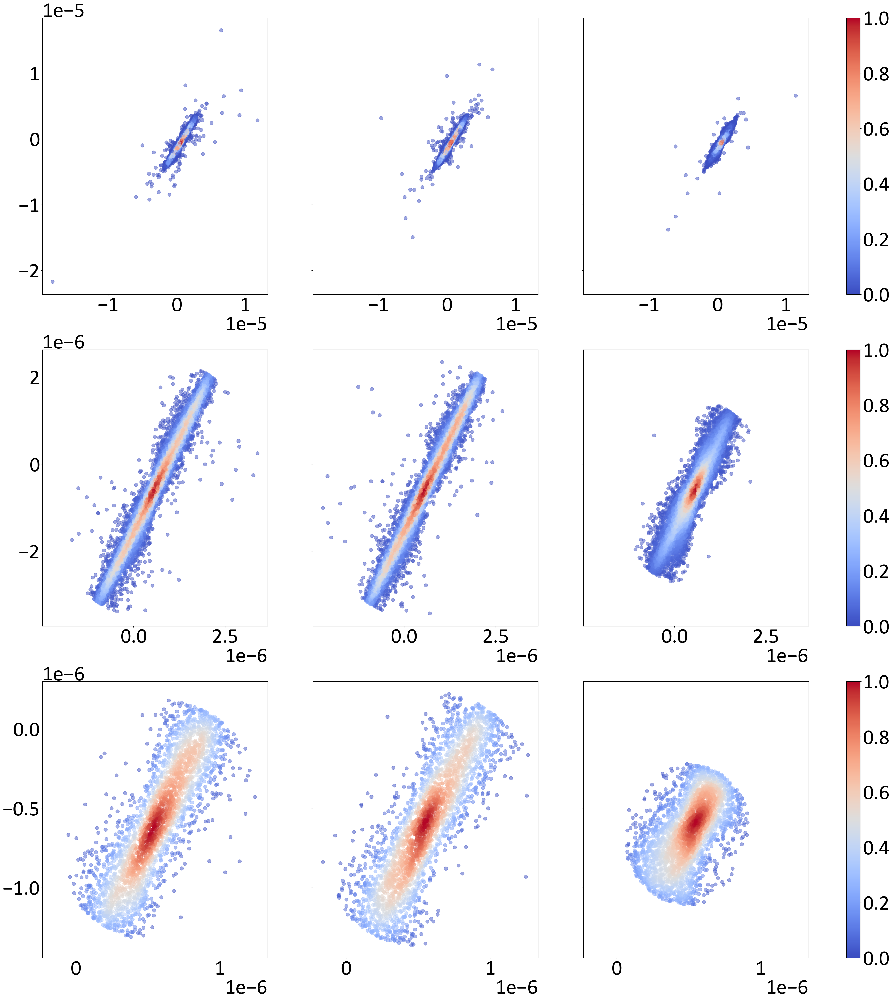

In [10]:
# Load the t-SNE results
all_tsne = np.load('{}/model_evaluation/tsne_matrix_test.npy'.format(folder_path), allow_pickle=True)
n_samples = 10000

# Call the function
# plot_tsne_density(all_tsne, n_samples, output_file='output.png')
plot_tsne_density(all_tsne, n_samples, output_file='{}/model_evaluation/adobe_plots/tsne_distribution_test.png'.format(folder_path), threshold0 = 0, threshold1=0.1, threshold2=0.7)

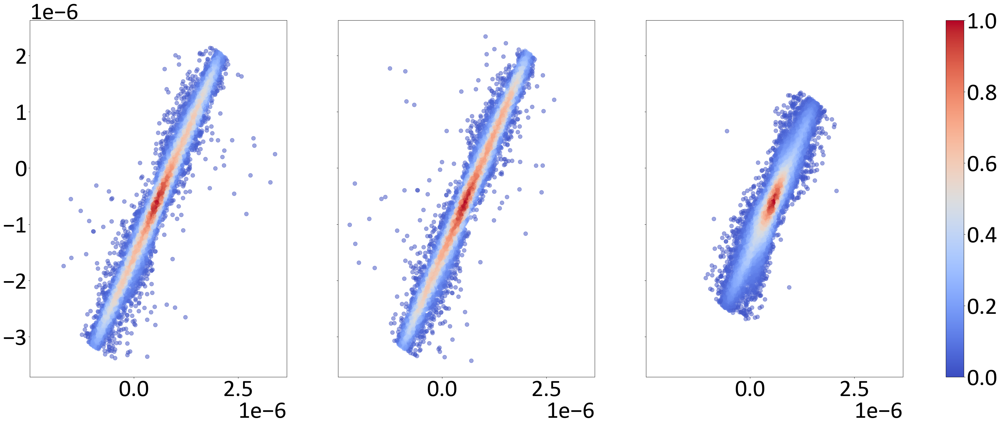

In [48]:
plot_tsne_density(all_tsne, n_samples, output_file='{}/model_evaluation/adobe_plots/tsne_distribution_test_row2.png'.format(folder_path), threshold1=0.1)

#### diversity/distant check

In [21]:
natural_peptide = peptide_eval[:, 1]
generated_peptide = peptide_samp[:, 1]

print(natural_peptide[:20])
print(generated_peptide[:20])

['TSEAYHAN' 'PILYVYGE' 'KKDWQLVY' 'LVRIKWFP' 'FSQVLSLN' 'IYEKKEYA'
 'VYEKKEYA' 'LLRGASVP' 'HSVKIKIM' 'GSLSLTSR' 'GNLSVTSR' 'HSIWVGLT'
 'EVVAFPTV' 'VQYTVNFG' 'RLPTQLLT' 'VEAHFFEL' 'SIKVNCNA' 'GVYCTYSG'
 'YAEELLLT' 'VAIVKWFF']
['DKYQVDLR' 'SAPETRAF' 'KVRLSKSV' 'FVRILQIT' 'FGQVASLN' 'IYEKKEYA'
 'VYQKMWLV' 'LTVQIVCI' 'RHITVKID' 'GMLSVTSR' 'SVLGVTSR' 'HAVWIGLT'
 'EVQAYPTV' 'VLVFVARA' 'LLPNVALT' 'PVIAAVVA' 'SIIVLCNA' 'LLDVRYVG'
 'LETLVLGF' 'YVVVDWTS']


In [22]:
def hamming_distance(s1, s2):
    """
    Calculate the Hamming distance between two strings of equal length.
    """
    if len(s1) != len(s2):
        raise ValueError("Strings must be of equal length.")
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))

distances = [hamming_distance(nat, gen) for nat, gen in zip(natural_peptide, generated_peptide)]
average_distance = sum(distances) / len(distances)

print(f"Average Hamming distance: {average_distance}")

Average Hamming distance: 4.596435219657483


#### explore generated data distribution

In [6]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib import ticker
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import precision_recall_curve, average_precision_score
from matplotlib.lines import Line2D

def plot_probability_density_sampled(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, peptide_samp_test_prob, filename=None):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    bins_log = np.linspace(np.log10(1e-22), np.log10(1), 100)
    bin_widths_log = (bins_log[1:] - bins_log[:-1])
    bins = 10 ** bins_log

    log_peptide_eval_prob = np.log10(peptide_eval_test_prob)
    log_peptide_eval_shuffled_prob = np.log10(peptide_eval_shuffled_test_prob)
    log_peptide_eval_random_prob = np.log10(peptide_eval_random_test_prob)
    log_peptide_samp_test_prob = np.log10(peptide_samp_test_prob)

    plt.bar(bins[:-1], np.histogram(log_peptide_samp_test_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_samp_test_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='#8B0000', label="Generated data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.7, color='#4169E1', label="Natural data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_shuffled_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_shuffled_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='#2ca02c', label="Shuffled data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_random_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_random_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='#ff7f0e', label="Random data")

    # Add the threshold
    # plt.axvline(x=1e-13, color='#e74c3c', linestyle='--')
    # plt.axvline(x=1e-11, color='#e74c3c', linestyle='--') # Add this line for the new threshold
 
    ax = plt.gca()
    ax.set_xscale("log")
    ax.set_xticks([1e-21, 1e-17, 1e-13, 1e-9, 1e-5, 1])
    ax.get_xaxis().set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'$10^{{{int(np.log10(x)):d}}}$' if x < 1 else '1'))
    # ax.set_xlabel('Evaluated probabilities')
    plt.ylim([0.0, 0.35])
    # Get the legend object
    legend = plt.legend(loc="best")
    # Set the frame edge color of the legend to black
    legend.get_frame().set_edgecolor('black')
    # plt.title('Probability density plot')
    # ax.tick_params(axis='x', labelsize=40)
    # plt.savefig(filename, bbox_inches='tight')
    plt.show()

peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)

peptide_eval_shuffled_prob = peptide_eval_shuffled[:, 2].astype(np.float64)

peptide_eval_random_prob = peptide_eval_random[:, 2].astype(np.float64)

# newly added
peptide_samp_prob = peptide_samp[:, 2].astype(np.float32)

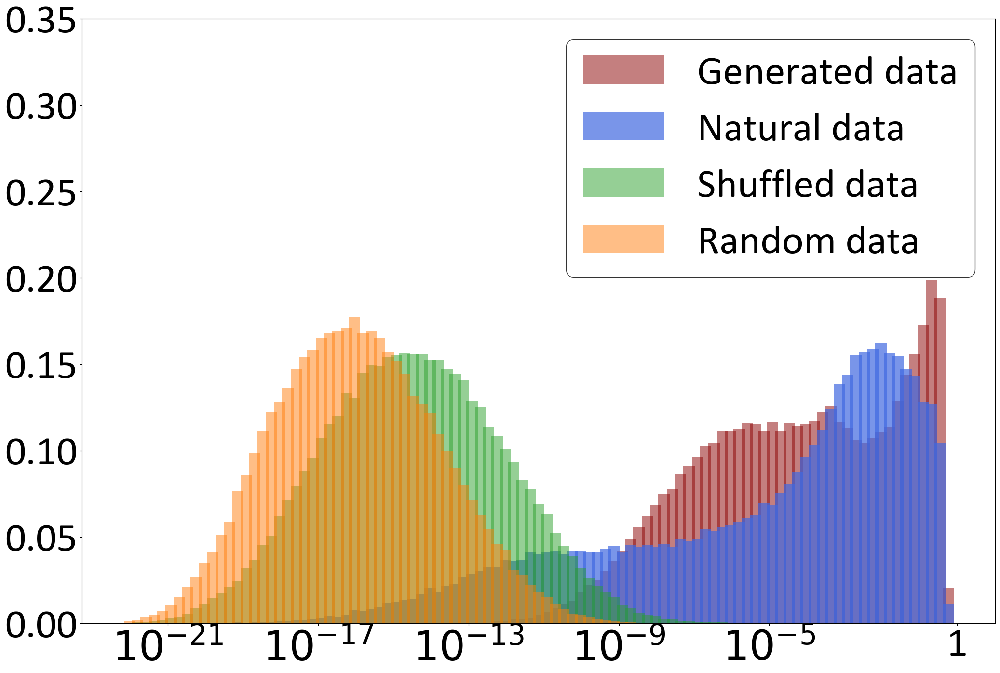

In [7]:
# validation data is used in the paper

# plot_probability_density_sampled(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, peptide_samp_test_prob, '{}/model_evaluation/adobe_plots/evaluated_density_plot_test.png'.format(folder_path))
plot_probability_density_sampled(peptide_eval_prob, peptide_eval_shuffled_prob, peptide_eval_random_prob, peptide_samp_prob)

#### similarity plot for datasets

In [18]:
import numpy as np
import matplotlib.pyplot as plt

def load_data(input_file):
    hamming_dict = np.load(input_file, allow_pickle=True)
    return hamming_dict.tolist()

def calculate_normalized_hamming(hamming_dict, sequence_length):
    normalized_hamming_score = {}
    for batch_num, data_dict in hamming_dict.items():
        for hamming_distance, num_data in data_dict.items():
            normalized_distance = hamming_distance / sequence_length
            if normalized_distance not in normalized_hamming_score:
                normalized_hamming_score[normalized_distance] = num_data
            else:
                normalized_hamming_score[normalized_distance] += num_data
    return normalized_hamming_score

def plot_normalized_hamming_distribution(normalized_hamming_score, output_file):
    x = []
    y = []
    for score, num_data in normalized_hamming_score.items():
        x.append(score)
        y.append(num_data)

    total_num_data = sum(y)
    y = [i / total_num_data for i in y]

    fig, main_ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))
    
    # Main plot
    main_ax.hist(x, weights=y, bins=25, color="#fddbb1", alpha=0.8, edgecolor='black', rwidth=0.7)
    main_ax.set_xlim([0.55, 1.0])
    main_ax.grid(axis='y', linestyle='--', linewidth=0.7, alpha=0.6)

    # Inset plot
    position = [0.20, 0.37, 0.4, 0.4]  # [left, bottom, width, height]
    inset_ax = fig.add_axes(position)
    inset_ax.hist(x, weights=y, bins=25, color="#fddbb1", alpha=0.8, edgecolor='black', rwidth=0.7)
    inset_ax.set_xlim([0.04, 0.55])
    # Adjust the y-axis range to focus on smaller values
    inset_max_y = max([y_val for x_val, y_val in zip(x, y) if x_val <= 0.5])
    inset_ax.set_ylim([0, inset_max_y * 1.2])  # Added some margin with the * 1.2 factor
    inset_ax.grid(axis='y', linestyle='--', linewidth=0.7, alpha=0.6)
    # Adjusting font size of the offset for the inset plot
    inset_ax.yaxis.get_offset_text().set_fontsize(50)
    inset_y = 1.09
    title = inset_ax.set_title('Norm. Hamming Distance < 0.6', fontsize=60, fontweight = 'bold', y=inset_y)
    title.set_position([0.52, inset_y])  # Adjust the 0.6 to move more or less to the right
    plt.savefig(output_file, bbox_inches='tight', dpi=300)
    plt.show()

def compute_proportion_above_threshold(normalized_hamming_score, threshold=0.8):
    # Calculate the count of data with normalized Hamming distances above the threshold
    above_threshold_data = sum(count for distance, count in normalized_hamming_score.items() if distance > threshold)
    
    # Calculate total number of data points
    total_data = sum(normalized_hamming_score.values())
    
    # Compute proportion
    proportion = above_threshold_data / total_data if total_data > 0 else 0
    
    return proportion

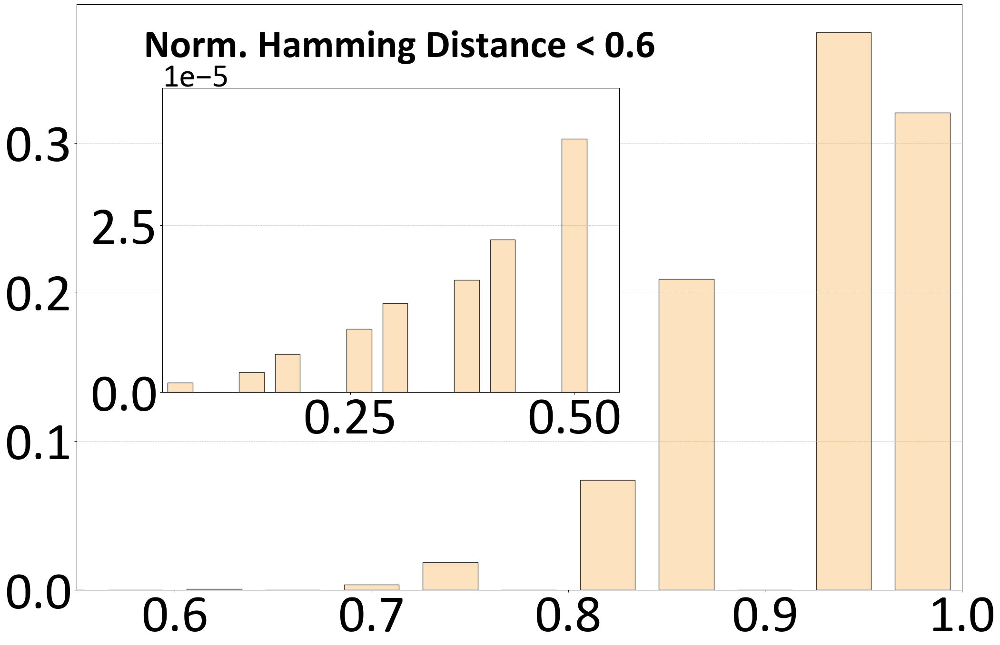

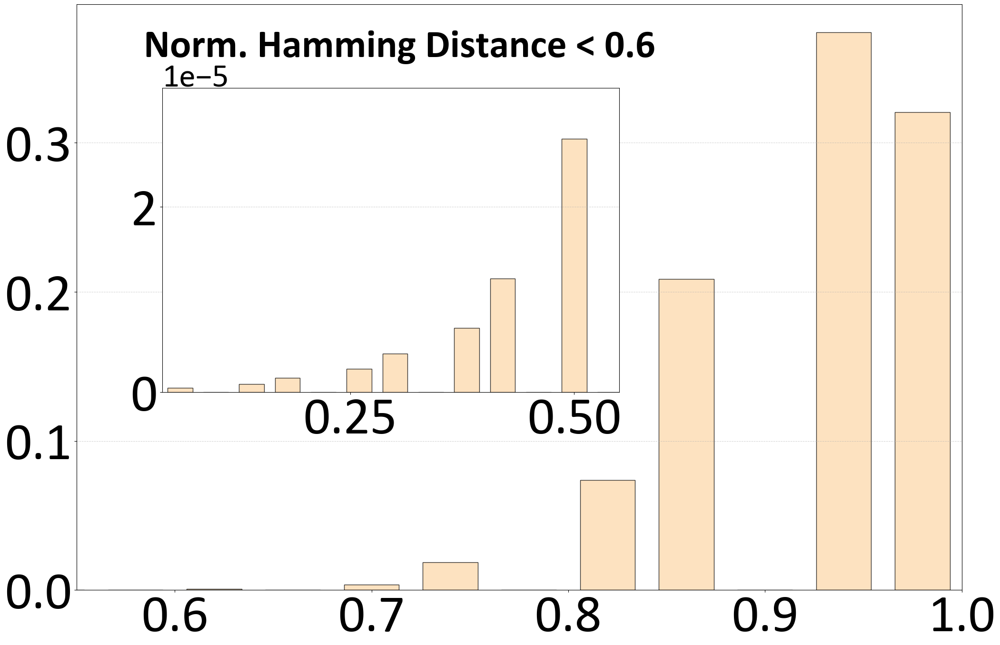

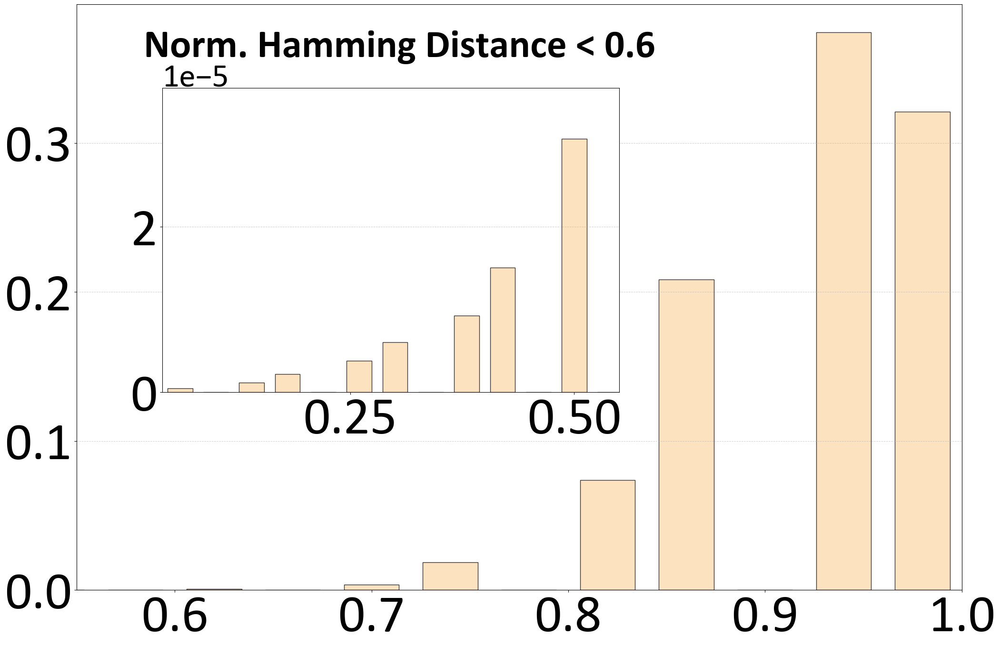

Proportion of training data with normalized Hamming distance over 0.8: 0.9770


In [23]:
sequence_length = 16

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Calibri',
    'lines.linewidth': 3,
})

# Validation data
validation_data = load_data('{}/validation_l8_anti/validation_only_hamming_distance_dict.npy'.format(dataset_path))
validation_normalized_hamming_score = calculate_normalized_hamming(validation_data, sequence_length)
plot_normalized_hamming_distribution(validation_normalized_hamming_score, '{}/model_evaluation/adobe_plots/pairwise_normalized_hamming_validation_only.png'.format(folder_path))

# Test data
test_data = load_data('{}/validation_l8_anti/test_only_hamming_distance_dict.npy'.format(dataset_path))
test_normalized_hamming_score = calculate_normalized_hamming(test_data, sequence_length)
plot_normalized_hamming_distribution(test_normalized_hamming_score, '{}/model_evaluation/adobe_plots/pairwise_normalized_hamming_test_only.png'.format(folder_path))

# Train data
train_data = load_data('{}/validation_l8_anti/train_only_hamming_distance_dict.npy'.format(dataset_path))
train_normalized_hamming_score = calculate_normalized_hamming(train_data, sequence_length)
plot_normalized_hamming_distribution(train_normalized_hamming_score, '{}/model_evaluation/adobe_plots/pairwise_normalized_hamming_train_only.png'.format(folder_path))

train_proportion = compute_proportion_above_threshold(train_normalized_hamming_score, 0.8)
print(f"Proportion of training data with normalized Hamming distance over 0.8: {train_proportion:.4f}")

#### Length 8 training dataset training count ve reverse count

In [8]:
# load training data
import numpy as np

train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

In [9]:
# Initialize variables to count the total number of data and reverse data
total_data_count = 0
reverse_data_count = 0

# Create a set to store unique target-comp pairs
target_comp_set = set()

# Populate the set with target-comp pairs from the training data
for row in train_array:
    target, comp, _ = row
    target_comp_set.add((target, comp))
    total_data_count += 1  # Increment the total data count

# Loop through the train_array to check for reverse data
for row in train_array:
    target, comp, _ = row
    
    # Check if the reverse pair exists in the set
    if (comp[::-1], target[::-1]) in target_comp_set:
        reverse_data_count += 1  # Increment the reverse data count

# Calculate the proportion of reverse data
if total_data_count > 0:
    proportion_reverse_data = reverse_data_count / total_data_count
else:
    proportion_reverse_data = 0

print("Total number of data points:", total_data_count)
print("Number of reverse data points:", reverse_data_count)
print("Proportion of reverse data:", proportion_reverse_data)

Total number of data points: 1933932
Number of reverse data points: 1066449
Proportion of reverse data: 0.5514407952296151


In [10]:
import os
import numpy as np
import matplotlib.pyplot as plt

# Initialize variables for reverse data counting and plotting
reverse_data_count = 0

# Initialize train_counts and reverse_counts with zeros
train_counts = [count for _, _, count in train_array]
reverse_counts = [0] * len(train_array)

# Create a dictionary for quick lookup from (comp[::-1], target[::-1]) to the index in train_array
train_dict_reverse_lookup = {(comp[::-1], target[::-1]): i for i, (target, comp, _) in enumerate(train_array)}

# Loop through the larger database to update reverse_counts
for type in ['antiparallel']:
    length_list = os.listdir("AF2_beta_strand_database/" + type)
    for length in length_list:
        length_name = length.split('_')[1]
        if length_name == '8':
            length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
            for subfolder in length_subfolders:
                data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True).tolist()
                for target, comps in data.items():
                    for comp, count in comps.items():
                        index = train_dict_reverse_lookup.get((target, comp))
                        if index is not None:
                            reverse_data_count += 1
                            reverse_counts[index] = count

# Calculate and print the proportion of reverse data
proportion_reverse_data = reverse_data_count / len(train_array)
print("Proportion of reverse data:", proportion_reverse_data)
train_counts = np.array(train_counts).astype(int)
reverse_counts = np.array(reverse_counts).astype(int)

# Sort train_counts and reverse_counts based on train_counts
sorted_indices = np.argsort(train_counts)
sorted_train_counts = np.array(train_counts)[sorted_indices]
sorted_reverse_counts = np.array(reverse_counts)[sorted_indices]

Proportion of reverse data: 0.6684216404713299


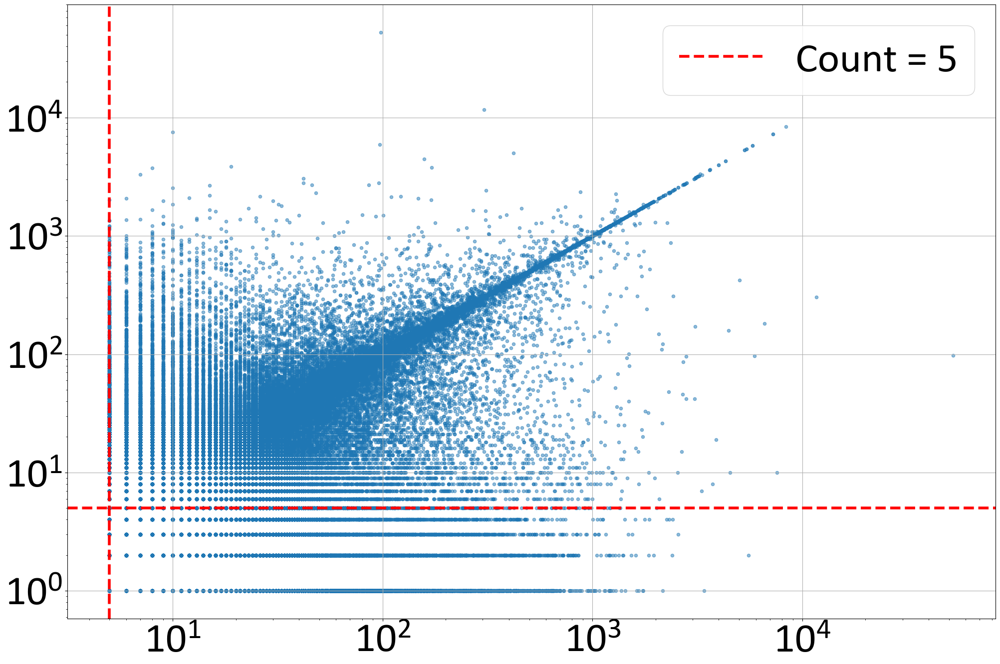

In [18]:
plt.rcParams.update({
	'font.size': 60,
	'font.family': 'Calibri',
	'lines.linewidth': 8,
})

# Plot the sorted scatterplot
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(sorted_train_counts, sorted_reverse_counts, alpha=0.5, s=20)
plt.xscale('log')
plt.yscale('log')

# Add red dashed vertical line at count 5
plt.axvline(x=5, color='red', linestyle='--', linewidth=4, label='Count = 5')

# Add red dashed horizontal line at count 5
plt.axhline(y=5, color='red', linestyle='--', linewidth=4)

#plt.xlabel('Training Data Count (log scale)')
#plt.ylabel('Reverse Count in AF2 Beta Database (log scale)')
#plt.title('Sorted Scatterplot of Count vs. Reverse Count (log-log scale)')
plt.legend()
plt.grid(True)
plt.savefig('{}/model_evaluation/adobe_plots/scatterplot_train_reverse_count.png'.format(folder_path), bbox_inches='tight', dpi=300)
plt.show()

#### model performance by roc-auc, pr-auc, probability

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from matplotlib.lines import Line2D

In [33]:
def load_closest_dist(filename):
    # for not overlapping dataset
    validation_training_hamming_dict = np.load(filename, allow_pickle=True)
    validation_training_hamming_dict = validation_training_hamming_dict.tolist()

    closest_dist = []
    for batch_num, data_dict in validation_training_hamming_dict.items():
        min_distance = 100
        for hamming_distance, num_data in data_dict.items():
            if hamming_distance < min_distance: 
            # if hamming_distance < min_distance and hamming_distance != 0:
                min_distance = hamming_distance
        closest_dist.append(min_distance)
    closest_dist = np.array(closest_dist)

    return closest_dist


def compute_auc_values(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    unique_counts = np.unique(count_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    auc_values_shuffled = []
    auc_values_random = []
    pr_auc_values_shuffled = []
    pr_auc_values_random = []

    for i in unique_counts:
        auc_values_shuffled.append(roc_auc[i])
        auc_values_random.append(roc_auc_random[i])
        pr_auc_values_shuffled.append(pr_auc[i])
        pr_auc_values_random.append(pr_auc_random[i])

    return unique_counts, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_dist(closest_dist_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range):
    min_dist = np.min(closest_dist_test)
    max_dist = np.max(closest_dist_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in range(min_dist, max_dist + 1):
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[closest_dist_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_shuffled_test_prob[closest_dist_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_random_test_prob[closest_dist_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_random_test_prob[closest_dist_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    # Combine the specified range, using weighted mean
    combined_start, combined_end = combined_range
    num_combined_start = len(peptide_eval_test_prob[closest_dist_test == combined_start])
    num_combined_end = len(peptide_eval_test_prob[closest_dist_test == combined_end])
    total_data = num_combined_start + num_combined_end

    roc_auc_combined = (roc_auc[combined_start] * num_combined_start + roc_auc[combined_end] * num_combined_end) / total_data
    roc_auc_random_combined = (roc_auc_random[combined_start] * num_combined_start + roc_auc_random[combined_end] * num_combined_end) / total_data
    pr_auc_combined = (pr_auc[combined_start] * num_combined_start + pr_auc[combined_end] * num_combined_end) / total_data
    pr_auc_random_combined = (pr_auc_random[combined_start] * num_combined_start + pr_auc_random[combined_end] * num_combined_end) / total_data

    distances = list(range(min_dist, max_dist - 1)) + [f"{combined_start}-{combined_end}"]
    auc_values_shuffled = [roc_auc[i] for i in range(min_dist, max_dist - 1)] + [roc_auc_combined]
    auc_values_random = [roc_auc_random[i] for i in range(min_dist, max_dist - 1)] + [roc_auc_random_combined]
    pr_auc_values_shuffled = [pr_auc[i] for i in range(min_dist, max_dist - 1)] + [pr_auc_combined]
    pr_auc_values_random = [pr_auc_random[i] for i in range(min_dist, max_dist - 1)] + [pr_auc_random_combined]

    return distances, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_property(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins):
    unique_counts = np.unique(count_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    # Group the counts into bins and calculate the weighted average for AUC
    # bins = [(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
    auc_values_shuffled_grouped = []
    auc_values_random_grouped = []
    pr_auc_values_shuffled_grouped = []
    pr_auc_values_random_grouped = []
    count_labels = []

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        unique_counts_in_range = unique_counts[(unique_counts >= low) & (unique_counts < high)]
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        roc_auc_combined = np.sum([roc_auc[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        roc_auc_random_combined = np.sum([roc_auc_random[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        pr_auc_combined = np.sum([pr_auc[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        pr_auc_random_combined = np.sum([pr_auc_random[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data

        auc_values_shuffled_grouped.append(roc_auc_combined)
        auc_values_random_grouped.append(roc_auc_random_combined)
        pr_auc_values_shuffled_grouped.append(pr_auc_combined)
        pr_auc_values_random_grouped.append(pr_auc_random_combined)
        if high-low == 1:
            count_labels.append(f"{low}")
        else:
            count_labels.append(f"{low}-{high}")
            
    return count_labels, auc_values_shuffled_grouped, auc_values_random_grouped, pr_auc_values_shuffled_grouped, pr_auc_values_random_grouped

def plot_combined_auc(properties, auc_values_shuffled, auc_values_random, filename, rotate=None, font_size=60):
    plt.rcParams.update({
        'font.size': font_size,
        'font.family': 'Calibri',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    plt.plot(properties, auc_values_shuffled, marker='o', label='Shuffled Data', color='green', markersize=35)
    plt.plot(properties, auc_values_random, marker='o', label='Random Data', color='orange', markersize=35)
    # plt.xlabel('Hamming Distance to Training Set')
    if rotate==True:
        plt.xticks(rotation=45)
    # plt.ylabel('Area Under the ROC Curve')
    # plt.title('Performance')
    # Create custom legend
    # legend_elements = [
    #    Line2D([0], [0], color='black', label='Test data vs:', linestyle='None', marker=None),
    #    Line2D([0], [0], color='green', label='Shuffled data', marker='o', markersize=35),
    #    Line2D([0], [0], color='orange', label='Random data', marker='o', markersize=35),
    #]

    # Add custom legend
    #legend = plt.legend(handles=legend_elements, loc='best')
    #legend.get_lines()[0].set_linestyle('None')
    #legend.get_lines()[0].set_marker(None)
    #legend.get_texts()[0].set_weight('bold')
    plt.grid(True)
    plt.savefig(filename, bbox_inches='tight')
    plt.show()

def plot_legend_only(filename):
    # Create an empty figure with no axes
    fig = plt.figure(figsize=(6, 3), facecolor=(1, 1, 1))
    plt.axis('off')
    
    # Create custom legend elements
    legend_elements = [
        Line2D([0], [0], color='black', label='Test data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='green', label='Shuffled data', marker='o', markersize=35),
        Line2D([0], [0], color='orange', label='Random data', marker='o', markersize=35)
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc='center', fontsize='large')
    plt.tight_layout()

    # Save only the legend
    plt.savefig(filename, bbox_inches=legend.get_window_extent().transformed(fig.dpi_scale_trans.inverted()))
    plt.show()

In [29]:
# 1. Load concatenated closest_dist data 
closest_dist = load_closest_dist(filename='{}/validation_l8_anti/validation_training_hamming_distance_dict.npy'.format(dataset_path))
# Split the data
closest_dist_test = closest_dist[split_index:]
# 2. load test target data
target_test = load_closest_dist(filename="{}/validation_l8_anti/test_target_only_hamming_distance_dict.npy".format(dataset_path))
# 3 load test comp data
comp_test = load_closest_dist(filename="{}/validation_l8_anti/test_comp_only_hamming_distance_dict.npy".format(dataset_path))
# 4. load count test data
count_test = test_array[:, 2].astype(np.int64)
# 5. load target promiscuity test data
promiscuity_target_test = np.load("{}/validation_l8_anti/test_target_promiscuity_array.npy".format(dataset_path), allow_pickle=True)
# 5. load comp promiscuity test data
promiscuity_comp_test = np.load("{}/validation_l8_anti/test_binder_promiscuity_array.npy".format(dataset_path), allow_pickle=True)
# 6. load avg_distance target test data
avg_distance_target_test = np.load("{}/validation_l8_anti/test_target_avg_distance_array.npy".format(dataset_path), allow_pickle=True)
# 6. load avg_distance comp test data
avg_distance_comp_test = np.load("{}/validation_l8_anti/test_binder_avg_distance_array.npy".format(dataset_path), allow_pickle=True)

# Print test info
print("test_array shape: ", test_array.shape)
print("peptide_eval_test shape: ", peptide_eval_test.shape)
print("peptide_eval_shuffled_test shape: ", peptide_eval_shuffled_test.shape)
print("peptide_eval_random_test shape: ", peptide_eval_random_test.shape)
print("closest_dist_test shape: ", closest_dist_test.shape)
print("target_test shape: ", target_test.shape)
print("comp_test shape: ", comp_test.shape)
print("count_test shape: ", count_test.shape)
print("promiscuity_target_test shape: ", promiscuity_target_test.shape)
print("promiscuity_comp_test shape: ", promiscuity_comp_test.shape)
print("avg_distance_target_test shape: ", avg_distance_target_test.shape)
print("avg_distance_comp_test shape: ", avg_distance_comp_test.shape)

# Convert probabilities to float64
peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)
peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)
peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)

test_array shape:  (107441, 3)
peptide_eval_test shape:  (107441, 3)
peptide_eval_shuffled_test shape:  (107441, 3)
peptide_eval_random_test shape:  (107441, 3)
closest_dist_test shape:  (107441,)
target_test shape:  (107441,)
comp_test shape:  (107441,)
count_test shape:  (107441,)
promiscuity_target_test shape:  (107441,)
promiscuity_comp_test shape:  (107441,)
avg_distance_target_test shape:  (107441,)
avg_distance_comp_test shape:  (107441,)


In [31]:
# Compute AUC values for concatenated sequences
combined_range = (9, 10)
distances, auc_values_shuffled_distances, auc_values_random_distances, auc_values_shuffled_distances_pr, auc_values_random_distances_pr = compute_auc_values_dist(closest_dist_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for concatenated sequences computed")

# Compute AUC values for target
combined_range = (3, 4)
targets, auc_values_shuffled_targets, auc_values_random_targets, auc_values_shuffled_targets_pr, auc_values_random_targets_pr = compute_auc_values_dist(target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for target computed")

# Compute AUC values for complementary peptide
combined_range = (3, 4)
comps, auc_values_shuffled_comps, auc_values_random_comps, auc_values_shuffled_comps_pr, auc_values_random_comps_pr = compute_auc_values_dist(comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for complementary peptide computed")

# Compute AUC values for count
bins=[(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
counts, auc_values_shuffled_counts, auc_values_random_counts, auc_values_shuffled_counts_pr, auc_values_random_counts_pr = compute_auc_values_property(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for count computed")

# Compute AUC values for target promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
promiscuities_target, auc_values_shuffled_promiscuities_target, auc_values_random_promiscuities_target, auc_values_shuffled_promiscuities_target_pr, auc_values_random_promiscuities_target_pr = compute_auc_values_property(promiscuity_target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for target promiscuity computed")

# Compute AUC values for complementary peptide promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
promiscuities_comp, auc_values_shuffled_promiscuities_comp, auc_values_random_promiscuities_comp, auc_values_shuffled_promiscuities_comp_pr, auc_values_random_promiscuities_comp_pr = compute_auc_values_property(promiscuity_comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for complementary peptide promiscuity computed")

# Compute AUC values for target within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
avg_distances_target, auc_values_shuffled_avg_distances_target, auc_values_random_avg_distances_target, auc_values_shuffled_avg_distances_target_pr, auc_values_random_avg_distances_target_pr = compute_auc_values_property(avg_distance_target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for target within distances computed")

# Compute AUC values for complementary peptide within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
avg_distances_comp, auc_values_shuffled_avg_distances_comp, auc_values_random_avg_distances_comp, auc_values_shuffled_avg_distances_comp_pr, auc_values_random_avg_distances_comp_pr = compute_auc_values_property(avg_distance_comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for complementary peptide within distances computed")

AUC values for concatenated sequences computed
AUC values for target computed
AUC values for complementary peptide computed
AUC values for count computed
AUC values for target promiscuity computed
AUC values for complementary peptide promiscuity computed
AUC values for target within distances computed
AUC values for complementary peptide within distances computed


Plotting combined ROC-AUC vs concatenated Distance


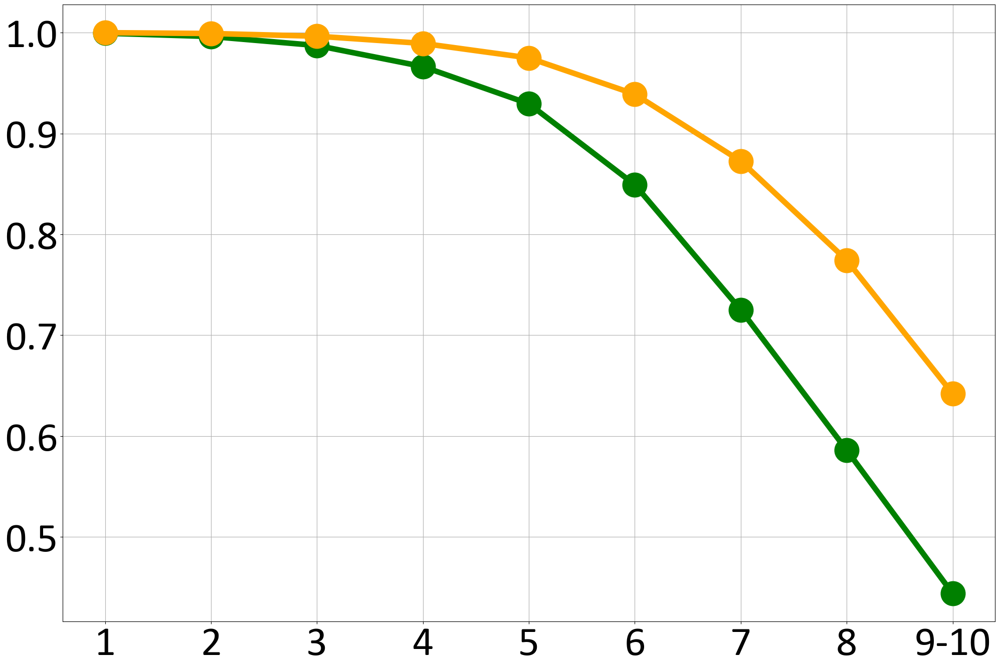

Plotting combined ROC-AUC vs Target Distance


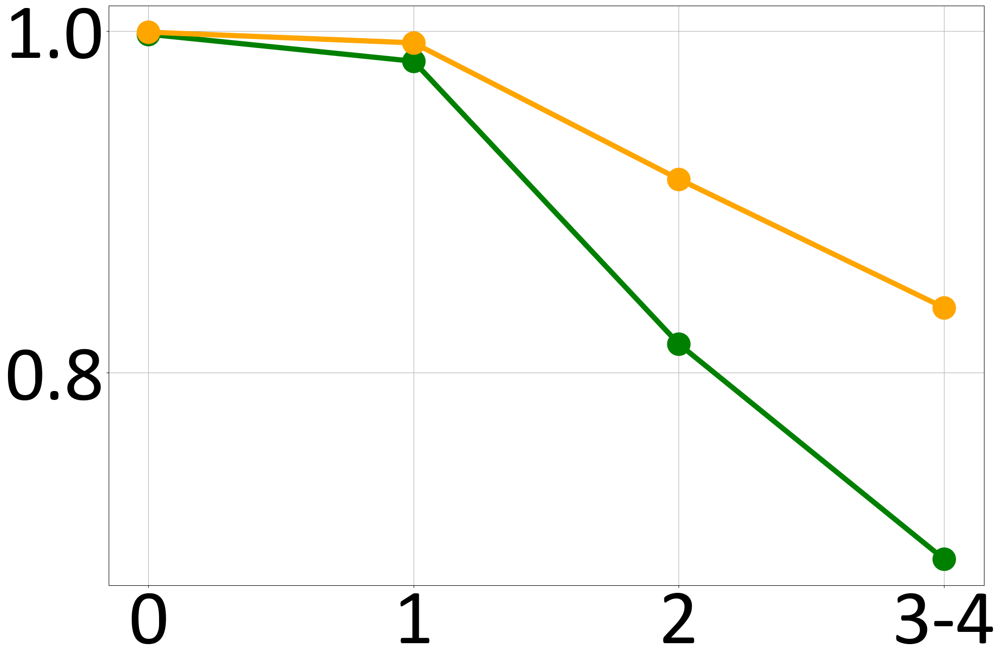

Plotting combined ROC-AUC vs Complementary Peptide Distance


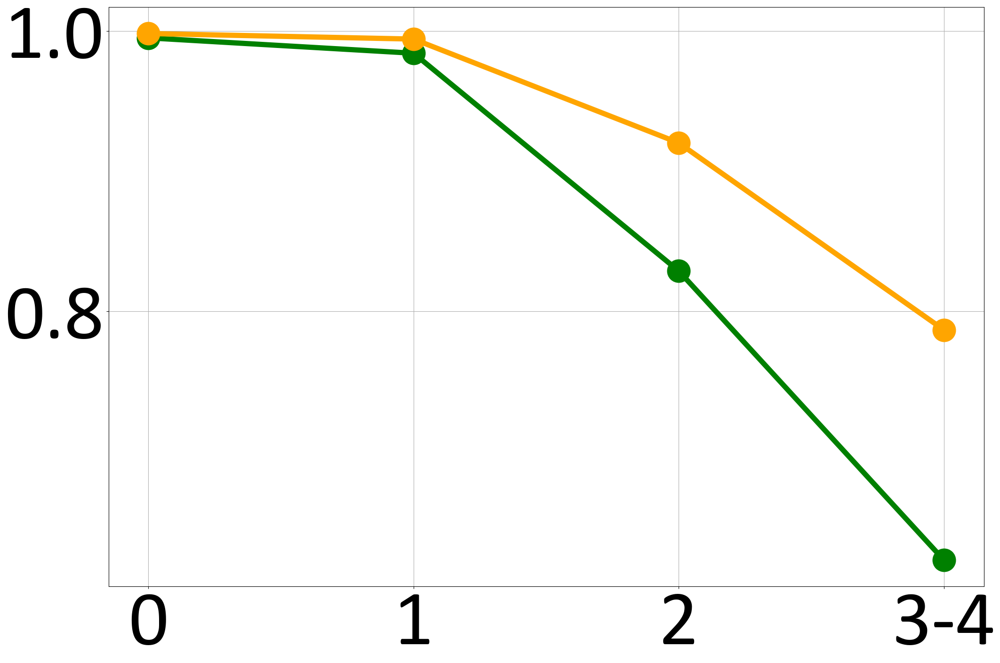

Plotting combined ROC-AUC vs Count


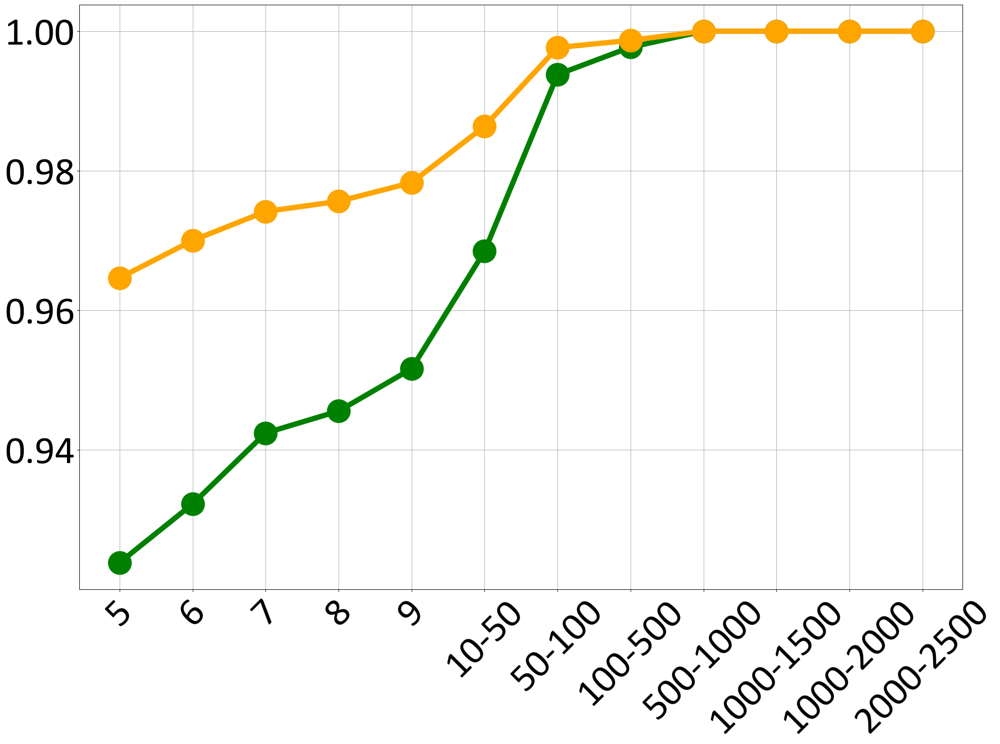

Plotting combined ROC-AUC vs target Promiscuity


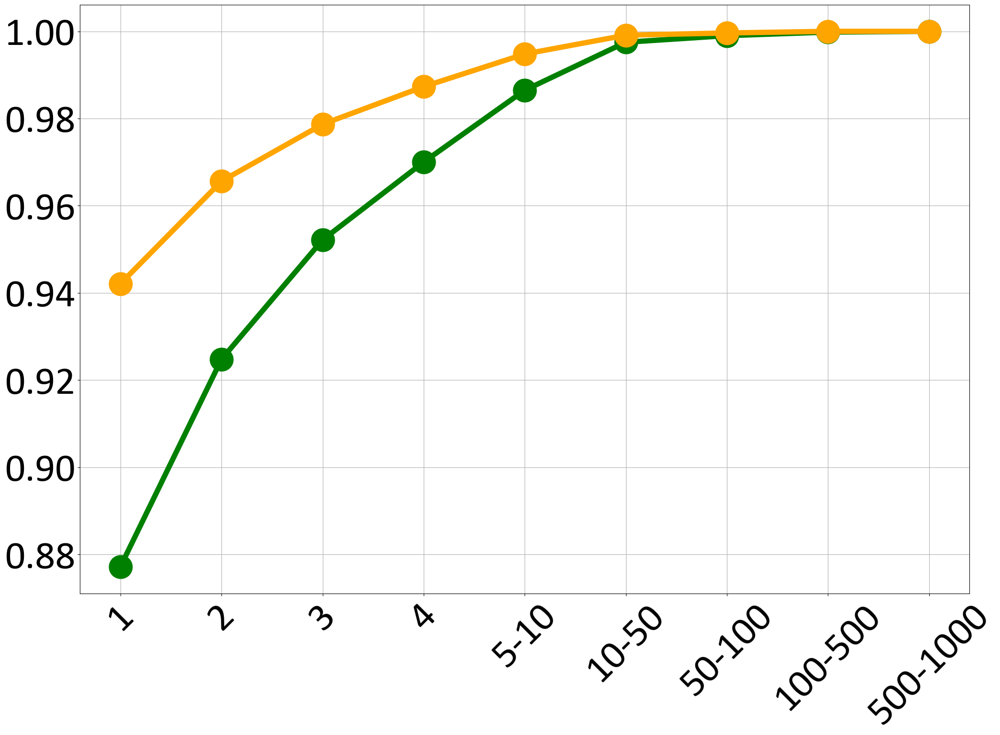

Plotting combined ROC-AUC vs complementary peptide Promiscuity


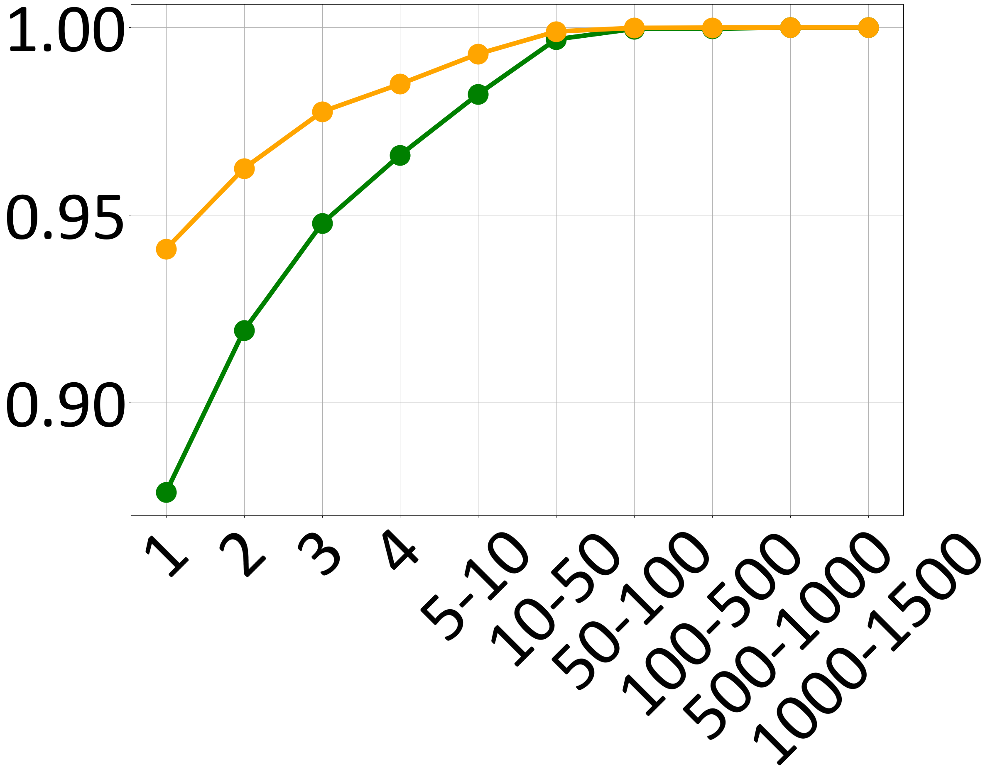

Plotting combined ROC-AUC vs Average Target Within Distance


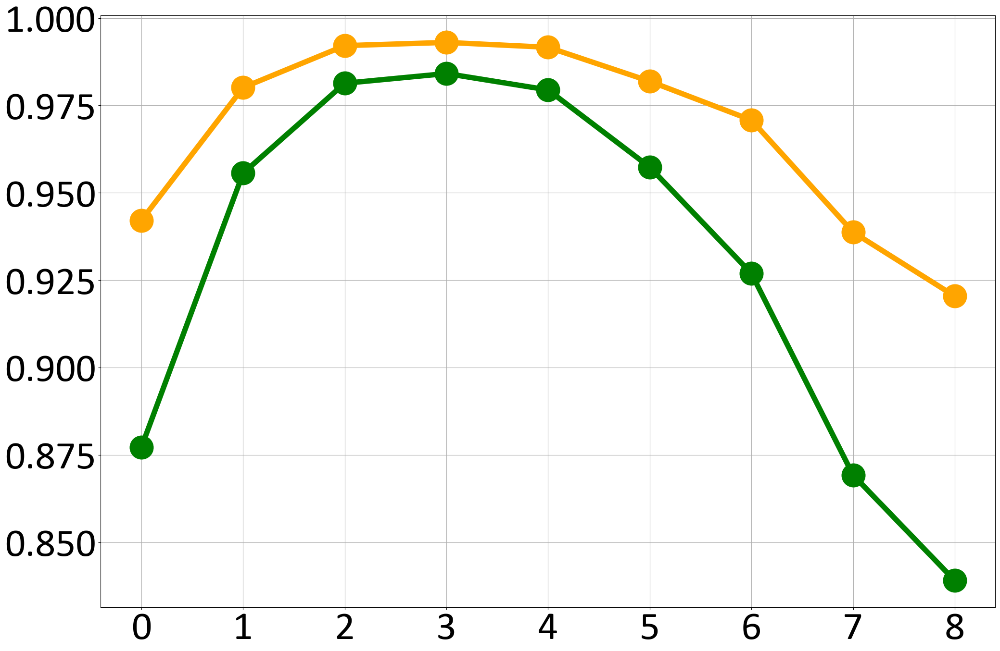

Plotting combined ROC-AUC vs Average Complementary Peptide Within Distance


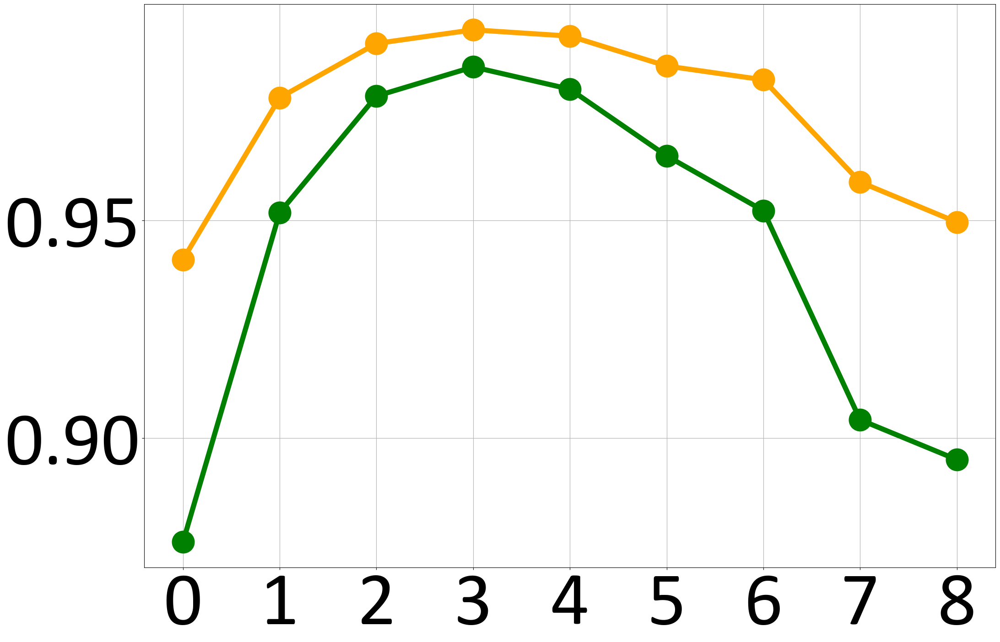

Plotting combined PR-AUC vs concatenated Distance


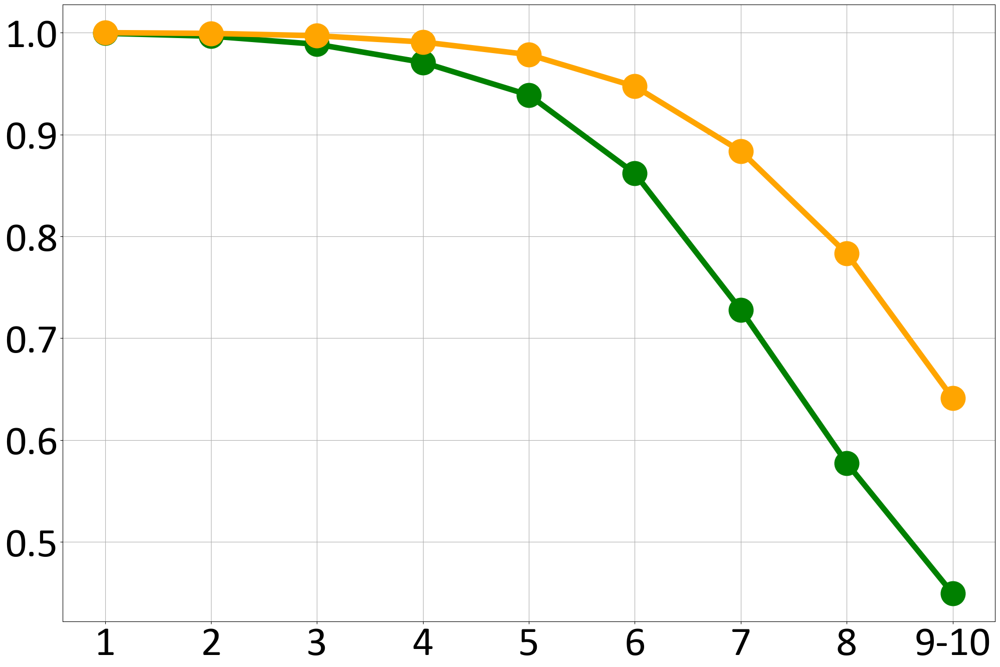

Plotting combined PR-AUC vs Target Distance


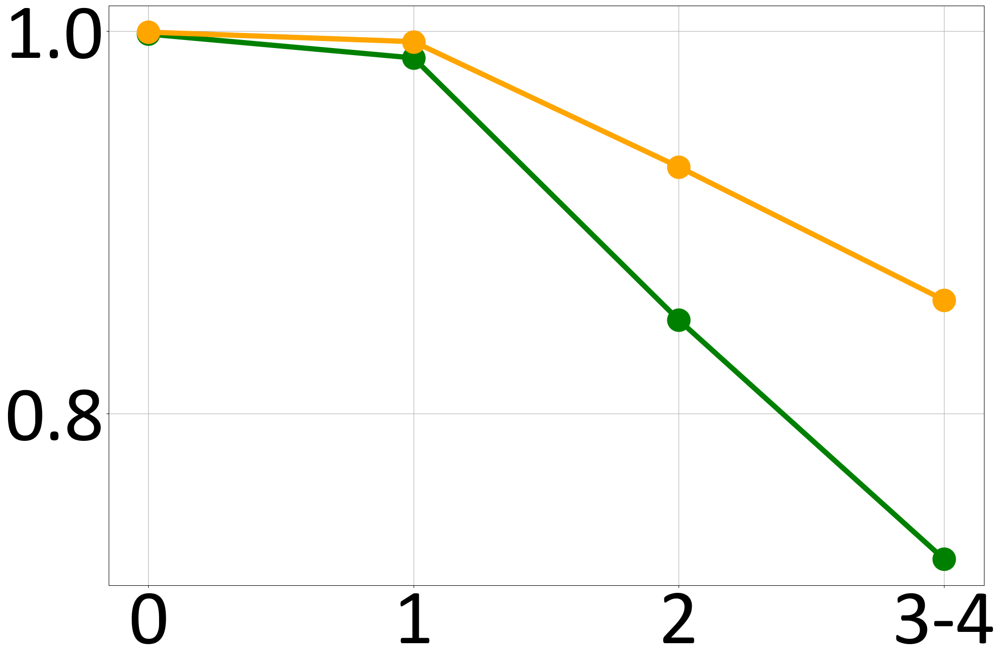

Plotting combined PR-AUC vs Complementary Peptide Distance


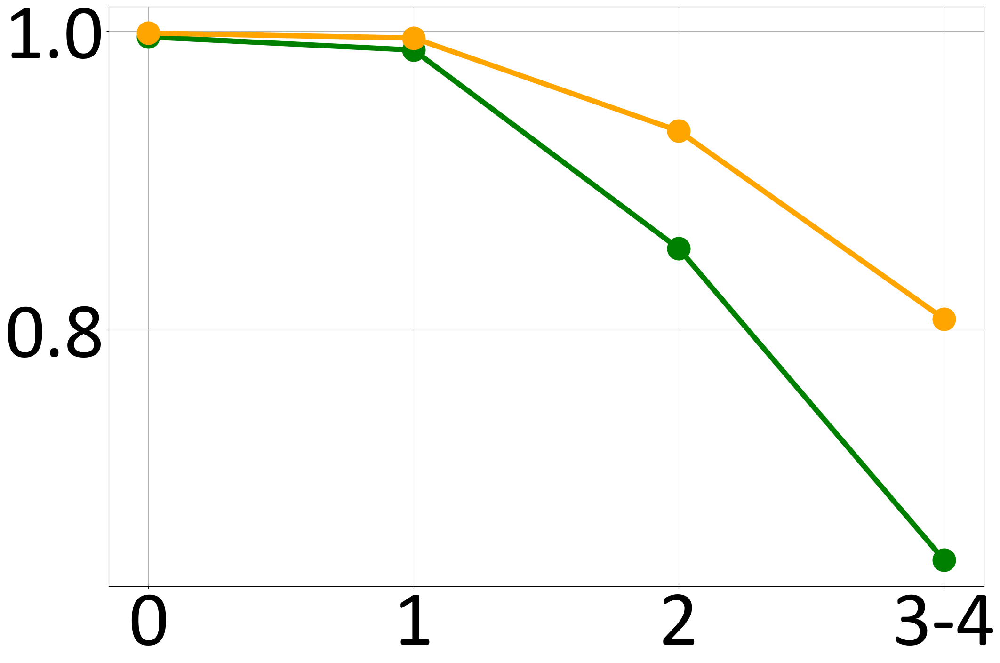

Plotting combined PR-AUC vs Count


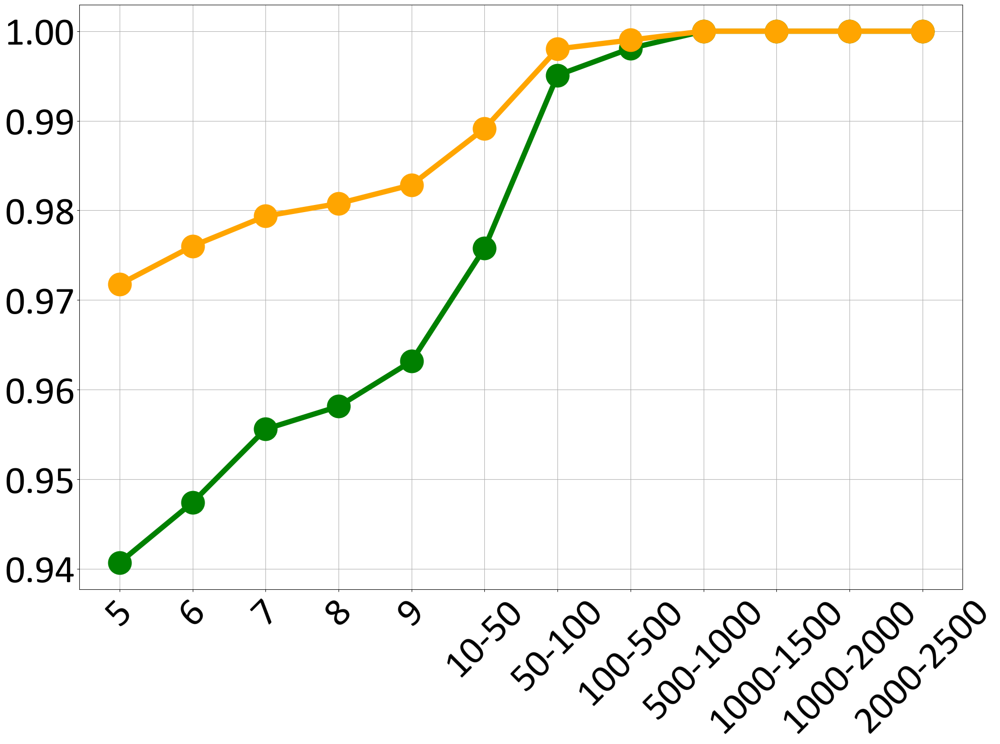

Plotting combined PR-AUC vs target Promiscuity


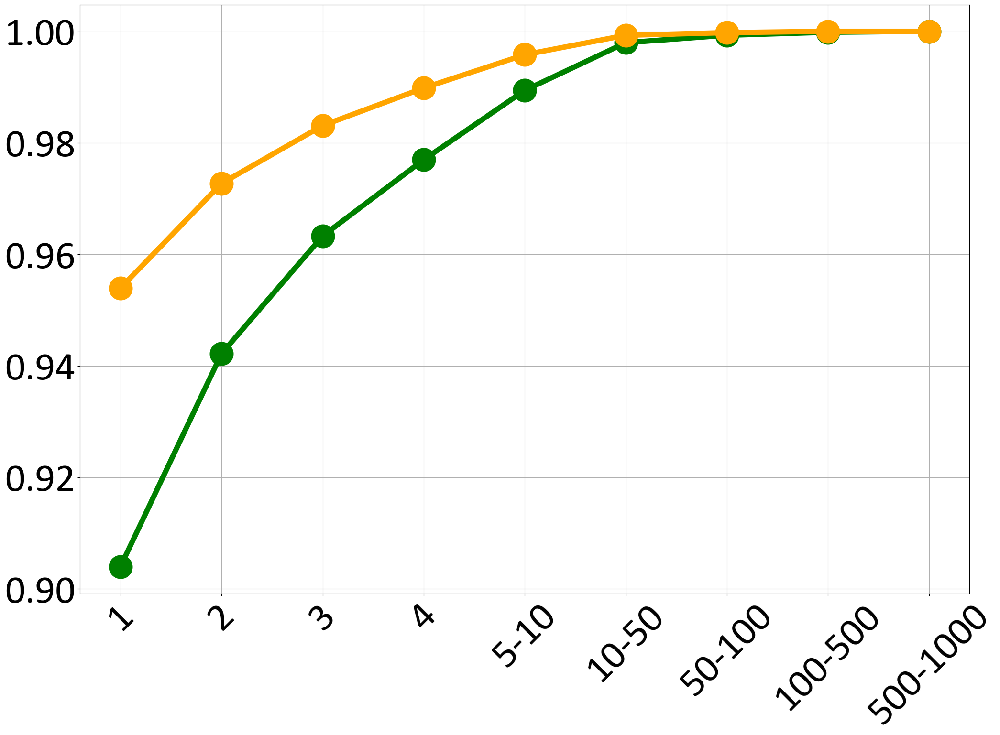

Plotting combined PR-AUC vs complementary peptide Promiscuity


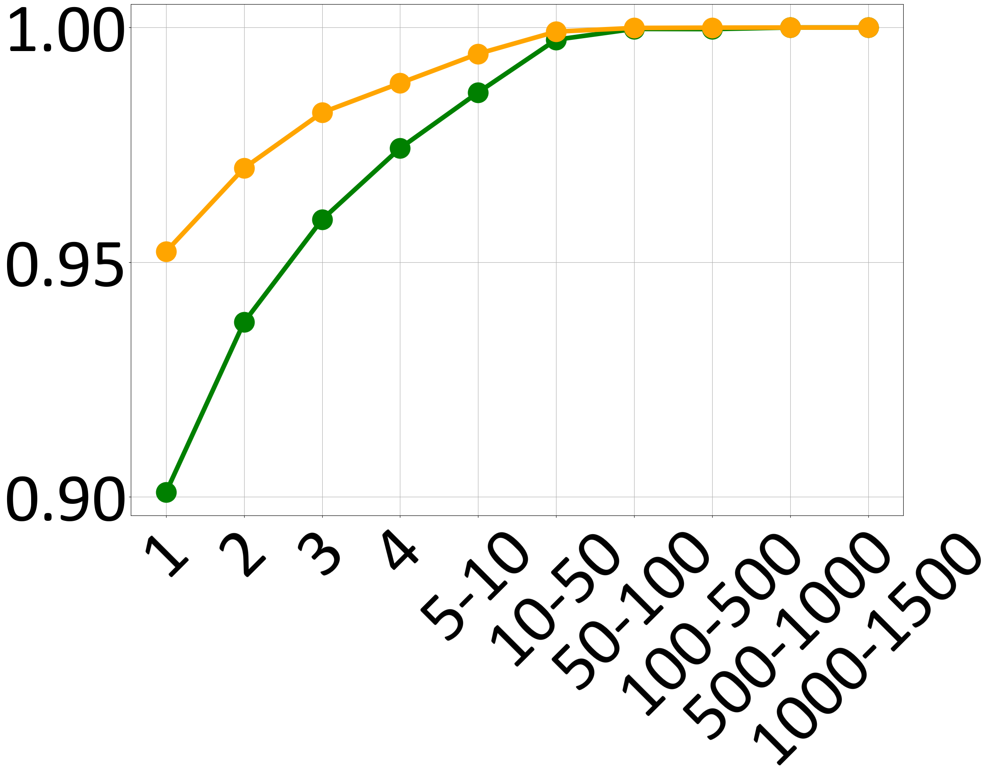

Plotting combined PR-AUC vs Average Target Within Distance


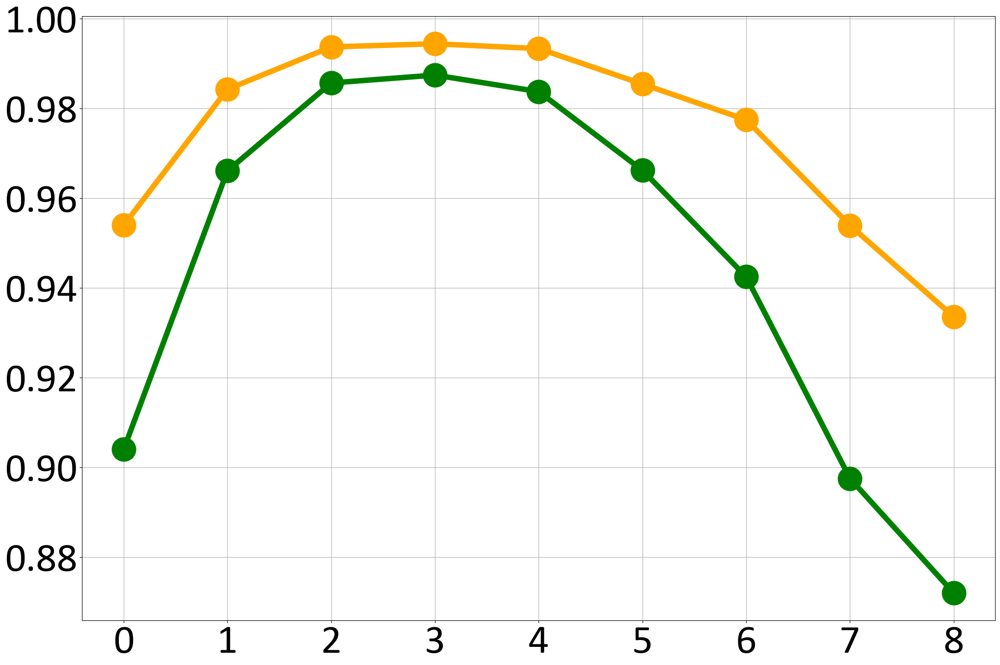

Plotting combined PR-AUC vs Average Complementary Peptide Within Distance


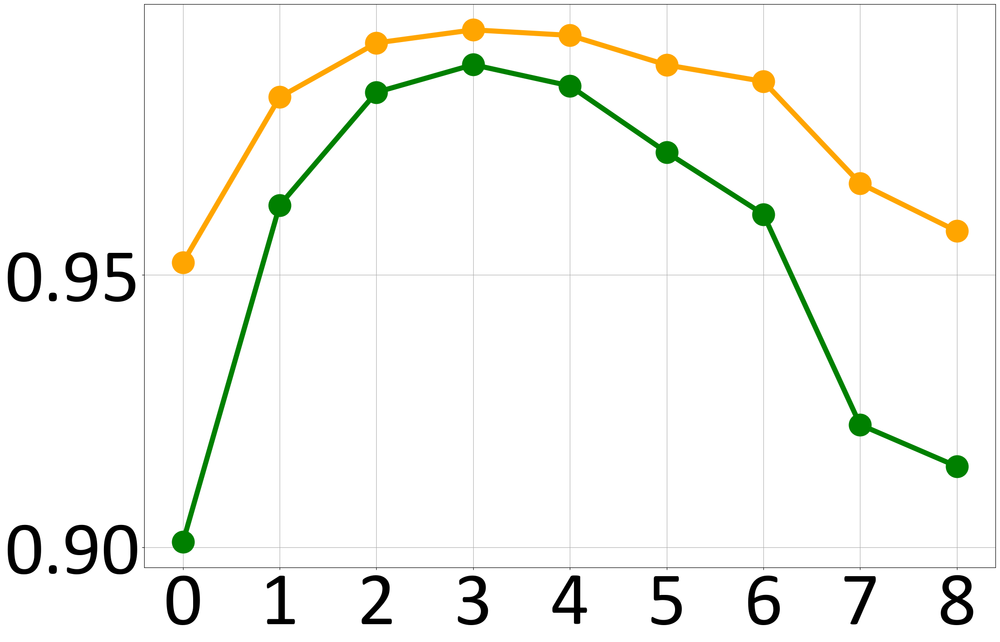

C:\Users\10331\AppData\Local\Temp\ipykernel_24144\359761336.py:203: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


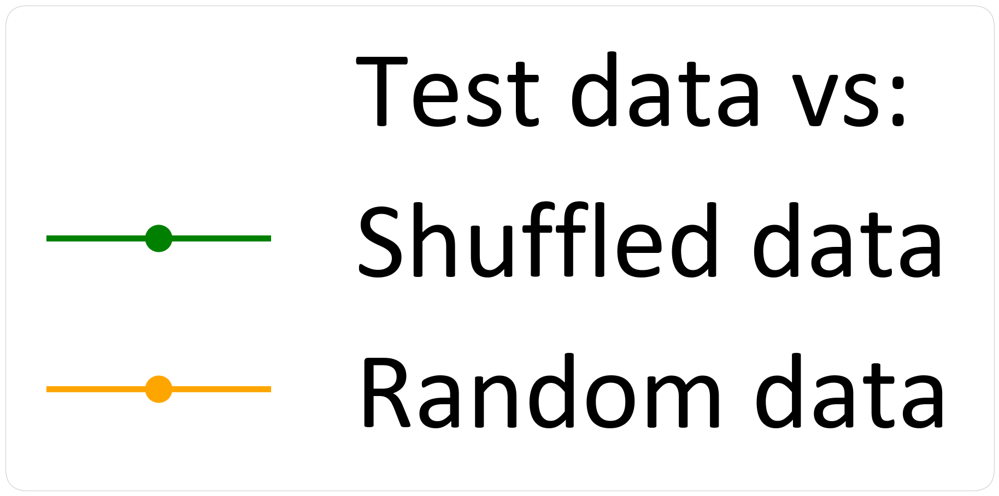

In [35]:
# 1. plot roc-auc 
# Plot combined AUC vs concatenated Distance
print("Plotting combined ROC-AUC vs concatenated Distance")
plot_combined_auc(distances, auc_values_shuffled_distances, auc_values_random_distances, "{}/model_evaluation/adobe_plots/AUC_vs_concat_distance_test.png".format(folder_path))

# Plot combined AUC vs Target
print("Plotting combined ROC-AUC vs Target Distance")
plot_combined_auc(targets, auc_values_shuffled_targets, auc_values_random_targets, "{}/model_evaluation/adobe_plots/AUC_vs_target_test.png".format(folder_path), font_size=120)

# Plot combined AUC vs Complementary Peptide
print("Plotting combined ROC-AUC vs Complementary Peptide Distance")
plot_combined_auc(comps, auc_values_shuffled_comps, auc_values_random_comps, "{}/model_evaluation/adobe_plots/AUC_vs_comp_test.png".format(folder_path), font_size=120)

# Plot combined AUC vs Count
print("Plotting combined ROC-AUC vs Count")
plot_combined_auc(counts, auc_values_shuffled_counts, auc_values_random_counts, "{}/model_evaluation/adobe_plots/AUC_vs_count_test.png".format(folder_path), rotate=True)

# Plot combined AUC vs target Promiscuity
print("Plotting combined ROC-AUC vs target Promiscuity")
plot_combined_auc(promiscuities_target, auc_values_shuffled_promiscuities_target, auc_values_random_promiscuities_target, "{}/model_evaluation/adobe_plots/AUC_vs_target_promiscuity_test.png".format(folder_path), rotate=True)

# Plot combined AUC vs complementary peptide Promiscuity
print("Plotting combined ROC-AUC vs complementary peptide Promiscuity")
plot_combined_auc(promiscuities_comp, auc_values_shuffled_promiscuities_comp, auc_values_random_promiscuities_comp, "{}/model_evaluation/adobe_plots/AUC_vs_comp_promiscuity_test.png".format(folder_path), rotate=True, font_size=120)

# Plot combined AUC vs Average Target Within Distance
print("Plotting combined ROC-AUC vs Average Target Within Distance")
plot_combined_auc(avg_distances_target, auc_values_shuffled_avg_distances_target, auc_values_random_avg_distances_target, "{}/model_evaluation/adobe_plots/AUC_vs_avg_target_within_distance_test.png".format(folder_path))

# Plot combined AUC vs Average Complementary Peptide Within Distance
print("Plotting combined ROC-AUC vs Average Complementary Peptide Within Distance")
plot_combined_auc(avg_distances_comp, auc_values_shuffled_avg_distances_comp, auc_values_random_avg_distances_comp, "{}/model_evaluation/adobe_plots/AUC_vs_avg_comp_within_distance_test.png".format(folder_path), font_size=120)


# 2. plot pr-auc
# Plot combined AUC vs concatenated Distance
print("Plotting combined PR-AUC vs concatenated Distance")
plot_combined_auc(distances, auc_values_shuffled_distances_pr, auc_values_random_distances_pr, "{}/model_evaluation/adobe_plots/AUC__vs_concat_distance_test_pr.png".format(folder_path))

# Plot combined AUC vs Target
print("Plotting combined PR-AUC vs Target Distance")
plot_combined_auc(targets, auc_values_shuffled_targets_pr, auc_values_random_targets_pr, "{}/model_evaluation/adobe_plots/AUC_vs_target_test_pr.png".format(folder_path), font_size=120)

# Plot combined AUC vs Complementary Peptide
print("Plotting combined PR-AUC vs Complementary Peptide Distance")
plot_combined_auc(comps, auc_values_shuffled_comps_pr, auc_values_random_comps_pr, "{}/model_evaluation/adobe_plots/AUC_vs_comp_test_pr.png".format(folder_path), font_size=120)

# Plot combined AUC vs Count
print("Plotting combined PR-AUC vs Count")
plot_combined_auc(counts, auc_values_shuffled_counts_pr, auc_values_random_counts_pr, "{}/model_evaluation/adobe_plots/AUC_vs_count_test_pr".format(folder_path), rotate=True)

# Plot combined AUC vs target Promiscuity
print("Plotting combined PR-AUC vs target Promiscuity")
plot_combined_auc(promiscuities_target, auc_values_shuffled_promiscuities_target_pr, auc_values_random_promiscuities_target_pr, "{}/model_evaluation/adobe_plots/AUC_vs_target_promiscuity_test_pr".format(folder_path), rotate=True)

# Plot combined AUC vs complementary peptide Promiscuity
print("Plotting combined PR-AUC vs complementary peptide Promiscuity")
plot_combined_auc(promiscuities_comp, auc_values_shuffled_promiscuities_comp_pr, auc_values_random_promiscuities_comp_pr, "{}/model_evaluation/adobe_plots/AUC_vs_comp_promiscuity_test_pr".format(folder_path), rotate=True, font_size=120)

# Plot combined AUC vs Average Target Within Distance
print("Plotting combined PR-AUC vs Average Target Within Distance")
plot_combined_auc(avg_distances_target, auc_values_shuffled_avg_distances_target_pr, auc_values_random_avg_distances_target_pr, "{}/model_evaluation/adobe_plots/AUC_vs_avg_target_within_distance_test_pr".format(folder_path))

# Plot combined AUC vs Average Complementary Peptide Within Distance
print("Plotting combined PR-AUC vs Average Complementary Peptide Within Distance")
plot_combined_auc(avg_distances_comp, auc_values_shuffled_avg_distances_comp_pr, auc_values_random_avg_distances_comp_pr, "{}/model_evaluation/adobe_plots/AUC_vs_avg_comp_within_distance_test_pr".format(folder_path), font_size=120)

# Plot legend only
plot_legend_only("{}/model_evaluation/adobe_plots/legend.png".format(folder_path))

In [23]:
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.legend import Legend
from matplotlib.patches import Patch

def compute_probabilities(count_test, peptide_eval_test_prob):
    unique_counts = np.unique(count_test)
    probabilities = dict()

    for i in unique_counts:
        probabilities[i] = peptide_eval_test_prob[count_test == i]

    return unique_counts, probabilities

def compute_probabilities_dist(closest_dist_test, peptide_eval_test_prob, combined_range):
    min_dist = np.min(closest_dist_test)
    max_dist = np.max(closest_dist_test)
    probabilities = dict()

    for i in range(min_dist, max_dist + 1):
        probabilities[i] = peptide_eval_test_prob[closest_dist_test == i]

    # Combine the specified range, using concatenation
    combined_start, combined_end = combined_range
    probabilities_combined = np.concatenate((peptide_eval_test_prob[closest_dist_test == combined_start], peptide_eval_test_prob[closest_dist_test == combined_end]))
    probabilities[f"{combined_start}-{combined_end}"] = probabilities_combined

    distances = list(range(min_dist, max_dist - 1)) + [f"{combined_start}-{combined_end}"]

    return distances, probabilities

def compute_probabilities_property(count_test, peptide_eval_test_prob, bins):
    unique_counts = np.unique(count_test)
    probabilities = dict()

    # Group the counts into bins
    count_labels = []
    probabilities_grouped = {}

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        unique_counts_in_range = unique_counts[(unique_counts >= low) & (unique_counts < high)]
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        probabilities_combined = np.concatenate([peptide_eval_test_prob[count_test == i] for i in unique_counts_in_range])
        if high - low == 1:
            count_label = f"{low}"
            count_labels.append(count_label)
            probabilities_grouped[count_label] = probabilities_combined
        else:
            count_label = f"{low}-{high}"
            count_labels.append(count_label)
            probabilities_grouped[count_label] = probabilities_combined

    return count_labels, probabilities_grouped


def plot_box_plot(unique_counts, probabilities, filename, peptide_eval_shuffled_test=None, peptide_eval_random_test=None, rotate=None):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    # Prepare the data for box plot
    box_plot_data = [probabilities[count] for count in unique_counts]
    # box_plot_data = [x for x in box_plot_data if len(x) > 0]

    # Add shuffled and random data if provided
    if peptide_eval_shuffled_test is not None and peptide_eval_random_test is not None:
        box_plot_data.extend([peptide_eval_shuffled_test, peptide_eval_random_test])
        unique_counts = list(unique_counts) + ['Shuffled', 'Random']

    # Create the box plot
    bp = plt.boxplot(box_plot_data, positions=range(len(unique_counts)), widths=0.6, showfliers=True, patch_artist=True)

    # Set box colors
    unique_count_colors = ['blue'] * len(unique_counts[:-2])
    colors = unique_count_colors + ['green', 'orange']
    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)

    # Set the median line style and color
    for median in bp['medians']:
        median.set(color='black', linewidth=3)

    # Set the x-axis labels
    plt.xticks(range(len(unique_counts)), unique_counts)
    if rotate==True:
        plt.xticks(rotation=45)
    # Customize the plot
    # plt.ylabel('Probability')
    
    # Set the y-axis to log10 scale
    plt.gca().set_yscale('log')

    plt.grid(True)

    # Custom legend for Test data, Shuffled and Random data
    #if peptide_eval_shuffled_test is not None and peptide_eval_random_test is not None:
        # Create custom legend patches
    #    test_patch = Patch(facecolor='blue', edgecolor='black', label='Test data')
    #    legend_elements = [
    #        test_patch,
    #        Patch(facecolor='green', edgecolor='black', label='Shuffled'),
    #        Patch(facecolor='orange', edgecolor='black', label='Random')
    #    ]

        # Create the custom legend
    #    legend = plt.legend(handles=legend_elements, loc='lower left', framealpha=0.1)
    #    plt.gca().add_artist(legend)

    # Save the plot
    plt.savefig(filename, bbox_inches='tight')

    # Show the plot
    plt.show()

def plot_legend_for_boxplot(filename):
    # Create an empty figure with no axes
    fig = plt.figure(figsize=(6, 3), facecolor=(1, 1, 1))
    plt.axis('off')
    
    # Create custom legend patches
    legend_elements = [
        Patch(facecolor='blue', edgecolor='black', label='Test data'),
        Patch(facecolor='green', edgecolor='black', label='Shuffled'),
        Patch(facecolor='orange', edgecolor='black', label='Random')
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc='center', fontsize='large')
    plt.tight_layout()

    # Save only the legend
    plt.savefig(filename, bbox_inches=legend.get_window_extent().transformed(fig.dpi_scale_trans.inverted()))
    plt.show()

Plotting box plot of probabilities vs concatenated distance


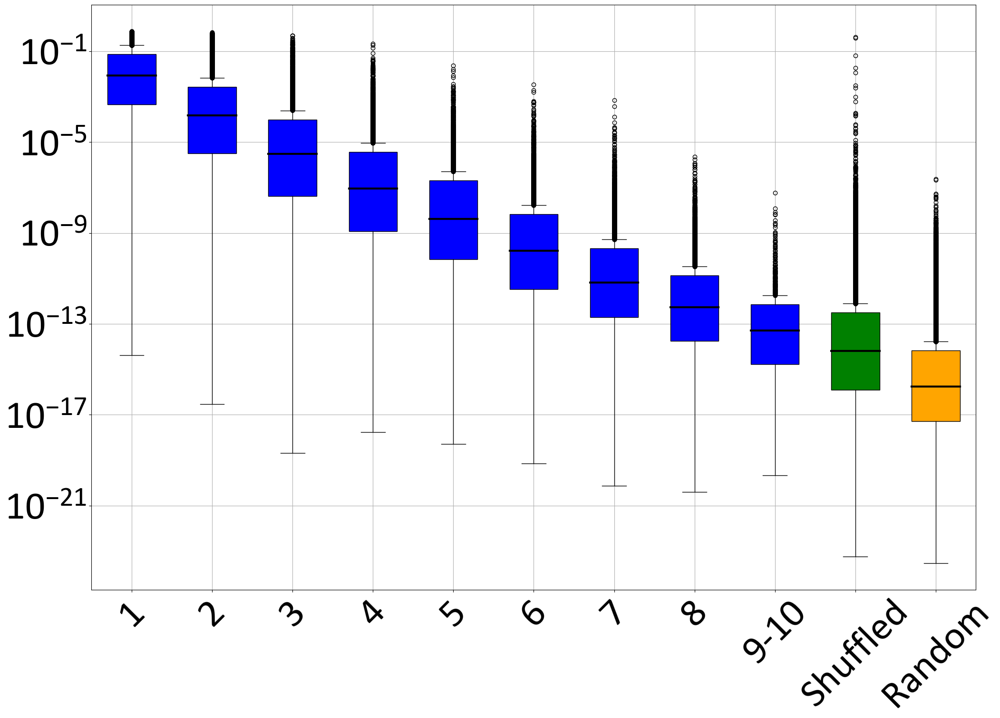

Plotting box plot of probabilities vs target distance


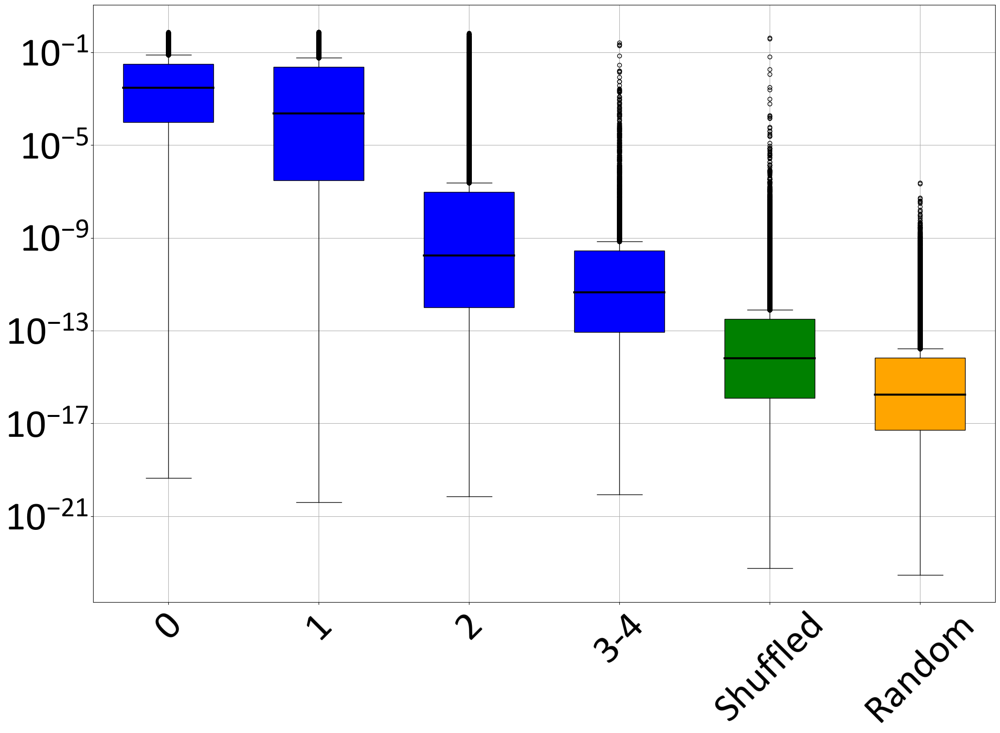

Plotting box plot of probabilities vs complementary peptide distance


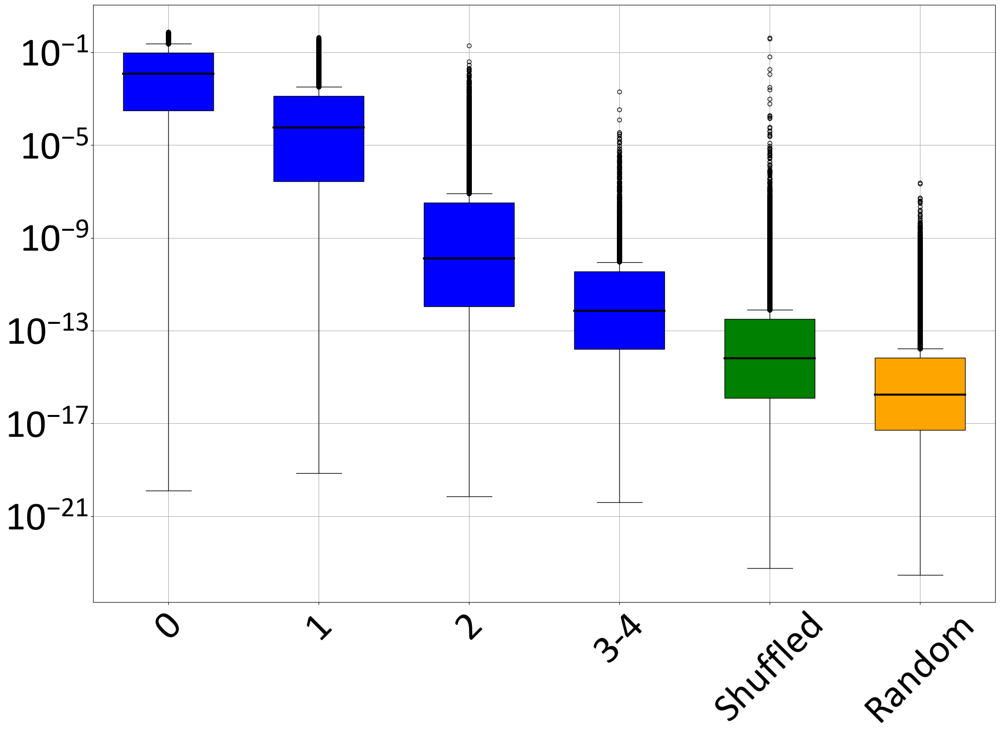

Plotting box plot of probabilities vs count


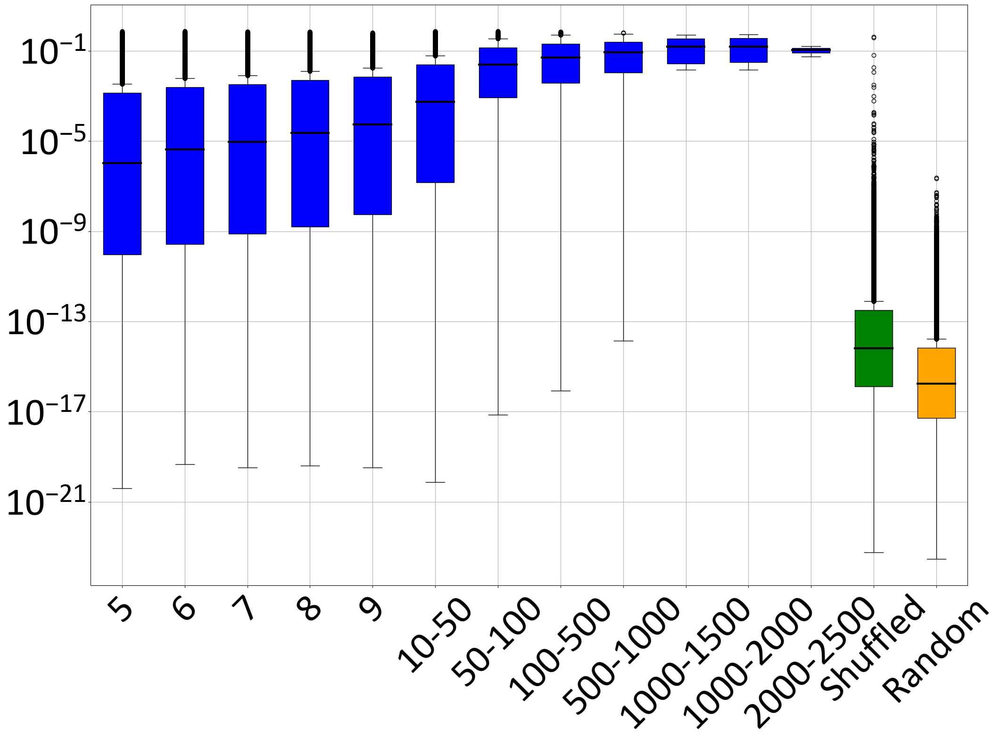

Plotting box plot of probabilities vs target promiscuity


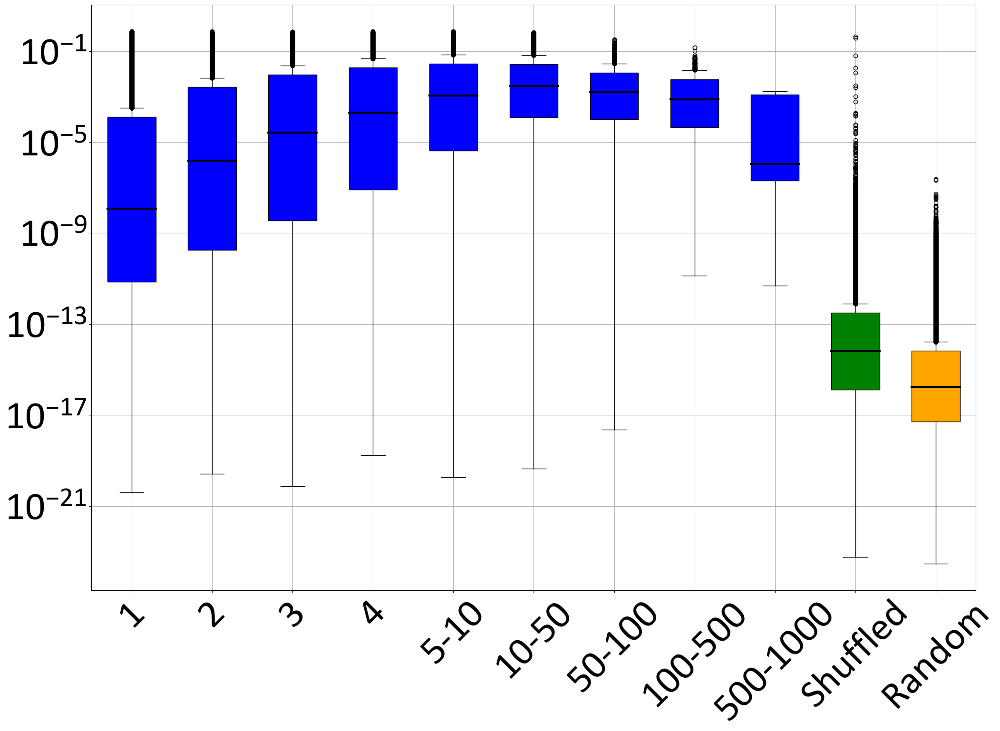

Plotting box plot of probabilities vs complementary peptide promiscuity


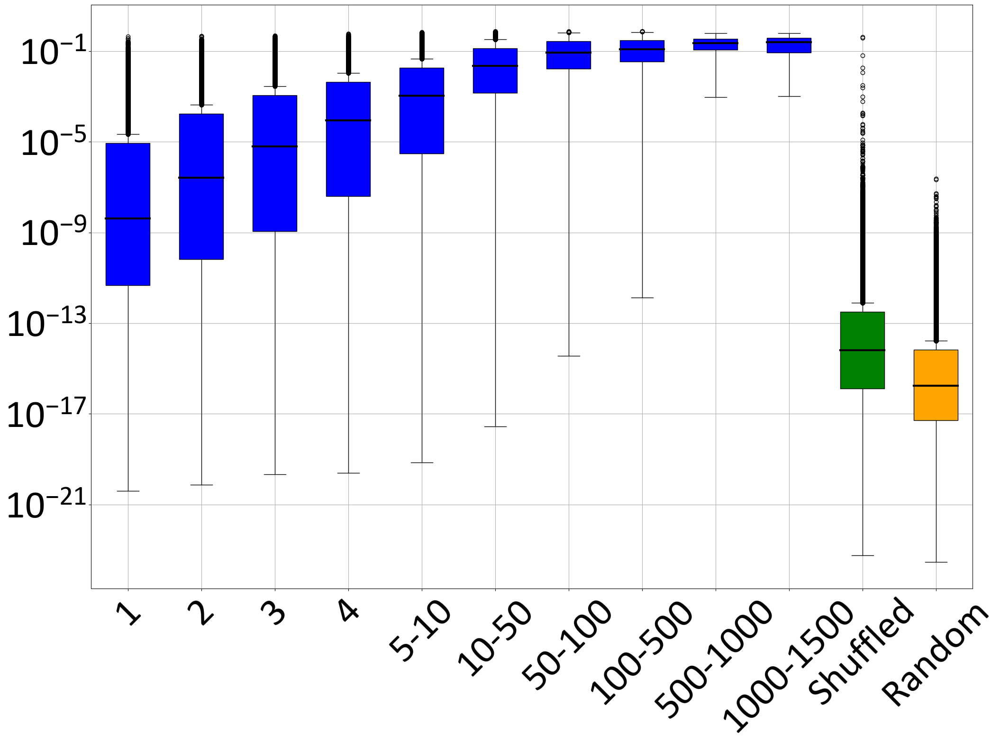

Plotting box plot of probabilities vs target within distances


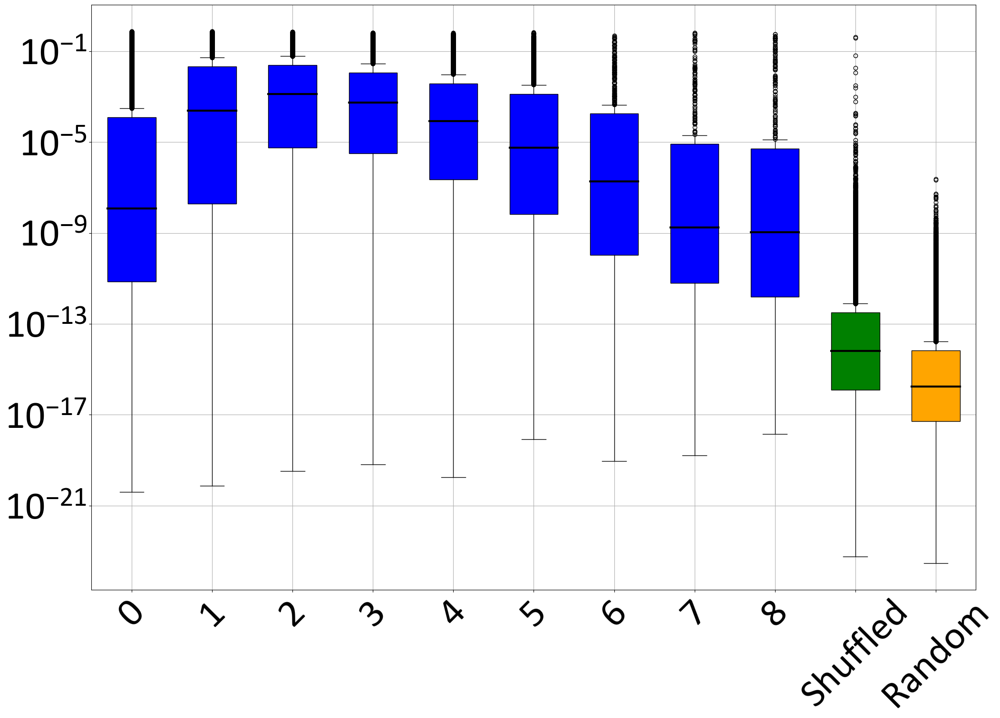

Plotting box plot of probabilities vs complementary peptide within distances


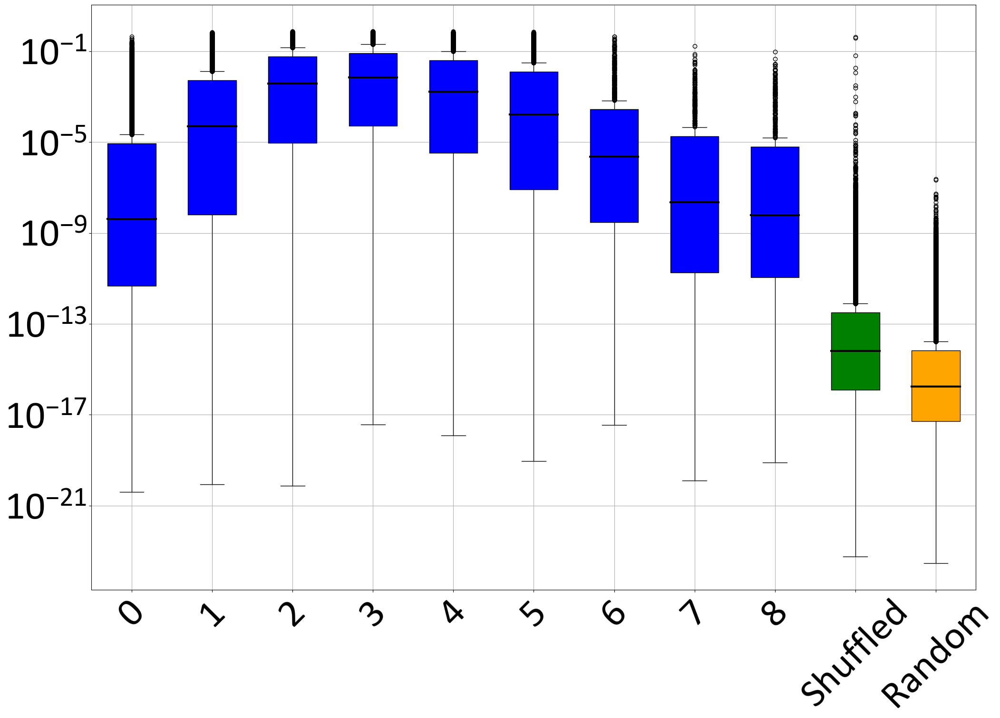

C:\Users\10331\AppData\Local\Temp\ipykernel_24144\3431514228.py:136: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


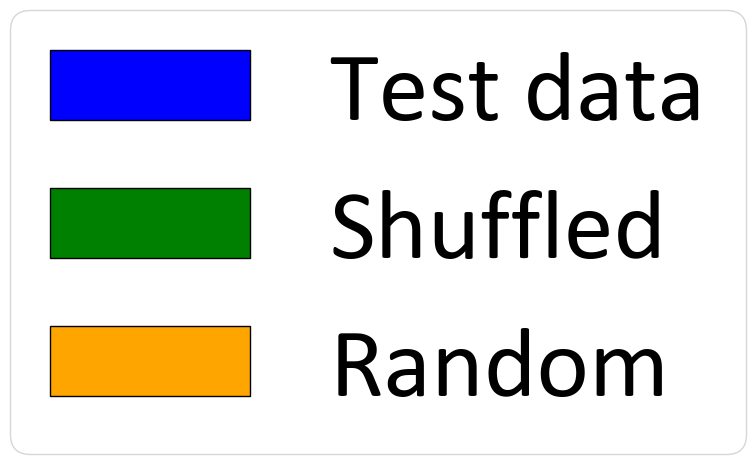

In [24]:
# plot box plot of probabilities vs concatenated distance
combined_range = (9, 10)
distances, probabilities_distances = compute_probabilities_dist(closest_dist_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs concatenated distance")
plot_box_plot(distances, probabilities_distances, '{}/model_evaluation/adobe_plots/probabilities_vs_closest_dist_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target distance
combined_range = (3, 4)
distances, probabilities_distances = compute_probabilities_dist(target_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs target distance")
plot_box_plot(distances, probabilities_distances, '{}/model_evaluation/adobe_plots/probabilities_vs_target_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide distance
combined_range = (3, 4)
distances, probabilities_distances = compute_probabilities_dist(comp_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs complementary peptide distance")
plot_box_plot(distances, probabilities_distances, '{}/model_evaluation/adobe_plots/probabilities_vs_comp_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs count 
bins=[(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
properties, probabilities_properties = compute_probabilities_property(count_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs count")
plot_box_plot(properties, probabilities_properties, '{}/model_evaluation/adobe_plots/probabilities_vs_count_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
properties, probabilities_properties = compute_probabilities_property(promiscuity_target_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs target promiscuity")
plot_box_plot(properties, probabilities_properties, '{}/model_evaluation/adobe_plots/probabilities_vs_target_promiscuity_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
properties, probabilities_properties = compute_probabilities_property(promiscuity_comp_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs complementary peptide promiscuity")
plot_box_plot(properties, probabilities_properties, '{}/model_evaluation/adobe_plots/probabilities_vs_comp_promiscuity_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
properties, probabilities_properties = compute_probabilities_property(avg_distance_target_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs target within distances")
plot_box_plot(properties, probabilities_properties, '{}/model_evaluation/adobe_plots/probabilities_vs_target_within_distances_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
properties, probabilities_properties = compute_probabilities_property(avg_distance_comp_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs complementary peptide within distances")
plot_box_plot(properties, probabilities_properties, '{}/model_evaluation/adobe_plots/probabilities_vs_comp_within_distances_test.png'.format(folder_path), peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# Plot legend only
plot_legend_for_boxplot("{}/model_evaluation/adobe_plots/probabilities_legend.png".format(folder_path))

In [41]:
import numpy as np
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from sklearn.metrics import precision_recall_curve

def compute_auc_values(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    unique_counts = np.unique(count_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    fpr_random = dict()
    tpr_random = dict()
    roc_auc_random = dict()

    pr = dict()
    recall = dict()
    pr_auc = dict()
    pr_random = dict()
    recall_random = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr[i], tpr[i], _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr[i], tpr[i])
        precision, recall[i], _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall[i], precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random[i], tpr_random[i], _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random[i], tpr_random[i])
        precision, recall_random[i], _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random[i], precision)
        
        # Print the number of data for each distance
        num_data = len(peptide_eval_test_prob[count_test == i])
        print(f"Number of data for distance {i}: {num_data}")

    auc_values_shuffled = []
    auc_values_random = []

    pr_auc_values_shuffled = []
    pr_auc_values_random = []

    for i in unique_counts:
        auc_values_shuffled.append(roc_auc[i])
        auc_values_random.append(roc_auc_random[i])

        pr_auc_values_shuffled.append(pr_auc[i])
        pr_auc_values_random.append(pr_auc_random[i])

    return unique_counts, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_combined(closest_dist_test, count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins):
    
    auc_values_shuffled = dict()
    auc_values_random = dict()
    
    pr_auc_values_shuffled = dict()
    pr_auc_values_random = dict()
    
    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        print(f"Number of data in bin group {low}-{high}: {num_data}")
        distances, auc_values_shuffled_group, auc_values_random_group, pr_auc_values_shuffled_group, pr_auc_values_random_group = compute_auc_values(closest_dist_test[count_mask], peptide_eval_test_prob[count_mask], peptide_eval_shuffled_test_prob[count_mask], peptide_eval_random_test_prob[count_mask])
        print(distances)
        group_label = f"{low}-{high}" if high - low > 1 else f"{low}"
        auc_values_shuffled[group_label] = dict(zip(distances, auc_values_shuffled_group))
        auc_values_random[group_label] = dict(zip(distances, auc_values_random_group))
        
        pr_auc_values_shuffled[group_label] = dict(zip(distances, pr_auc_values_shuffled_group))
        pr_auc_values_random[group_label] = dict(zip(distances, pr_auc_values_random_group))
        
    return bins, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def plot_auc_graphs(bins, auc_values_shuffled, auc_values_random, filename):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(48, 16), facecolor=(1, 1, 1))
    
    colors = ['blue', 'purple', 'red']
    
    # Shuffled Data
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in auc_values_shuffled:
            continue
        distances, auc_values = zip(*sorted(auc_values_shuffled[group_label].items()))
        ax1.plot(distances, auc_values, label=f'Count: {group_label}', marker='o', markersize=35, color=colors[idx])
    
    # Custom legend for Shuffled Data
    legend_elements_shuffled = [
        Line2D([0], [0], color='black', label='Test data vs\nShuffled data:', linestyle='None', marker=None),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_shuffled.append(Line2D([0], [0], color=colors[idx], label=f'Count: {group_label}', marker='o', markersize=35))
    ax1.legend(handles=legend_elements_shuffled, loc='lower left', fontsize=50)
    ax1.get_legend().get_texts()[0].set_weight('bold')
    ax1.grid(True)
    
    # Random Data
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in auc_values_random:
            continue
        distances, auc_values = zip(*sorted(auc_values_random[group_label].items()))
        ax2.plot(distances, auc_values, label=f'Count: {group_label}', marker='o', markersize=35, color=colors[idx])
    
    # Custom legend for Random Data
    legend_elements_random = [
        Line2D([0], [0], color='black', label='Test data vs\nRandom data:', linestyle='None', marker=None),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_random.append(Line2D([0], [0], color=colors[idx], label=f'Count: {group_label}', marker='o', markersize=35))
    ax2.legend(handles=legend_elements_random, loc='lower left', fontsize=50)
    ax2.get_legend().get_texts()[0].set_weight('bold')
    ax2.grid(True)

    plt.savefig(filename, bbox_inches='tight')
    plt.show()
    
def compute_probabilities(dist_test, peptide_eval_test_prob):
    unique_dist = np.unique(dist_test)
    probabilities = []

    for i in unique_dist:
        probabilities.append(peptide_eval_test_prob[dist_test == i])

    return unique_dist, probabilities

# now I want to create a function that return probabilities by count group then by distances as above
def compute_probabilities_by_count(closest_dist_test, count_test, peptide_eval_test_prob, bins):

    probabilities = dict()

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue
            
        print(f"Number of data in bin group {low}-{high}: {num_data}")
        distances, probabilities_group = compute_probabilities(closest_dist_test[count_mask], peptide_eval_test_prob[count_mask])
        print(distances)
        group_label = f"{low}-{high}" if high - low > 1 else f"{low}"
        probabilities[group_label] = dict(zip(distances, probabilities_group))

    return bins, probabilities

def plot_box_plot_by_count(bins, probabilities, filename):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })
    fig, ax = plt.subplots(figsize=(48, 16), facecolor=(1, 1, 1))

    colors = ['blue', 'purple', 'red']
    offset = [-0.2, 0, 0.2]  # Offset for each count group's box plot

    unique_distances = set()
    boxplot_dict = {}
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in probabilities:
            continue
        distances, probabilities_group = zip(*sorted(probabilities[group_label].items()))
        unique_distances.update(distances)
        positions = [d + offset[idx] for d in distances]
        boxplot_dict[group_label] = ax.boxplot(probabilities_group, positions=positions, widths=0.2, showfliers=True, patch_artist=True, boxprops=dict(facecolor=colors[idx]))

    # Set x-ticks and labels
    ax.set_xticks(sorted(list(unique_distances)))
    ax.set_xticklabels([f"{d:.0f}" for d in sorted(list(unique_distances))])

    # Set median line style and color
    for group_label, boxplot in boxplot_dict.items():
        for median in boxplot['medians']:
            median.set(color='black', linewidth=3)

    # Custom legend
    legend_elements_shuffled = [
        Patch(facecolor='none', edgecolor='none', label='Test data:',),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_shuffled.append(Patch(facecolor=colors[idx], edgecolor='black', label=f'Count: {group_label}'))

    ax.legend(handles=legend_elements_shuffled, loc='best', fontsize=50)
    ax.get_legend().get_texts()[0].set_weight('bold')

    # Set the y-axis to log10 scale
    plt.gca().set_yscale('log')

    ax.grid(True)

    plt.savefig(filename, bbox_inches='tight')
    plt.show()

Number of data in bin group 5-10: 67034
Number of data for distance 0: 19713
Number of data for distance 1: 23472
Number of data for distance 2: 20203
Number of data for distance 3: 3643
Number of data for distance 4: 3
[0 1 2 3 4]
Number of data in bin group 10-100: 38660
Number of data for distance 0: 17656
Number of data for distance 1: 13120
Number of data for distance 2: 6755
Number of data for distance 3: 1128
Number of data for distance 4: 1
[0 1 2 3 4]
Number of data in bin group 100-2500: 1747
Number of data for distance 0: 1344
Number of data for distance 1: 350
Number of data for distance 2: 43
Number of data for distance 3: 10
[0 1 2 3]


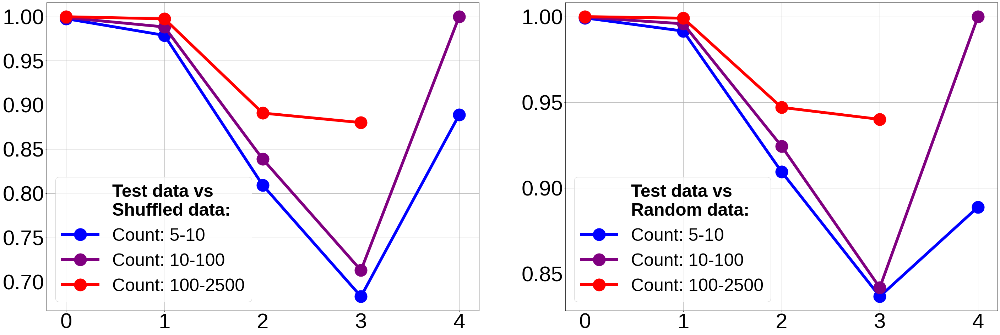

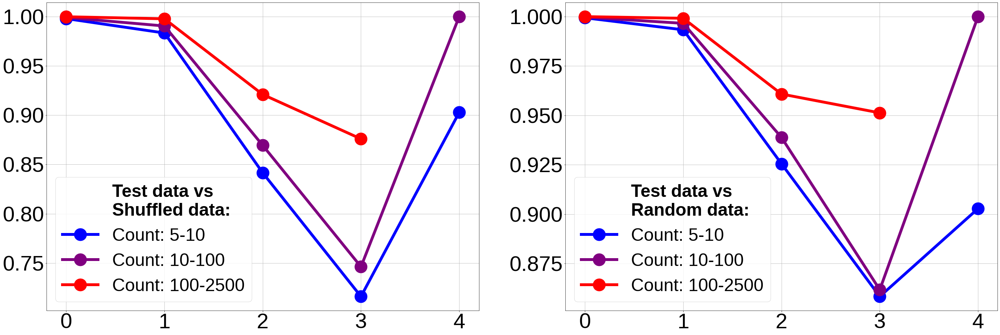

Number of data in bin group 5-10: 67034
[0 1 2 3 4]
Number of data in bin group 10-100: 38660
[0 1 2 3 4]
Number of data in bin group 100-2500: 1747
[0 1 2 3]


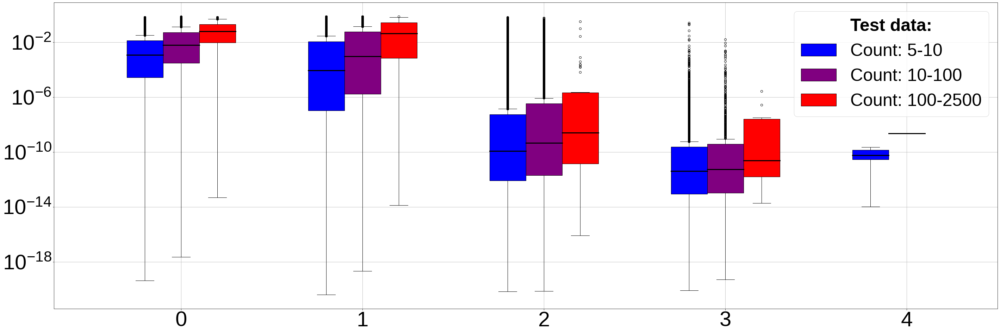

In [43]:
bins = [(5, 10), (10, 100), (100, 2500)]
bins, rocauc_values_shuffled, rocauc_values_random, prauc_values_shuffled, prauc_values_random = compute_auc_values_combined(target_test, count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)

# Call the plotting function roc-auc 
plot_auc_graphs(bins, rocauc_values_shuffled, rocauc_values_random, '{}/model_evaluation/adobe_plots/AUC_vs_target_test_for_diff_counts.png'.format(folder_path))

# Call the plotting function pr-auc 
plot_auc_graphs(bins, prauc_values_shuffled, prauc_values_random, '{}/model_evaluation/adobe_plots/AUC_vs_target_test_for_diff_counts_pr.png'.format(folder_path))

# plot the box plot
bins, probabilities = compute_probabilities_by_count(target_test, count_test, peptide_eval_test_prob, bins)
plot_box_plot_by_count(bins, probabilities, '{}/model_evaluation/adobe_plots/probabilities_vs_target_test_for_diff_counts.png'.format(folder_path))

#### probability distribution analysis

In [39]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib import ticker
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import precision_recall_curve, average_precision_score
from matplotlib.lines import Line2D



def plot_probability_density(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, filename):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    bins_log = np.linspace(np.log10(1e-22), np.log10(1), 100)
    bin_widths_log = (bins_log[1:] - bins_log[:-1])
    bins = 10 ** bins_log

    log_peptide_eval_prob = np.log10(peptide_eval_test_prob)
    log_peptide_eval_shuffled_prob = np.log10(peptide_eval_shuffled_test_prob)
    log_peptide_eval_random_prob = np.log10(peptide_eval_random_test_prob)

    plt.bar(bins[:-1], np.histogram(log_peptide_eval_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.7, color='#4169E1', label="Test data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_shuffled_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_shuffled_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='#2ca02c', label="Shuffled data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_random_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_random_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='#ff7f0e', label="Random data")

    # Add the threshold
    # plt.axvline(x=1e-13, color='#e74c3c', linestyle='--')
    # plt.axvline(x=1e-11, color='#e74c3c', linestyle='--') # Add this line for the new threshold
 
    ax = plt.gca()
    ax.set_xscale("log")
    ax.set_xticks([1e-21, 1e-17, 1e-13, 1e-9, 1e-5, 1])
    ax.get_xaxis().set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'$10^{{{int(np.log10(x)):d}}}$' if x < 1 else '1'))
    # ax.set_xlabel('Evaluated probabilities')
    plt.ylim([0.0, 0.25])
    # Get the legend object
    legend = plt.legend(loc="best")
    # Set the frame edge color of the legend to black
    legend.get_frame().set_edgecolor('black')
    # plt.title('Probability density plot')
    # ax.tick_params(axis='x', labelsize=40)
    plt.savefig(filename, bbox_inches='tight')
    plt.show()


def plot_roc_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, filename):
    y_true_shuffled = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_shuffled_test_prob.shape[0])))
    y_score_shuffled = np.concatenate((peptide_eval_test_prob, peptide_eval_shuffled_test_prob))
    fpr_shuffled, tpr_shuffled, thresholds_shuffled = roc_curve(y_true_shuffled, y_score_shuffled)
    roc_auc_shuffled = auc(fpr_shuffled, tpr_shuffled)

    y_true_random = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_random_test_prob.shape[0])))
    y_score_random = np.concatenate((peptide_eval_test_prob, peptide_eval_random_test_prob))
    fpr_random, tpr_random, thresholds_random = roc_curve(y_true_random, y_score_random)
    roc_auc_random = auc(fpr_random, tpr_random)
    
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(16, 16), facecolor=(1, 1, 1))
    plt.plot(fpr_random, tpr_random, color='#ff7f0e', label='Native peptides vs randomly generated peptides (AUC = %0.2f)' % roc_auc_random)
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label='Random classifier (ROC-AUC = 0.50)')
    plt.plot(fpr_shuffled, tpr_shuffled, color='#2ca02c', label='Native peptides vs shuffled peptides (AUC = %0.2f)' % roc_auc_shuffled)

    threshold_value = 1e-13
    threshold_idx_shuffled = np.argmin(np.abs(thresholds_shuffled - threshold_value))
    fpr_at_threshold_shuffled = fpr_shuffled[threshold_idx_shuffled]
    tpr_at_threshold_shuffled = tpr_shuffled[threshold_idx_shuffled]
    threshold_idx_random = np.argmin(np.abs(thresholds_random - threshold_value))
    fpr_at_threshold_random = fpr_random[threshold_idx_random]
    tpr_at_threshold_random = tpr_random[threshold_idx_random]
    # Mark points on the ROC curve for the threshold
    plt.plot(fpr_at_threshold_shuffled, tpr_at_threshold_shuffled, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8, alpha=0.9)  # for shuffled
    plt.plot(fpr_at_threshold_random, tpr_at_threshold_random, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8, alpha=0.9)  # for random

    # threshold_value_2 = 1e-11
    # threshold_idx_shuffled_2 = np.argmin(np.abs(thresholds_shuffled - threshold_value_2))
    # fpr_at_threshold_shuffled_2 = fpr_shuffled[threshold_idx_shuffled_2]
    # tpr_at_threshold_shuffled_2 = tpr_shuffled[threshold_idx_shuffled_2]
    # threshold_idx_random_2 = np.argmin(np.abs(thresholds_random - threshold_value_2))
    # fpr_at_threshold_random_2 = fpr_random[threshold_idx_random_2]
    # tpr_at_threshold_random_2 = tpr_random[threshold_idx_random_2]
    # plt.plot(fpr_at_threshold_shuffled_2, tpr_at_threshold_shuffled_2, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8)  # for shuffled
    # plt.plot(fpr_at_threshold_random_2, tpr_at_threshold_random_2, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8)  # for random

    plt.xlim([0.0, 1.0])
    plt.ylim([-0.05, 1.05])
    # plt.xlabel('False Positive Rate')
    # plt.ylabel('True Positive Rate')
    # plt.title('ROC curve')
    # plt.savefig('model_evaluation/ROC_curve_combined_test.png', bbox_inches='tight')
    # Create custom legend
    legend_elements = [
        Line2D([0], [0], color='black', lw=0, label='Test Data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='darkorange', label='Random data (AUC = %0.2f)' % roc_auc_random),
        Line2D([0], [0], color='green', label='Shuffled data (AUC = %0.2f)' % roc_auc_shuffled),
        # Line2D([0], [0], color='navy', linestyle='--', label='Random classifier (ROC-AUC = 0.50)'),
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc="lower right", fontsize=45, framealpha=1, bbox_to_anchor = (1.02, 0))
    legend.get_texts()[0].set_weight('bold')
    # Set legend frame edgecolor to black
    legend.get_frame().set_edgecolor('black')
    plt.savefig(filename, bbox_inches='tight')
    plt.show()
    
def plot_precision_recall_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, filename):
    y_true_shuffled = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_shuffled_test_prob.shape[0])))
    y_score_shuffled = np.concatenate((peptide_eval_test_prob, peptide_eval_shuffled_test_prob))
    precision_shuffled, recall_shuffled, thresholds_pr_shuffled = precision_recall_curve(y_true_shuffled, y_score_shuffled)
    pr_auc_shuffled = auc(recall_shuffled, precision_shuffled)

    y_true_random = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_random_test_prob.shape[0])))
    y_score_random = np.concatenate((peptide_eval_test_prob, peptide_eval_random_test_prob))
    precision_random, recall_random, thresholds_pr_random = precision_recall_curve(y_true_random, y_score_random)
    pr_auc_random = auc(recall_random, precision_random)
    
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Calibri',
        'lines.linewidth': 8,
    })
    
    plt.figure(figsize=(16, 16), facecolor=(1, 1, 1))
    plt.plot(recall_random, precision_random, color='#ff7f0e', label='Native peptides vs randomly generated peptides (PR-AUC = %0.2f)' % pr_auc_random)
    plt.plot(recall_shuffled, precision_shuffled, color='#2ca02c', label='Native peptides vs shuffled peptides (PR-AUC = %0.2f)' % pr_auc_shuffled)
    
    threshold_value = 1e-13
    threshold_idx_shuffled_pr = np.argmin(np.abs(thresholds_pr_shuffled - threshold_value))
    precision_at_threshold_shuffled = precision_shuffled[threshold_idx_shuffled_pr]
    recall_at_threshold_shuffled = recall_shuffled[threshold_idx_shuffled_pr]
    threshold_idx_random_pr = np.argmin(np.abs(thresholds_pr_random - threshold_value))
    precision_at_threshold_random = precision_random[threshold_idx_random_pr]
    recall_at_threshold_random = recall_random[threshold_idx_random_pr]
    # Mark points on the PR curve for the threshold
    plt.plot(recall_at_threshold_shuffled, precision_at_threshold_shuffled, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8, alpha=0.9)  # for shuffled
    plt.plot(recall_at_threshold_random, precision_at_threshold_random, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8, alpha=0.9)  # for random

    # threshold_value_2_pr = 1e-11
    # threshold_idx_shuffled_pr_2 = np.argmin(np.abs(thresholds_pr_shuffled - threshold_value_2_pr))
    # precision_at_threshold_shuffled_2 = precision_shuffled[threshold_idx_shuffled_pr_2]
    # recall_at_threshold_shuffled_2 = recall_shuffled[threshold_idx_shuffled_pr_2]
    # threshold_idx_random_pr_2 = np.argmin(np.abs(thresholds_pr_random - threshold_value_2_pr))
    # precision_at_threshold_random_2 = precision_random[threshold_idx_random_pr_2]
    # recall_at_threshold_random_2 = recall_random[threshold_idx_random_pr_2]
    # plt.plot(recall_at_threshold_shuffled_2, precision_at_threshold_shuffled_2, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8)  # for shuffled
    # plt.plot(recall_at_threshold_random_2, precision_at_threshold_random_2, color='#e74c3c', marker='x', markersize=30, markeredgewidth=8)  # for random

    # Compute the baseline value
    baseline = y_true_random.sum() / y_true_random.shape[0]
    # Plot the baseline
    plt.plot([0, 1], [baseline, baseline], color='navy', linestyle='--', label='Random classifier (PR-AUC = 0.50)')
    plt.xlim([0.0, 1.0])
    plt.ylim([-0.05, 1.05])
    # plt.xlabel('Recall')
    # plt.ylabel('Precision')
    # plt.title('Precision-Recall curve')
    # Create custom legend
    legend_elements = [
        Line2D([0], [0], color='black', lw=0, label='Test Data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='darkorange', label='Random data (AUC = %0.2f)' % pr_auc_random),
        Line2D([0], [0], color='green', label='Shuffled data (AUC = %0.2f)' % pr_auc_shuffled),
        # Line2D([0], [0], color='navy', linestyle='--', label='Random classifier (PR-AUC = 0.50)'),
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc="lower left", fontsize=45, framealpha=1, bbox_to_anchor = (-0.02, 0))
    legend.get_texts()[0].set_weight('bold')
    # Set legend frame edgecolor to black
    legend.get_frame().set_edgecolor('black')
    plt.savefig(filename, bbox_inches='tight')
    plt.show()

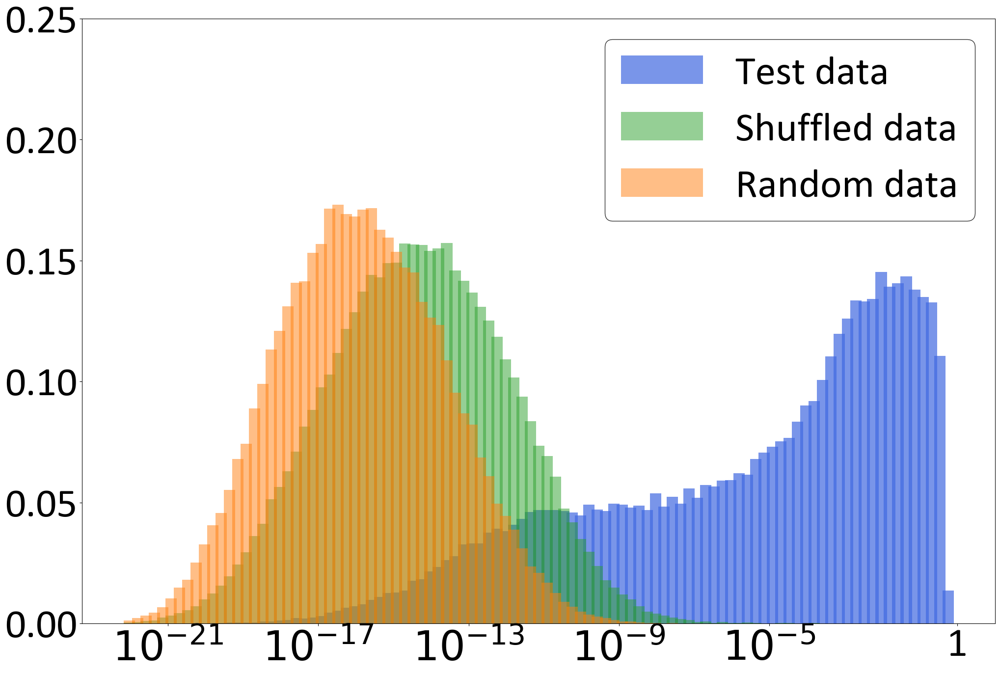

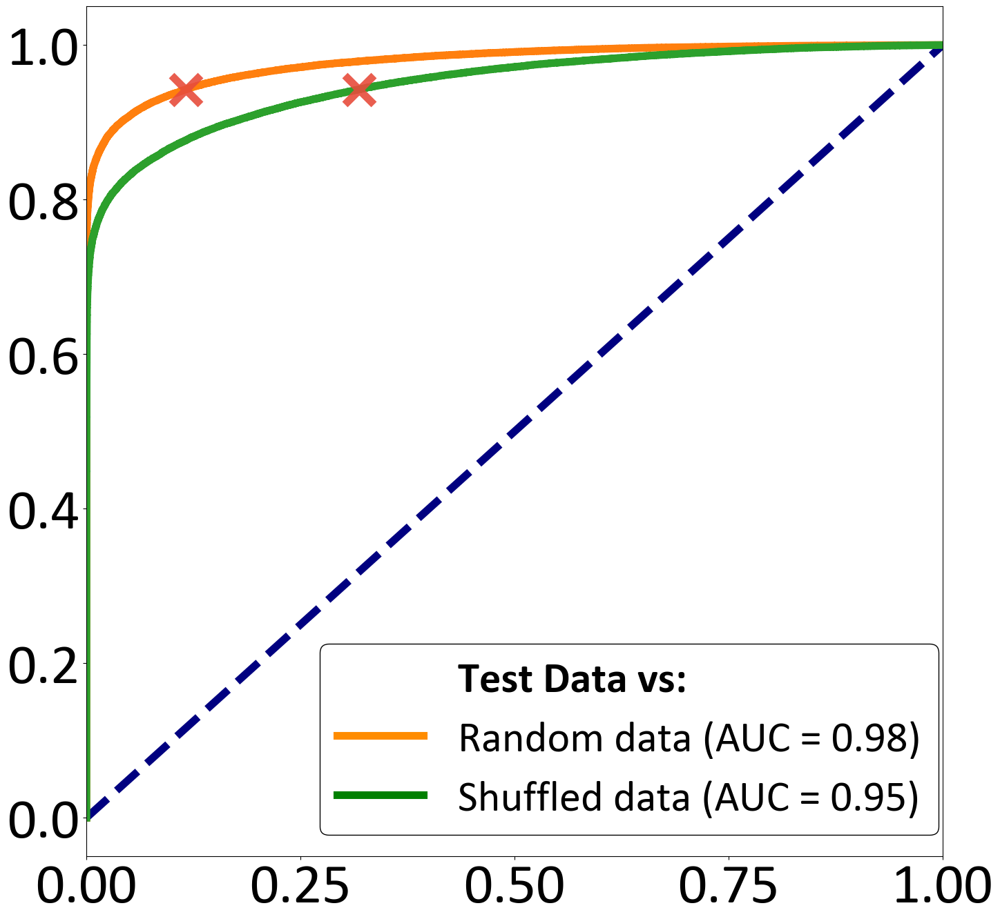

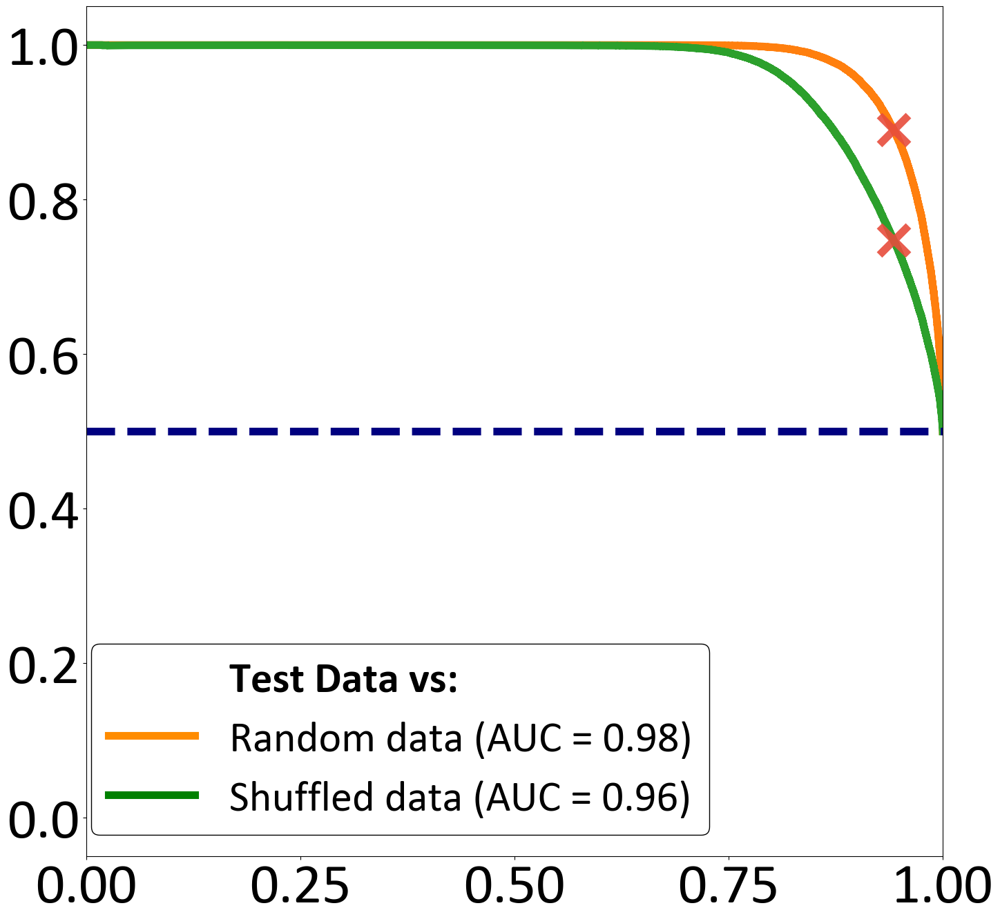

In [9]:
peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)

peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)

peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)

plot_probability_density(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, '{}/model_evaluation/adobe_plots/evaluated_density_plot_test.png'.format(folder_path))
plot_roc_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, '{}/model_evaluation/adobe_plots/ROC_curve_combined_test.png'.format(folder_path))
plot_precision_recall_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, '{}/model_evaluation/adobe_plots/Precision_Recall_curve_combined_test.png'.format(folder_path))

#### Probability distribution analysis for DiffRBM

In [41]:
DiffRBM_peptide_eval = np.load('{}/model_evaluation/DiffRBM_peptide_eval.npy'.format(folder_path), allow_pickle=True)
DiffRBM_peptide_eval_shuffled = np.load('{}/model_evaluation/DiffRBM_peptide_eval_shuffled.npy'.format(folder_path), allow_pickle=True)
DiffRBM_peptide_eval_random = np.load('{}/model_evaluation/DiffRBM_peptide_eval_random.npy'.format(folder_path), allow_pickle=True)

peptide_eval_prob = DiffRBM_peptide_eval[:, 2].astype(np.float64)
peptide_eval_shuffled_prob = DiffRBM_peptide_eval_shuffled[:, 2].astype(np.float64)
peptide_eval_random_prob = DiffRBM_peptide_eval_random[:, 2].astype(np.float64)

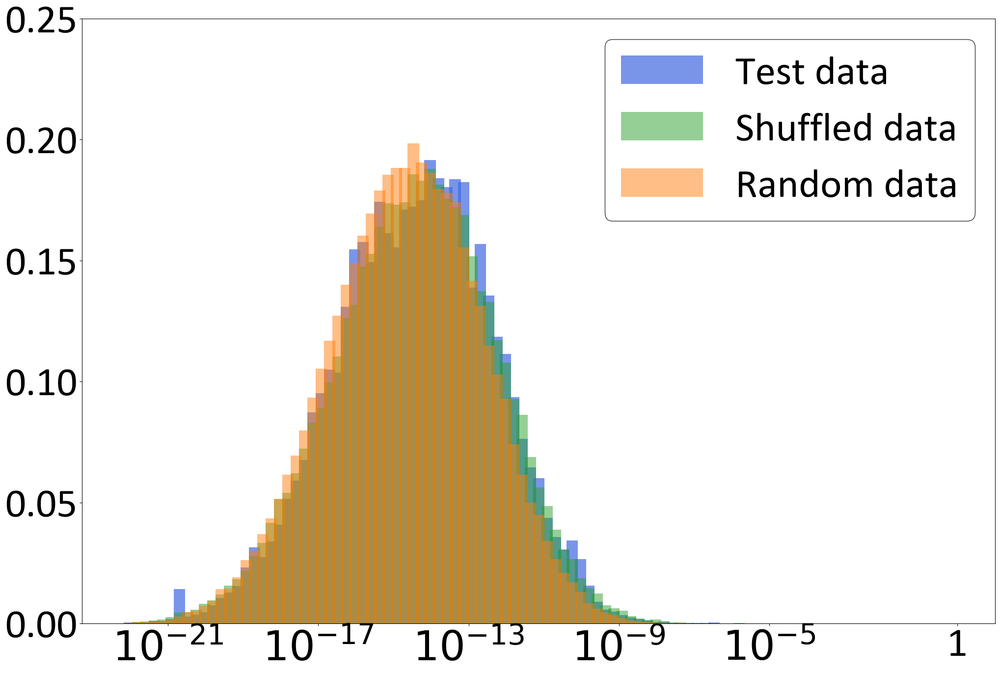

In [42]:
plot_probability_density(peptide_eval_prob, peptide_eval_shuffled_prob, peptide_eval_random_prob, '{}/model_evaluation/adobe_plots/evaluated_density_plot_DiffRBM.png'.format(folder_path))

#### Database statistics

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os

folder_path  = "models/model_M"

In [2]:
# Initialization of all statistics 
top_20_counts = {'antiparallel': {}, 'parallel': {}}
counts = {}
lengths = {}
antiparallel_lengths = {}
parallel_lengths = {}
key_distribution = {}
ave_comp_per_key_each_length = {'antiparallel': {}, 'parallel': {}}
antiparallel = 0
parallel = 0
total_num = 0
total_counts = 0
total_keys = 0
total_data_stored = 0

# Load data and process incrementally
for type in ['antiparallel', 'parallel']:
    length_list = os.listdir("AF2_beta_strand_database/" + type)
    length_list.sort()
    
    for length in length_list:
        length_name = length.split('_')[1]
        
        # Reset current counts for this length
        current_counts = []
        num_comp = 0
        num_load = 0
        num_keys = 0

        length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
        for subfolder in length_subfolders:
            data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True).tolist()
            
            # Update statistics as you load
            for key, comps in data.items():
                num_keys += 1
                total_data_stored += len(comps)
                num_load += len(comps)
                num_comp += len(comps)
                key_distribution[len(key)] = key_distribution.get(len(key), 0) + 1

                for comp, value in comps.items():
                    total_num += 1
                    total_counts += value
                    if type == 'antiparallel':
                        antiparallel += 1
                        antiparallel_lengths[len(key)] = antiparallel_lengths.get(len(key), 0) + 1
                    else:
                        parallel += 1
                        parallel_lengths[len(key)] = parallel_lengths.get(len(key), 0) + 1

                    lengths[len(key)] = lengths.get(len(key), 0) + 1
                    counts[len(key)] = counts.get(len(key), 0) + value
                    current_counts.append(value)

        # Get top 20 counts for each length after all subfolders for the current length are processed
        current_counts.sort(reverse=True)
        top_20_counts[type][length_name] = current_counts[:20]
        
        # Update the average complementarity
        ave_comp_per_key_each_length[type][length_name] = num_comp / num_keys if num_keys > 0 else 0
        total_keys += num_keys
        print('number of ' + type + ' beta strands with length ' + length + ' sorted: ' + str(num_comp))

# print results
print('total number of unique beta strands: ', total_num)
print('total number of beta strands: ', total_counts)
print('total number of keys: ', total_keys)
print('antiparallel: ', antiparallel)
print('parallel: ', parallel)
lengths_sorted = sorted(lengths.items(), key=lambda x: x[0])
print('lengths: ', lengths_sorted)
print('Antiparallel lengths: ', sorted(antiparallel_lengths.items(), key=lambda x: x[0]))
print('Parallel lengths: ', sorted(parallel_lengths.items(), key=lambda x: x[0]))
print('key distribution: ', sorted(key_distribution.items(), key=lambda x: x[0]))

number of antiparallel beta strands with length length_10 sorted: 17762525
number of antiparallel beta strands with length length_11 sorted: 9551150
number of antiparallel beta strands with length length_12 sorted: 7446947
number of antiparallel beta strands with length length_13 sorted: 4084020
number of antiparallel beta strands with length length_14 sorted: 3126426
number of antiparallel beta strands with length length_15 sorted: 1760403
number of antiparallel beta strands with length length_16 sorted: 1316583
number of antiparallel beta strands with length length_17 sorted: 956653
number of antiparallel beta strands with length length_18 sorted: 779144
number of antiparallel beta strands with length length_19 sorted: 480305
number of antiparallel beta strands with length length_20 sorted: 513854
number of antiparallel beta strands with length length_20more sorted: 1255586
number of antiparallel beta strands with length length_3 sorted: 16995769
number of antiparallel beta strands w

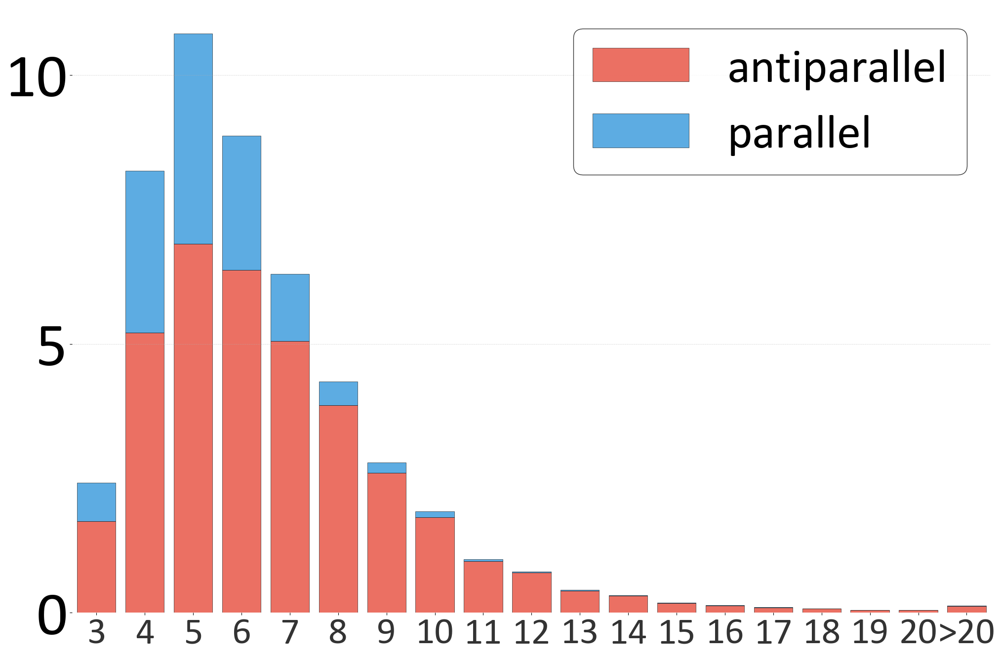

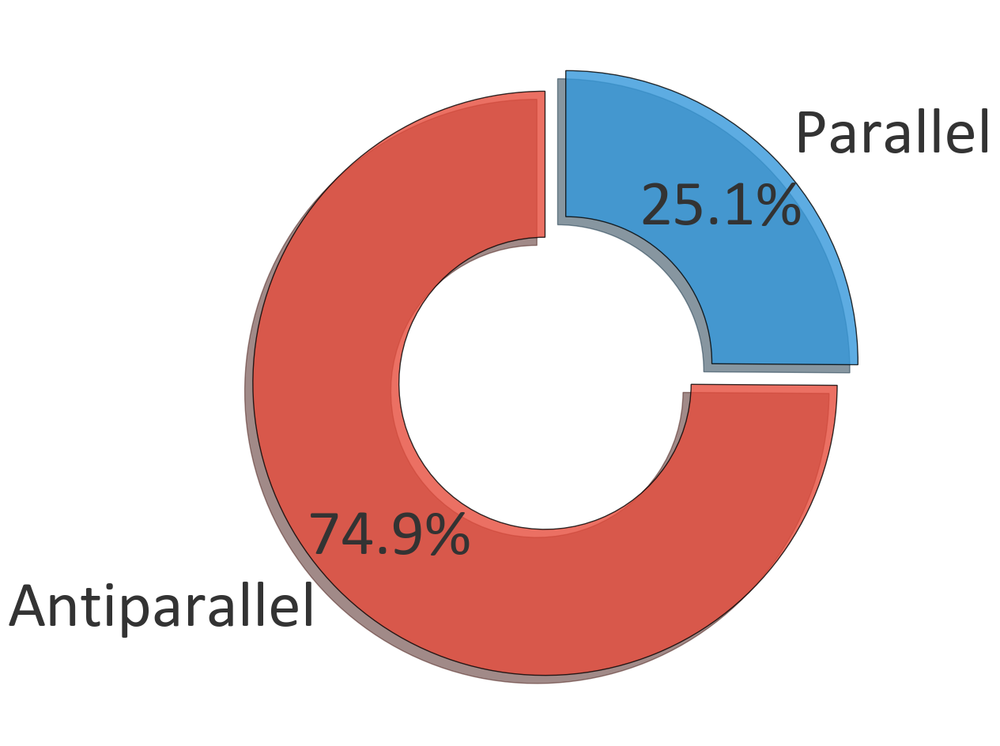

In [12]:
plt.rcParams.update({
    'font.size': 50,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

colors = {
    'antiparallel': '#e74c3c',  # A nice shade of red
    'parallel': '#3498db'       # A nice shade of blue
}

# Create a copy of the original dictionaries to work on.
new_antiparallel_lengths = antiparallel_lengths.copy()
new_parallel_lengths = parallel_lengths.copy()

# Grouping lengths above 20
for d in [new_antiparallel_lengths, new_parallel_lengths]:
    d['>20'] = sum(value for key, value in d.items() if isinstance(key, int) and key > 20)
    keys_to_remove = [key for key in d if isinstance(key, int) and key > 20]
    for key in keys_to_remove:
        del d[key]

# Sorting dictionaries
sorted_antiparallel_lengths = dict(sorted(new_antiparallel_lengths.items(), 
                                          key=lambda x: x[0] if isinstance(x[0], int) else float('inf')))
sorted_parallel_lengths = dict(sorted(new_parallel_lengths.items(), 
                                      key=lambda x: x[0] if isinstance(x[0], int) else float('inf')))

# Getting union of keys from both dictionaries to ensure alignment and converting it to a sorted list
all_keys = sorted(list(set(sorted_antiparallel_lengths.keys()).union(set(sorted_parallel_lengths.keys()))), 
                  key=lambda x: x if isinstance(x, int) else float('inf'))


# Making sure both dictionaries contain all keys (filling missing keys with zeros)
for key in all_keys:
    sorted_antiparallel_lengths[key] = sorted_antiparallel_lengths.get(key, 0)
    sorted_parallel_lengths[key] = sorted_parallel_lengths.get(key, 0)

scaled_antiparallel_values = [sorted_antiparallel_lengths[key] / 1e7 for key in all_keys]
scaled_parallel_values = [sorted_parallel_lengths[key] / 1e7 for key in all_keys]

# Change all '>20' to 21 as an intermediary value
numeric_keys = [key if isinstance(key, int) else 21 for key in all_keys]

# Main bar width
bar_width = 0.8

# Create the figure and axis
fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))

# Plot the bars
bars_antiparallel = ax.bar(numeric_keys, scaled_antiparallel_values, bar_width, 
                           color=colors['antiparallel'], label='antiparallel', edgecolor='black', alpha=0.8, linewidth=0.5)
bars_parallel = ax.bar(numeric_keys, scaled_parallel_values, bar_width, 
                       color=colors['parallel'], bottom=scaled_antiparallel_values, label='parallel', edgecolor='black', alpha=0.8, linewidth=0.5)

# Customize gridlines
ax.yaxis.grid(True, which='major', linestyle='--', linewidth=0.5, alpha=0.6)

# Set x-axis ticks and labels
ax.set_xticks(numeric_keys)
x_labels = [str(key) if isinstance(key, int) else '>20' for key in all_keys]
ax.set_xticklabels(x_labels, color='#333333')

# Set the font size for x and y tick labels
ax.tick_params(axis='x', labelsize=55)  
ax.tick_params(axis='y', labelsize=90)  

# Customize the spines
for spine in ['top', 'right', 'bottom', 'left']:
    ax.spines[spine].set_visible(False)

# Legend styling
legend = ax.legend(frameon=True, edgecolor='black', prop={'size': 70})
legend.get_frame().set_alpha(0.8)

# Adjust the plot limits
ax.set_xlim(2.5, 21.5) 

plt.savefig('{}/model_evaluation/adobe_plots/AF2_beta_strand_length_frequency_barchart.png'.format(folder_path), bbox_inches='tight')
plt.show()

# Compute the total values for antiparallel and parallel
total_antiparallel = sum(scaled_antiparallel_values)
total_parallel = sum(scaled_parallel_values)
pie_values = [total_antiparallel, total_parallel]
pie_labels = ['Antiparallel', 'Parallel']

# Defining an "explode" parameter to separate the slices slightly
explode = (0.05, 0.05)

fig, ax = plt.subplots(figsize=(12, 12), facecolor=(1, 1, 1))
ax.pie(pie_values, labels=pie_labels, colors=[colors['antiparallel'], colors['parallel']], 
       autopct='%1.1f%%', startangle=90, explode=explode, shadow=True, pctdistance=0.75,
       textprops={'fontsize': 60, 'color': '#333333'}, wedgeprops=dict(width=0.5, edgecolor='black', alpha=0.8))

# ax.set_title("Overall Proportions", fontsize=38, fontweight='normal', color='#555555', pad=20)

plt.savefig('{}/model_evaluation/adobe_plots/AF2_beta_strand_overall_proportions_piechart.png'.format(folder_path), bbox_inches='tight')
plt.show()

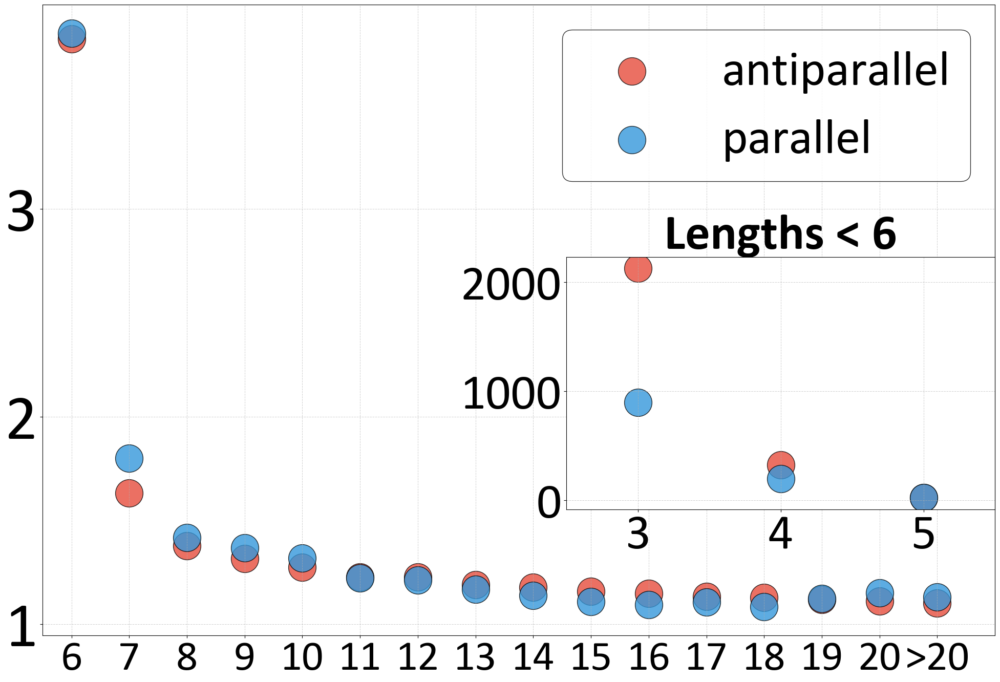

In [14]:
plt.rcParams.update({
    'font.size': 55,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Create main plot
ax_main = plt.gca()

# Create inset for lengths below 6
ax_inset = ax_main.inset_axes([0.55, 0.2, 0.45, 0.40])  # [x, y, width, height] in figure coordinates

# Define a more aesthetically pleasing color palette
colors = {
    'antiparallel': '#e74c3c',  # A nice shade of red
    'parallel': '#3498db'       # A nice shade of blue
}

for type in ['antiparallel', 'parallel']:
    for length, value in ave_comp_per_key_each_length[type].items():
        if length == '20more':
            x_value = 21
        else:
            x_value = int(length)
        
        if x_value < 6:
            ax_inset.scatter(x_value, value, color=colors[type], edgecolors='black', s=1500, alpha=0.8, label=type)
        else:
            ax_main.scatter(x_value, value, color=colors[type], edgecolors='black', s=1500, alpha=0.8, label=type)

# Format the main plot
ax_main.grid(True, which='both', linestyle='--', linewidth=0.7, alpha=0.6)
ax_main.set_xlim(5.5, 22)
ax_main.set_xticks(list(range(6, 22)))
ax_main.set_xticklabels([str(i) for i in range(6, 21)] + [">20"])

# Set the font size for x and y tick labels
ax_main.tick_params(axis='x', labelsize=60)  
ax_main.tick_params(axis='y', labelsize=90)  

# Format the inset
ax_inset.grid(True, which='both', linestyle='--', linewidth=0.7, alpha=0.6)
ax_inset.set_xlim(2.5, 5.5)
ax_inset.set_xticks(list(range(3, 6)))
ax_inset.set_title("Lengths < 6", fontsize=45, fontweight = 'bold')
# set the text size to 70
for item in ([ax_inset.title, ax_inset.xaxis.label, ax_inset.yaxis.label] +
                ax_inset.get_xticklabels() + ax_inset.get_yticklabels()):
        item.set_fontsize(70)

# Remove redundant labels
handles, labels = ax_main.get_legend_handles_labels()
by_label = dict(zip(labels, handles))
ax_main.legend(by_label.values(), by_label.keys(), loc="upper right", edgecolor='black', fontsize=70)

# Optionally save the plot
plt.savefig('{}/model_evaluation/adobe_plots/AF2_beta_strand_ave_comp_per_key_scatter.png'.format(folder_path), bbox_inches='tight')
plt.show()

#### promiscuity and average within distance histogram for datasets

In [ ]:
import os
import numpy as np

def hamming_distance(s1, s2):
    """Calculate the Hamming distance between two strings"""
    return sum(el1 != el2 for el1, el2 in zip(s1, s2))

# Initialize specific statistics for length 8 antiparallel data
length8_antiparallel_stats = {}

# Load and process 'antiparallel' data of length 8
type = 'antiparallel'
length_list = os.listdir("AF2_beta_strand_database/" + type)
length_list.sort()

for length in length_list:
    if length.split('_')[1] != '8':  # Only interested in length 8
        continue
    
    length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
    for subfolder in length_subfolders:
        data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True).tolist()

        # Update statistics for length 8 and antiparallel
        for key, comps in data.items():
            high_count_comps = [comp for comp, value in comps.items() if value >= 5]
            
            if high_count_comps:  # Check if there are any comps with count >= 5
                promiscuity = len(comps)  # Includes all comps, not just those with high counts
                
                # Calculate average Hamming distance for all comps
                comp_sequences = list(comps.keys())
                total_hamming_distance = 0
                total_pairs = 0
                
                for i in range(len(comp_sequences)):
                    for j in range(i + 1, len(comp_sequences)):
                        total_hamming_distance += hamming_distance(comp_sequences[i], comp_sequences[j])
                        total_pairs += 1

                avg_hamming_distance = total_hamming_distance / total_pairs if total_pairs > 0 else 0
                
                length8_antiparallel_stats[key] = {'promiscuity': promiscuity, 'average_hamming_distance': avg_hamming_distance}

# Output the statistics for length 8 antiparallel data
print("Statistics for length 8 antiparallel data:")
print(length8_antiparallel_stats)

# Results reproduction: Model M retrain

In [1]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os
import matplotlib.pyplot as plt

In [2]:
# 0.1 load the model
model_path = "models/model_M_retrain/model_training/model_M_23Apr10_0108PM" # <------------------------------------------------------------------------change

query_size, key_size, value_size, num_hiddens = 512, 512, 512, 512
num_layers, dropout = 6, 0.2
lr, training_steps, batch_size, label_smoothing = 0.0004, 300000, 4096, 0.1
ffn_num_input, ffn_num_hiddens, num_heads = 512, 2048, 8

norm_shape = [512] # 512 corresponds to the dim of such number to normalize
device = d2l.try_gpu()

encoder_standard = TransformerEncoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout)
decoder_standard = TransformerDecoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout, shared_embedding=encoder_standard.embedding)
model_standard = EncoderDecoder(encoder_standard, decoder_standard)

model_standard_total_params = sum(p.numel() for p in model_standard.parameters())
model_standard_total_trainable_params = sum(p.numel() for p in model_standard.parameters() if p.requires_grad)

state_dict = torch.load(model_path,map_location=('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in state_dict.items():
	name = k[7:] #remove 'module'
	new_state_dict[name] = v

model_standard.load_state_dict(new_state_dict)

model_use = model_standard # <------------------------------------------------------------------------change
prediction_length = 8 # <------------------------------------------------------------------------change

folder_path = "models/model_M_retrain"
dataset_path = "datasets/dataset_l8_retrain"

print('Standard model: total number of parameters: {}'.format(model_standard_total_params))
print('Standard model: total number of trainable parameters: {}'.format(model_standard_total_trainable_params))

Standard model: total number of parameters: 44126232
Standard model: total number of trainable parameters: 44126232


#### explore length 8 full dataset reversity

In [3]:
import numpy as np

# load training data
train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

In [4]:
# Initialize variables to count the total number of data and reverse data
total_data_count = 0
reverse_data_count = 0

# Create a set to store unique target-comp pairs
target_comp_set = set()

# Populate the set with target-comp pairs from the training data
for row in train_array:
    target, comp, _ = row
    target_comp_set.add((target, comp))
    total_data_count += 1  # Increment the total data count

# Loop through the train_array to check for reverse data
for row in train_array:
    target, comp, _ = row
    
    # Check if the reverse pair exists in the set
    if (comp[::-1], target[::-1]) in target_comp_set:
        reverse_data_count += 1  # Increment the reverse data count

# Calculate the proportion of reverse data
if total_data_count > 0:
    proportion_reverse_data = reverse_data_count / total_data_count
else:
    proportion_reverse_data = 0

print("Total number of data points:", total_data_count)
print("Number of reverse data points:", reverse_data_count)
print("Proportion of reverse data:", proportion_reverse_data)

Total number of data points: 2148813
Number of reverse data points: 1315615
Proportion of reverse data: 0.6122519735314333


In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt

# Initialize variables for reverse data counting and plotting
reverse_data_count = 0

# Initialize train_counts and reverse_counts with zeros
train_counts = [count for _, _, count in train_array]
reverse_counts = [0] * len(train_array)

# Create a dictionary for quick lookup from (comp[::-1], target[::-1]) to the index in train_array
train_dict_reverse_lookup = {(comp[::-1], target[::-1]): i for i, (target, comp, _) in enumerate(train_array)}

# Loop through the larger database to update reverse_counts
for type in ['antiparallel']:
    length_list = os.listdir("AF2_beta_strand_database/" + type)
    for length in length_list:
        length_name = length.split('_')[1]
        if length_name == '8':
            length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
            for subfolder in length_subfolders:
                data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True).tolist()
                for target, comps in data.items():
                    for comp, count in comps.items():
                        index = train_dict_reverse_lookup.get((target, comp))
                        if index is not None:
                            reverse_data_count += 1
                            reverse_counts[index] = count

# Calculate and print the proportion of reverse data
proportion_reverse_data = reverse_data_count / len(train_array)
print("Proportion of reverse data:", proportion_reverse_data)

Proportion of reverse data: 0.6682373012449199


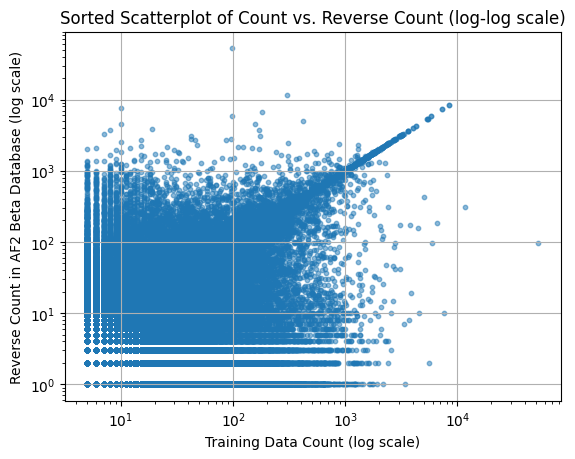

In [6]:
train_counts = np.array(train_counts).astype(int)
reverse_counts = np.array(reverse_counts).astype(int)

# Sort train_counts and reverse_counts based on train_counts
sorted_indices = np.argsort(train_counts)
sorted_train_counts = np.array(train_counts)[sorted_indices]
sorted_reverse_counts = np.array(reverse_counts)[sorted_indices]

# Plot the sorted scatterplot
plt.scatter(sorted_train_counts, sorted_reverse_counts, alpha=0.5, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Training Data Count (log scale)')
plt.ylabel('Reverse Count in AF2 Beta Database (log scale)')
plt.title('Sorted Scatterplot of Count vs. Reverse Count (log-log scale)')
plt.grid(True)
plt.show()

## train and validation losses

In [3]:
import numpy as np
import matplotlib.pyplot as plt

# load training loss array
model_base_training_loss = np.loadtxt('models/model_base/model_training/model_base_training_loss.csv', delimiter=',')
model_A_training_loss = np.loadtxt('models/model_A/model_training/model_A_training_loss.csv', delimiter=',')
model_B_training_loss = np.loadtxt('models/model_B/model_training/model_B_training_loss.csv', delimiter=',')
model_C_training_loss = np.loadtxt('models/model_C/model_training/model_C_training_loss.csv', delimiter=',')
model_D_training_loss = np.loadtxt('models/model_D/model_training/model_D_training_loss.csv', delimiter=',')
model_E_training_loss = np.loadtxt('models/model_E/model_training/model_E_training_loss.csv', delimiter=',')
model_F_training_loss = np.loadtxt('models/model_F/model_training/model_F_training_loss.csv', delimiter=',')
model_G_training_loss = np.loadtxt('models/model_G/model_training/model_G_training_loss.csv', delimiter=',')
model_H_training_loss = np.loadtxt('models/model_H/model_training/model_H_training_loss.csv', delimiter=',')
model_I_training_loss = np.loadtxt('models/model_I/model_training/model_I_training_loss.csv', delimiter=',')
model_J_training_loss = np.loadtxt('models/model_J/model_training/model_J_training_loss.csv', delimiter=',')
model_K_training_loss = np.loadtxt('models/model_K/model_training/model_K_training_loss.csv', delimiter=',')
model_L_training_loss = np.loadtxt('models/model_L/model_training/model_L_training_loss.csv', delimiter=',')
model_M_training_loss = np.loadtxt('models/model_M/model_training/model_M_training_loss.csv', delimiter=',')

# load validation loss array  
model_base_validation_loss = np.loadtxt('models/model_base/model_training/model_base_validation_score_loss.csv', delimiter=',')
model_A_validation_loss = np.loadtxt('models/model_A/model_training/model_A_validation_score_loss.csv', delimiter=',')
model_B_validation_loss = np.loadtxt('models/model_B/model_training/model_B_validation_score_loss.csv', delimiter=',')
model_C_validation_loss = np.loadtxt('models/model_C/model_training/model_C_validation_score_loss.csv', delimiter=',')
model_D_validation_loss = np.loadtxt('models/model_D/model_training/model_D_validation_score_loss.csv', delimiter=',')
model_E_validation_loss = np.loadtxt('models/model_E/model_training/model_E_validation_score_loss.csv', delimiter=',')
model_F_validation_loss = np.loadtxt('models/model_F/model_training/model_F_validation_score_loss.csv', delimiter=',')
model_G_validation_loss = np.loadtxt('models/model_G/model_training/model_G_validation_score_loss.csv', delimiter=',')
model_H_validation_loss = np.loadtxt('models/model_H/model_training/model_H_validation_score_loss.csv', delimiter=',')
model_I_validation_loss = np.loadtxt('models/model_I/model_training/model_I_validation_score_loss.csv', delimiter=',')
model_J_validation_loss = np.loadtxt('models/model_J/model_training/model_J_validation_score_loss.csv', delimiter=',')
model_K_validation_loss = np.loadtxt('models/model_K/model_training/model_K_validation_score_loss.csv', delimiter=',')
model_L_validation_loss = np.loadtxt('models/model_L/model_training/model_L_validation_score_loss.csv', delimiter=',')
model_M_validation_loss = np.loadtxt('models/model_M/model_training/model_M_validation_score_loss.csv', delimiter=',')

# retrain training loss
model_M_training_loss_retrain = np.loadtxt('models/model_M/model_training/model_M_training_loss.csv', delimiter=',')

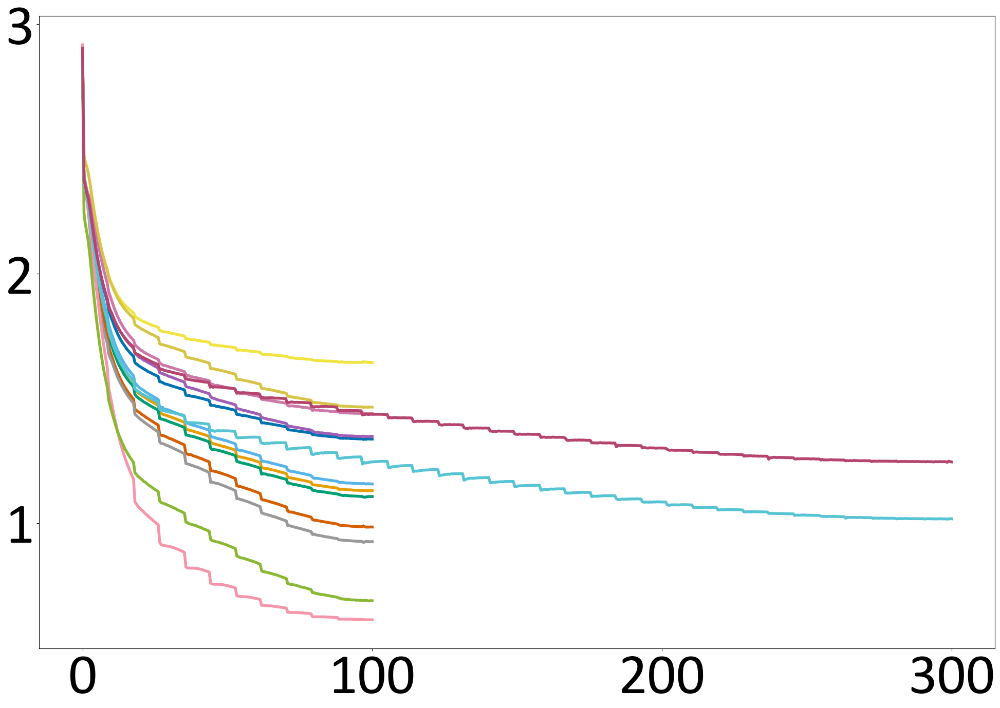

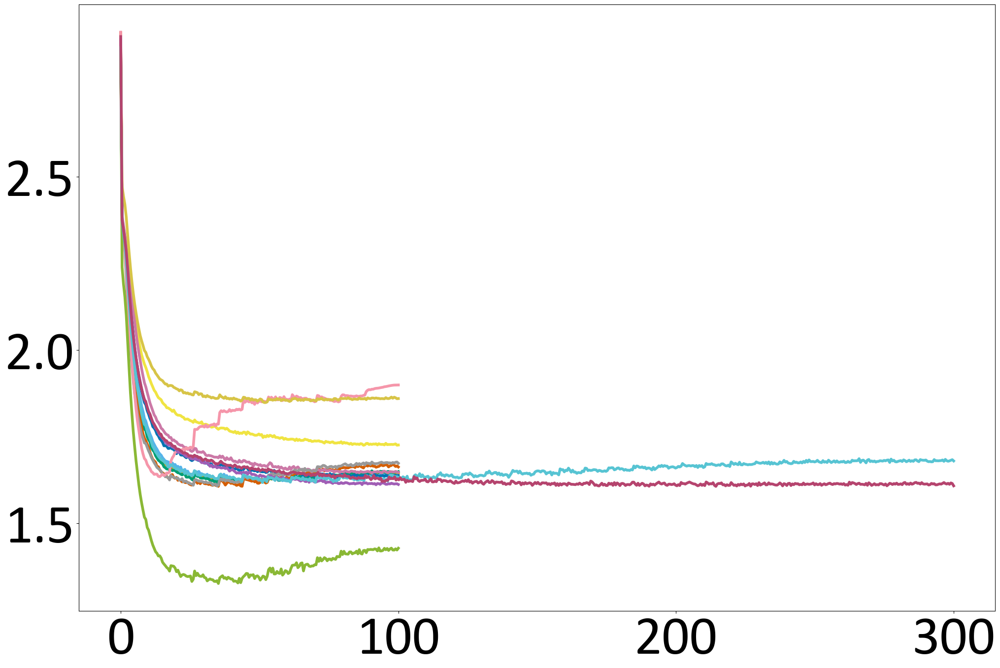

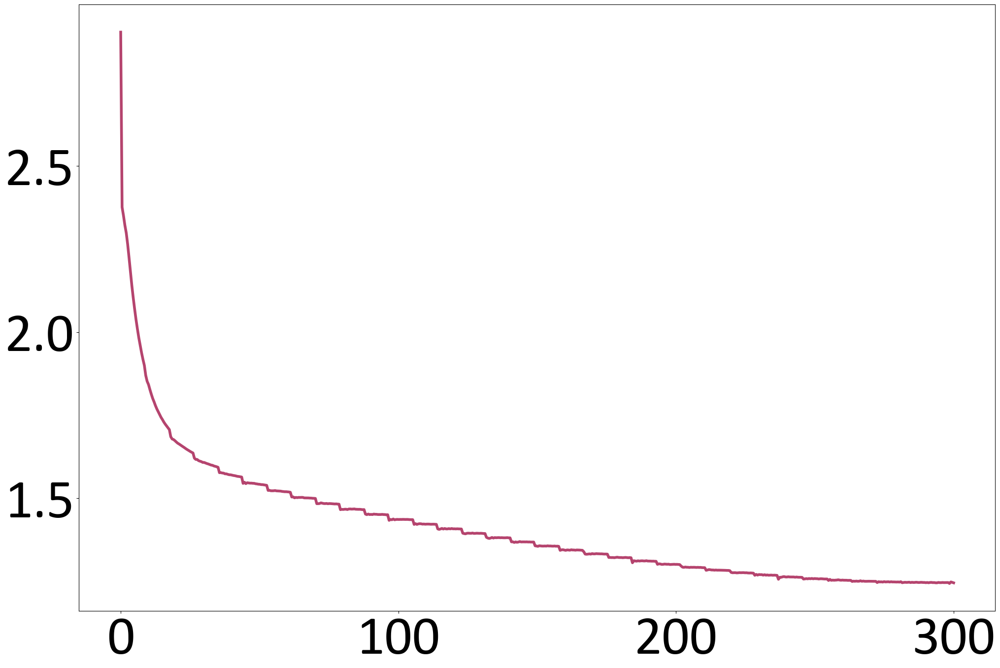

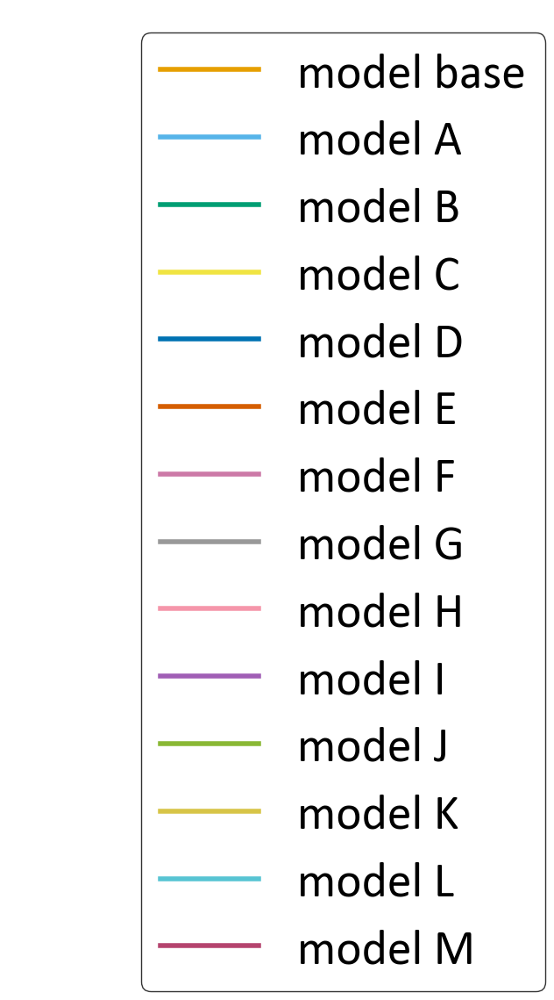

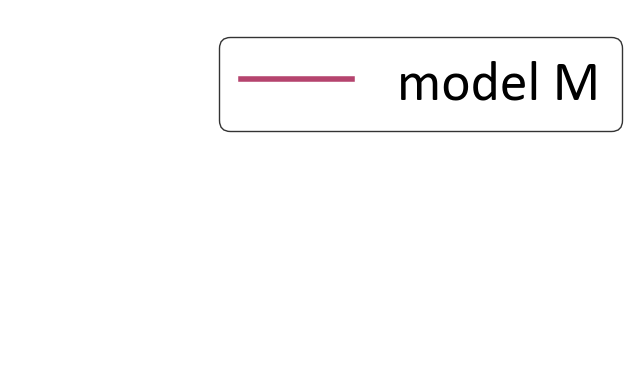

In [14]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

# Define a function to plot training or validation loss on the same axis
def plot_losses_combined(losses, labels, colors, title, filename):
    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    
    for i in range(len(labels)):
        x_axis = np.linspace(0, len(losses[i])*(0.5), len(losses[i]))
        plt.plot(x_axis, losses[i], linestyle='-', color=colors[i], label=f"{labels[i]}")
    
    # plt.xlabel('training step ($\\times 10^{3}$)')
    # plt.ylabel('cross entropy loss')
    # plt.title(title)
    # plt.legend(fontsize=40, bbox_to_anchor=(1.29, 1), loc='upper right')
    plt.savefig(filename, bbox_inches='tight')
    plt.show()
    
def save_legend(labels, colors, filename):
    fig, ax = plt.subplots()
    lines = []
    for i in range(len(labels)):
        line, = ax.plot([0], linestyle='-', color=colors[i], label=f"{labels[i]}")
        lines.append(line)
    legend = ax.legend(handles=lines, fontsize=40, bbox_to_anchor=(1.29, 1), loc='upper right')
    ax.axis('off')
    
    # Set legend border color and thickness
    legend.get_frame().set_edgecolor('black')
    legend.get_frame().set_linewidth(1.0)

    # Get the bounding box of the legend
    legend_bbox = legend.get_window_extent(fig.canvas.get_renderer()).transformed(fig.dpi_scale_trans.inverted())
    
    # Save just the legend
    fig.savefig(filename, bbox_inches=legend_bbox)
    plt.show()

# Combine the training and validation losses for each model
training_losses = [model_base_training_loss, model_A_training_loss, model_B_training_loss, model_C_training_loss,
                   model_D_training_loss, model_E_training_loss, model_F_training_loss, model_G_training_loss,
                   model_H_training_loss, model_I_training_loss, model_J_training_loss, model_K_training_loss,
                   model_L_training_loss, model_M_training_loss]

validation_losses = [model_base_validation_loss, model_A_validation_loss, model_B_validation_loss, model_C_validation_loss,
                     model_D_validation_loss, model_E_validation_loss, model_F_validation_loss, model_G_validation_loss,
                     model_H_validation_loss, model_I_validation_loss, model_J_validation_loss, model_K_validation_loss,
                     model_L_validation_loss, model_M_validation_loss]

training_losses_retrain = [model_M_training_loss_retrain]

# Define labels for each model
labels = ['model base', 'model A', 'model B', 'model C', 'model D', 'model E', 'model F', 'model G', 'model H', 'model I', 'model J', 'model K', 'model L', 'model M']
labels_retrain = ['model M']

# Define a list of distinct colors (as many as there are labels)
colors = ['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2', '#D55E00', '#CC79A7', '#999999', '#F596AA', '#A05EB5', '#8AB835', '#D7C447', '#57C4D3', '#B5446E']
colors_retrain = ['#B5446E']

# Plot the combined training losses for all models
plot_losses_combined(training_losses, labels, colors, 'Training loss plot (Combined)', '{}/model_evaluation/adobe_plots/training_losses_all_models.png'.format(folder_path))
# Plot the combined validation losses for all models
plot_losses_combined(validation_losses, labels, colors, 'Validation loss plot (Combined)', '{}/model_evaluation/adobe_plots/validation_losses_all_models.png'.format(folder_path))
# Plot the combined training losses for retrain model M
plot_losses_combined(training_losses_retrain, labels_retrain, colors_retrain, 'Training loss plot (retrain)', '{}/model_evaluation/adobe_plots/training_losses_retrain_M.png'.format(folder_path))

# Save the legend separately
save_legend(labels, colors, '{}/model_evaluation/adobe_plots/legend_all_models.png'.format(folder_path))
save_legend(labels_retrain, colors_retrain, '{}/model_evaluation/adobe_plots/legend_retrain_M.png'.format(folder_path))

## Interpretability analysis

In [12]:
import numpy as np
import requests
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from collections import OrderedDict
from scipy.stats import pearsonr

def extract_encoder_embedding(model_use):
    encoder_amino_embedding = model_use.encoder.embedding
    encoder_amino_embedding_weight = encoder_amino_embedding.weight.data.cpu().numpy()
    return encoder_amino_embedding_weight

def standardize_embedding_weights(encoder_amino_embedding_weight):
    encoder_amino_embedding_weight_standardized = StandardScaler().fit_transform(encoder_amino_embedding_weight)
    return encoder_amino_embedding_weight_standardized

def plot_embeddings(M_reduced, amino_dict, amino_list, amino_property = None, remove_amino=[], text_bias = 0.05, property_box_shown =True):

    from collections import OrderedDict

    for amino in amino_list:
        # if in remove_words, remove the word from the plot
        if amino in remove_amino:
            continue

        if amino_property != None:
            size, (type, color) = amino_property[amino]
            if (type, color) == ('x', 'blue'):
                label = 'aliphatic'
            elif (type, color) == ('o', 'green'):
                label = 'aromatic'
            elif (type, color) == ('s', 'red'):
                label = 'positive'
            elif (type, color) == ('x', 'red'):
                label = 'negative'
            elif (type, color) == ('o', 'purple'):
                label = 'polar and uncharged'
            else:
                raise ValueError('Unknown amino property')
    
            x, y = M_reduced[amino_dict[amino]]
            # create scatter plot contain 2 labels in 2 legends
            # plt.scatter(x, y, marker=type, color=color, s=size, label=label)
            plt.scatter(x, y, marker=type, color=color, s=240*8, label=label)
            plt.text(x+text_bias*5, y+text_bias-4, amino, fontsize=50)
            if property_box_shown == True:
                plt.legend()

        else:
            x, y = M_reduced[amino_dict[amino]]
            plt.scatter(x, y, marker='x', color='red', s=360)
            plt.text(x+text_bias*2.5, y+text_bias-2, amino, fontsize=50)

    if amino_property != None and property_box_shown == True:
        # combine same labels
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        # additional_labels = ['Small (<120 Da)', 'Medium (120-150 Da)', 'Large (>150 Da)']
        # additional_handles = [plt.plot([], [], color="black", marker = 'o', ms=i*12, ls='')[0] for i in range(2, len(additional_labels)+3)]

        # plt.legend(list(by_label.values()) + additional_handles, list(by_label.keys())+additional_labels, bbox_to_anchor =(0.99, 1), title='Amino acid property')
        plt.legend(list(by_label.values()), list(by_label.keys()), bbox_to_anchor =(0.99, 1), title='Amino acid property', fontsize=50)
    
    # move the legend outside of the plot

def perform_tsne(encoder_amino_embedding_weight_standardized):
    tsne = TSNE(n_components=2, perplexity=3, n_iter=1000, random_state=9)
    encoder_amino_embedding_weight_tsne = tsne.fit_transform(encoder_amino_embedding_weight_standardized)
    return encoder_amino_embedding_weight_tsne

def load_blosum62():
    url = "https://ftp.ncbi.nih.gov/blast/matrices/BLOSUM62"
    response = requests.get(url)
    lines = response.text.strip().split('\n')

    # Remove comment lines
    lines = [line for line in lines if not line.startswith('#')]

    # Parse the matrix
    header = lines.pop(0).split()
    aa_list = [aa for aa in header if aa in amino_dict]  # Only use amino acids in dictionary
    blosum62 = pd.DataFrame(index=aa_list, columns=aa_list)
    for row_num, line in enumerate(lines):
        values = line.split()
        aa = values.pop(0)
        if aa not in aa_list:
            continue
        for i, v in enumerate(values):
            col_aa = header[i]
            if col_aa not in aa_list:
                continue
            blosum62.loc[aa, col_aa] = int(v)
    return blosum62

def calculate_cosine_similarity_matrix(amino_acid_embeddings):
    cosine_sim_matrix = cosine_similarity(amino_acid_embeddings)
    return cosine_sim_matrix

def calculate_pearsons_correlation(cosine_sim_normalized_flat, blosum62_normalized_flat):
    correlation, _ = pearsonr(cosine_sim_normalized_flat, blosum62_normalized_flat)
    return correlation

c:\Users\10331\anaconda3\envs\UROP_TransformerBeta\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\10331\anaconda3\envs\UROP_TransformerBeta\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


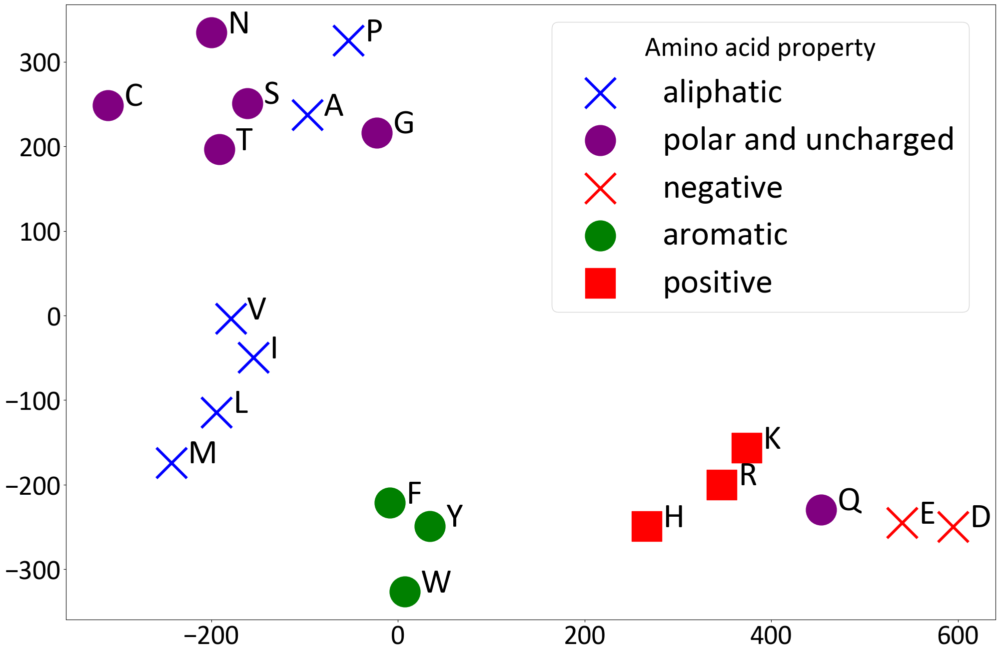

In [13]:
# Assuming you have already loaded the necessary libraries and defined the required variables like amino_dict, amino_letters, amino_property, etc.

# Load your model here
model_use = model_standard  # Replace with the code to load your model

# Extract encoder embedding
encoder_amino_embedding_weight = extract_encoder_embedding(model_use)

# Standardize the embedding weights
encoder_amino_embedding_weight_standardized = standardize_embedding_weights(encoder_amino_embedding_weight)

# Perform t-SNE on the input embedding weights
encoder_amino_embedding_weight_tsne = perform_tsne(encoder_amino_embedding_weight_standardized)

amino_letters = list(amino_dict.keys())
amino_letters_removal = ['<bos>', '<eos>', '<pad>', '<unk>']


text_bias = 3.5

plt.rcParams.update({
    'font.size': 40,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

size_scalar = 8
small_size = 40 * size_scalar
medium_size = 120 * size_scalar
large_size = 240 * size_scalar


# old grouping
# aliphatic = ('x', 'blue')
# sulfur = ('s', 'blue')
# aromatic = ('o', 'green')
# hydroxly = ('o', 'blue')
# amide = ('o', 'purple')
# positive = ('s', 'red')
# negative = ('x', 'red')
# unique = ('o', 'orange')

aliphatic = ('x', 'blue')
aromatic = ('o', 'green')
positive = ('s', 'red')
negative = ('x', 'red')
polar_uncharged = ('o', 'purple')

amino_property = {
	'A': (small_size, aliphatic),
	'C': (medium_size, polar_uncharged),
	'D': (medium_size, negative),
	'E': (medium_size, negative),
	'F': (large_size, aromatic),
	'G': (small_size, polar_uncharged),
	'H': (large_size, positive),
	'I': (medium_size, aliphatic),
	'K': (medium_size, positive),
	'L': (medium_size, aliphatic),
	'M': (medium_size, aliphatic),
	'N': (medium_size, polar_uncharged),
	'P': (small_size, aliphatic),
	'Q': (medium_size, polar_uncharged),
	'R': (large_size, positive),
	'S': (small_size, polar_uncharged),
	'T': (small_size, polar_uncharged),
	'V': (small_size, aliphatic),
	'W': (large_size, aromatic),
	'Y': (large_size, aromatic)
}


# Plot embeddings
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plot_embeddings(encoder_amino_embedding_weight_tsne, amino_dict, amino_letters, remove_amino=amino_letters_removal, amino_property=amino_property, text_bias=text_bias)
# plt.xlabel("t-SNE1")
# plt.ylabel("t-SNE2")
# plt.title("Input embedding")
plt.savefig('{}/model_evaluation/adobe_plots/encoder_input_embedding_TSNE.png'.format(folder_path), bbox_inches='tight')
plt.show()

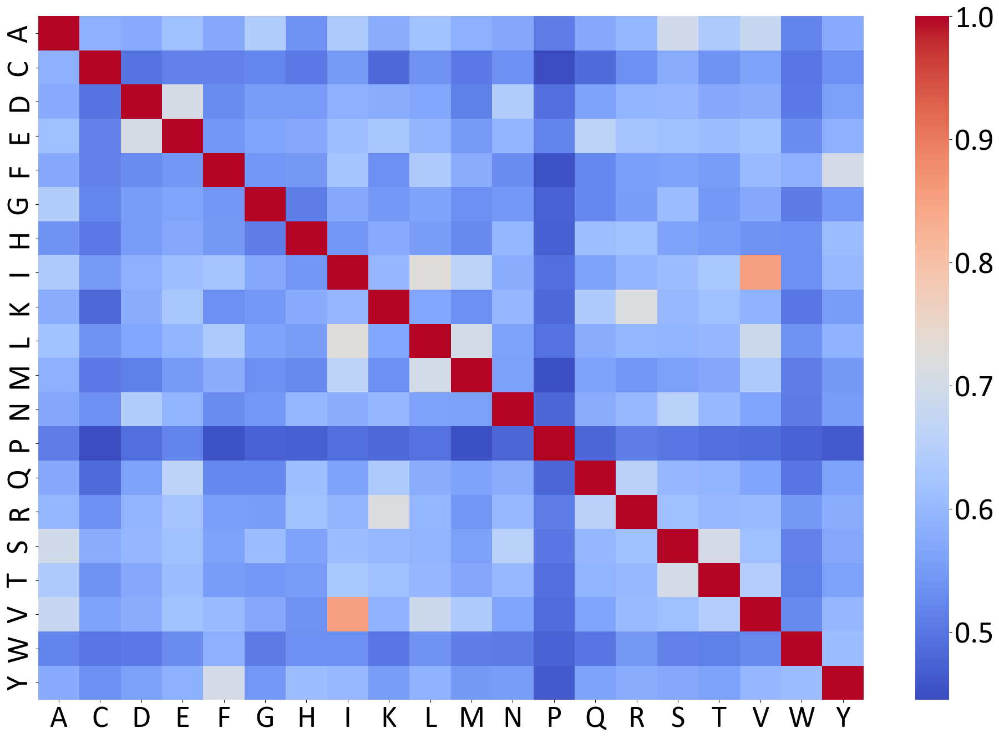

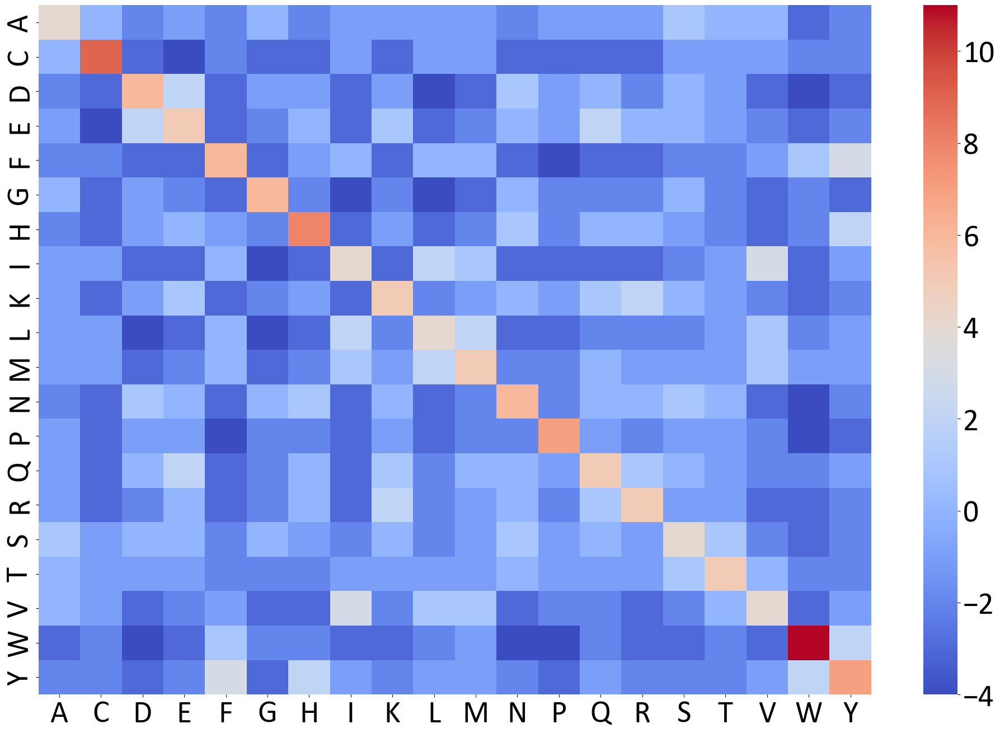

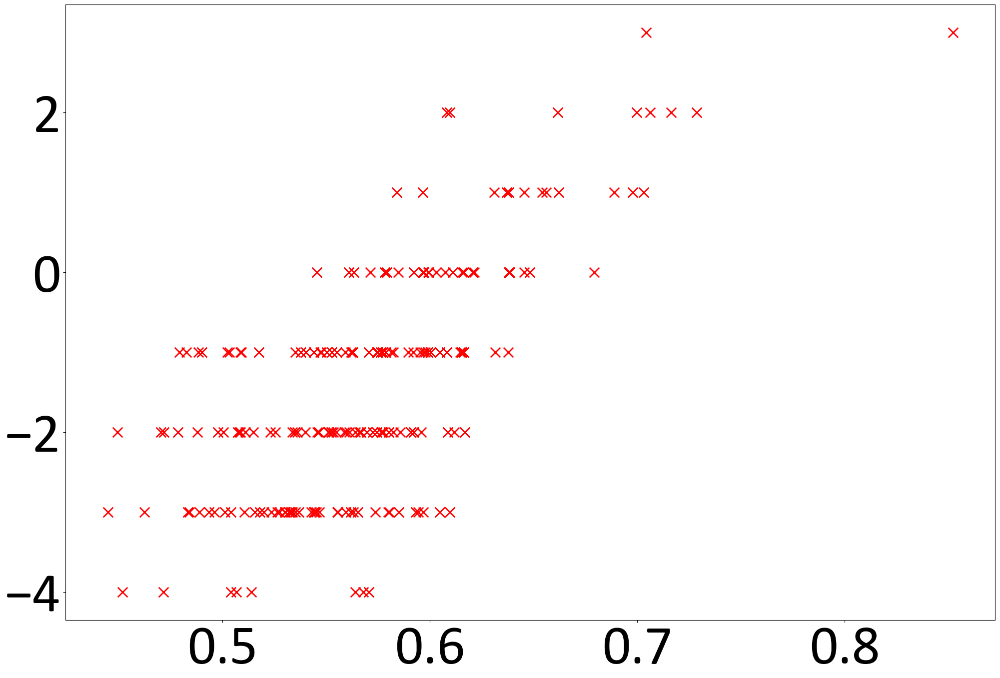

Pearson's correlation: 0.701


In [5]:
plt.rcParams.update({
    'font.size': 40,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

# Extract only amino acid embeddings
amino_acids = list("ACDEFGHIKLMNPQRSTVWY")
amino_acid_indices = [amino_dict[aa] for aa in amino_acids]
amino_acid_embeddings = encoder_amino_embedding_weight[amino_acid_indices]

# Load BLOSUM62 matrix
blosum62 = load_blosum62()
# make the blosum62 matrix in the same order as the cosine_sim_matrix
blosum62 = blosum62.reindex(index=amino_acids, columns=amino_acids)

# Calculate cosine similarity matrix
cosine_sim_matrix = calculate_cosine_similarity_matrix(amino_acid_embeddings)

# Plot heatmaps
cosine_sim_matrix_df = pd.DataFrame(cosine_sim_matrix, index=amino_acids, columns=amino_acids)
# Plot heatmap for Cosine Similarity Matrix (Normalized)
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
sns.heatmap(cosine_sim_matrix_df, annot=False, cmap="coolwarm")
# plt.title("Cosine Similarity Matrix")
plt.savefig('{}/model_evaluation/adobe_plots/correlation_cosine_similarity_matrix.png'.format(folder_path), bbox_inches='tight')
plt.show()

# Plot heatmap for BLOSUM62 (Normalized)
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
sns.heatmap(blosum62.astype(float), annot=False, cmap="coolwarm")
# plt.title("BLOSUM62 Matrix")
plt.savefig('{}/model_evaluation/adobe_plots/correlation_BLOSUM62_matrix.png'.format(folder_path), bbox_inches='tight')
plt.show()

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

# Calculate Pearson's correlation
upper_triangle_indices = np.triu_indices(cosine_sim_matrix.shape[0], k=1)
cosine_sim_normalized_flat = cosine_sim_matrix[upper_triangle_indices]
blosum62_normalized_flat = blosum62.values[upper_triangle_indices]
correlation = calculate_pearsons_correlation(cosine_sim_normalized_flat, blosum62_normalized_flat)

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(cosine_sim_normalized_flat, blosum62_normalized_flat, c="r", s=200, marker="x", linewidth=2)
# plt.xlabel("Cosine Similarity")
# plt.ylabel("BLOSUM62")
# Add the correlation text directly to the plot without using a legend
# legend_text = f"Pearson's correlation: {correlation:.3f}"
# plt.text(0.02, 0.95, legend_text, fontsize=30, ha='left', va='center', transform=plt.gca().transAxes)
# plt.title("Correlation Scatter plot")
plt.savefig('{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter.png'.format(folder_path), bbox_inches='tight')
plt.show()
print(f"Pearson's correlation: {correlation:.3f}")

#### individual amino acids

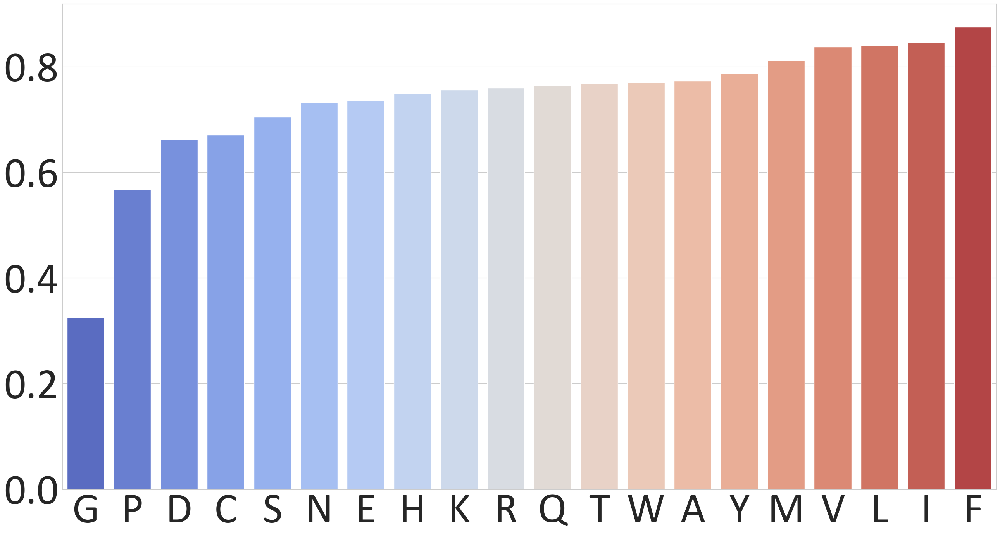

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr
import numpy as np

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Calibri',
    'lines.linewidth': 4,
})

# Step 1: Calculate Individual Pearson Correlations for Each Amino Acid
individual_correlations = []

for idx, aa in enumerate(amino_acids):
	cosine_row = cosine_sim_matrix[idx, :]
	blosum_row = blosum62.iloc[idx].values

	# Exclude the diagonal
	non_diagonal_indices = np.where(np.arange(len(cosine_row)) != idx)
	cosine_row = cosine_row[non_diagonal_indices]
	blosum_row = blosum_row[non_diagonal_indices]

	correlation, _ = pearsonr(cosine_row, blosum_row)
	individual_correlations.append(correlation)

# Step 2: Rank Amino Acids Based on Pearson Correlations
sorted_indices = np.argsort(individual_correlations)
ranked_amino_acids = np.array(amino_acids)[sorted_indices]
ranked_correlations = np.array(individual_correlations)[sorted_indices]

# Step 3: Visualize the Ranked Amino Acids
plt.figure(figsize=(28, 16))
bar_plot = sns.barplot(x=ranked_amino_acids, y=ranked_correlations, palette="coolwarm")

# Setting font and title sizes
# plt.title('Amino Acid Ranking based on Pearson Correlation with BLOSUM62', fontweight='bold')
# plt.xlabel('Amino Acids', fontweight='bold')
# plt.ylabel('Pearson Correlation', fontweight='bold')

# Adding grid
sns.set_style("whitegrid")

# Save the figure if needed
plt.savefig('{}/model_evaluation/adobe_plots/ranked_amino_acids_correlation.png'.format(folder_path), bbox_inches='tight')

plt.tight_layout()
plt.show()

#### other language models

In [56]:
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from matplotlib.transforms import Bbox

def process_embeddings_and_plot(amino_acid_embeddings, amino_acids, amino_dict, blosum62_normalized_flat, model_name):
    plt.rcParams.update({
        'font.size': 40,
        'font.family': 'Calibri',
        'lines.linewidth': 4,
    })
    # Calculate cosine similarity matrix for embeddings
    cosine_sim_matrix = cosine_similarity(amino_acid_embeddings)

    # Convert the cosine similarity matrix to a DataFrame
    cosine_sim_matrix_df = pd.DataFrame(cosine_sim_matrix, index=amino_acids, columns=amino_acids)

    # Create a figure with two subplots (2 rows, 1 column)
    fig, axs = plt.subplots(2, 1, figsize=(24, 36), facecolor=(1, 1, 1))

    # Plot heatmap for Cosine Similarity Matrix on the first subplot
    sns.heatmap(cosine_sim_matrix_df, annot=False, cmap="coolwarm", ax=axs[0])
    axs[0].tick_params(axis='both', which='major', labelsize=40)

    # Calculate Pearson's correlation
    upper_triangle_indices = np.triu_indices(cosine_sim_matrix.shape[0], k=1)
    cosine_sim_normalized_flat = cosine_sim_matrix[upper_triangle_indices]
    correlation = calculate_pearsons_correlation(cosine_sim_normalized_flat, blosum62_normalized_flat)

    # Adjust the width of the second subplot
    box = axs[1].get_position()
    box.x0 = box.x0 
    box.x1 = box.x1 - 0.15
    axs[1].set_position(box)

    # Update font size to 80 for the second plot
    plt.rcParams.update({'font.size': 80})

    # Plot the scatter plot on the second subplot
    scatter_plot = axs[1].scatter(cosine_sim_normalized_flat, blosum62_normalized_flat, c="r", s=400, marker="x", linewidth=2)
    axs[1].tick_params(axis='both', which='major', labelsize=80)

    # Save the figure
    plt.savefig(model_name, bbox_inches='tight')
    plt.show()

    print(f"Pearson's correlation: {correlation:.3f}")

In [57]:
# Prot GPT2
from transformers import GPT2Model, GPT2Tokenizer
import torch

tokenizer = GPT2Tokenizer.from_pretrained("nferruz/ProtGPT2")
model = GPT2Model.from_pretrained("nferruz/ProtGPT2")

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = model.wte(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 1 as we are only encoding one amino acid, 
    # so we extract the embedding for the amino acid (at position 0)
    aa_embedding = input_embeddings[0, 0, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)
# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_protgpt2 = embeddings_matrix.cpu().detach().numpy()

print("Prot GPT2:", embeddings_matrix_protgpt2.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)

# Prot bert 
from transformers import BertModel, BertTokenizer
import torch

tokenizer = BertTokenizer.from_pretrained("Rostlab/prot_bert", do_lower_case=False)
model = BertModel.from_pretrained("Rostlab/prot_bert")

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = model.embeddings.word_embeddings(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 3 as we have [CLS], aa, [SEP], 
    # so we extract the embedding for the amino acid (at position 1)
    aa_embedding = input_embeddings[0, 1, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)
# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_protbert = embeddings_matrix.cpu().detach().numpy()

print("Prot Bert:", embeddings_matrix_protbert.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)


from transformers import BertModel, BertTokenizer
import torch

tokenizer = BertTokenizer.from_pretrained("Rostlab/prot_bert_bfd", do_lower_case=False)
model = BertModel.from_pretrained("Rostlab/prot_bert_bfd")

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = model.embeddings.word_embeddings(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 3 as we have [CLS], aa, [SEP], 
    # so we extract the embedding for the amino acid (at position 1)
    aa_embedding = input_embeddings[0, 1, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)

# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_prot_bert_bfd = embeddings_matrix.cpu().detach().numpy()

print("prot_bert_bfd:", embeddings_matrix_prot_bert_bfd.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)

from transformers import T5Tokenizer, T5Model
import re
import torch

tokenizer = T5Tokenizer.from_pretrained('Rostlab/prot_t5_xl_bfd', do_lower_case=False)
model = T5Model.from_pretrained("Rostlab/prot_t5_xl_bfd")

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Getting the model's word embeddings
word_embeddings = model.get_input_embeddings()

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = word_embeddings(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 1 as we are only encoding one amino acid, 
    # so we extract the embedding for the amino acid (at position 0)
    aa_embedding = input_embeddings[0, 0, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)
# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_prot_t5_xl_bfd = embeddings_matrix.cpu().detach().numpy()

print("prot_t5_xl_bfd:", embeddings_matrix_prot_t5_xl_bfd.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)


from transformers import XLNetTokenizer, XLNetModel
import torch

# Instantiate the tokenizer and model
tokenizer = XLNetTokenizer.from_pretrained('Rostlab/prot_xlnet', do_lower_case=False)
model = XLNetModel.from_pretrained('Rostlab/prot_xlnet')

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Getting the model's word embeddings
word_embeddings = model.get_input_embeddings()

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = word_embeddings(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 1 as we are only encoding one amino acid, 
    # so we extract the embedding for the amino acid (at position 0)
    aa_embedding = input_embeddings[0, 0, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)

# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_prot_xlnet = embeddings_matrix.cpu().detach().numpy()

print("prot_xlnet:", embeddings_matrix_prot_xlnet.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)

from transformers import AlbertTokenizer, AlbertModel
import torch

# Instantiate the tokenizer and model
tokenizer = AlbertTokenizer.from_pretrained('Rostlab/prot_albert', do_lower_case=False)
model = AlbertModel.from_pretrained('Rostlab/prot_albert')

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Getting the model's word embeddings
word_embeddings = model.get_input_embeddings()

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    encoded_input = tokenizer(aa, return_tensors='pt')

    # Get the input embeddings
    input_embeddings = word_embeddings(encoded_input['input_ids'])

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 1 as we are only encoding one amino acid, 
    # so we extract the embedding for the amino acid (at position 0)
    aa_embedding = input_embeddings[0, 1, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)

# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_prot_albert = embeddings_matrix.cpu().detach().numpy()

print("prot_albert:", embeddings_matrix_prot_albert.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)

import torch
from tape import ProteinBertModel, TAPETokenizer

# Instantiate the model and tokenizer
model = ProteinBertModel.from_pretrained('bert-base')
tokenizer = TAPETokenizer(vocab='iupac')  # iupac is the vocab for TAPE models

amino_acids = list("ACDEFGHIKLMNPQRSTVWY")

# Initialize a list to store the embeddings
embeddings_list = []

# Iterate over each amino acid
for aa in amino_acids:
    # Encode the amino acid
    token_ids = torch.tensor([tokenizer.encode(aa)])
    
    # Get the input embeddings
    input_embeddings = model.embeddings.word_embeddings(token_ids)

    # The input embeddings have the shape (1, sequence_length, hidden_size), 
    # and sequence_length is 3 as we have [CLS], aa, [SEP], 
    # so we extract the embedding for the amino acid (at position 1)
    aa_embedding = input_embeddings[0, 1, :]

    # Append the embeddings to the list
    embeddings_list.append(aa_embedding)

# Convert the list of embeddings into a matrix
embeddings_matrix = torch.stack(embeddings_list)

# Convert the PyTorch tensor to a NumPy array
embeddings_matrix_tape_bert = embeddings_matrix.detach().numpy()

print("TAPE Bert:", embeddings_matrix_tape_bert.shape)
# Calculate and print the number of all parameters in the model
total_parameters = sum(p.numel() for p in model.parameters())
print("Total number of parameters: ", total_parameters)

# Calculate and print the number of trainable parameters in the model
trainable_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: ", trainable_parameters)

c:\Users\10331\anaconda3\envs\UROP_TransformerBeta\lib\site-packages\huggingface_hub\file_download.py:133: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\10331\.cache\huggingface\hub. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


Prot Bert


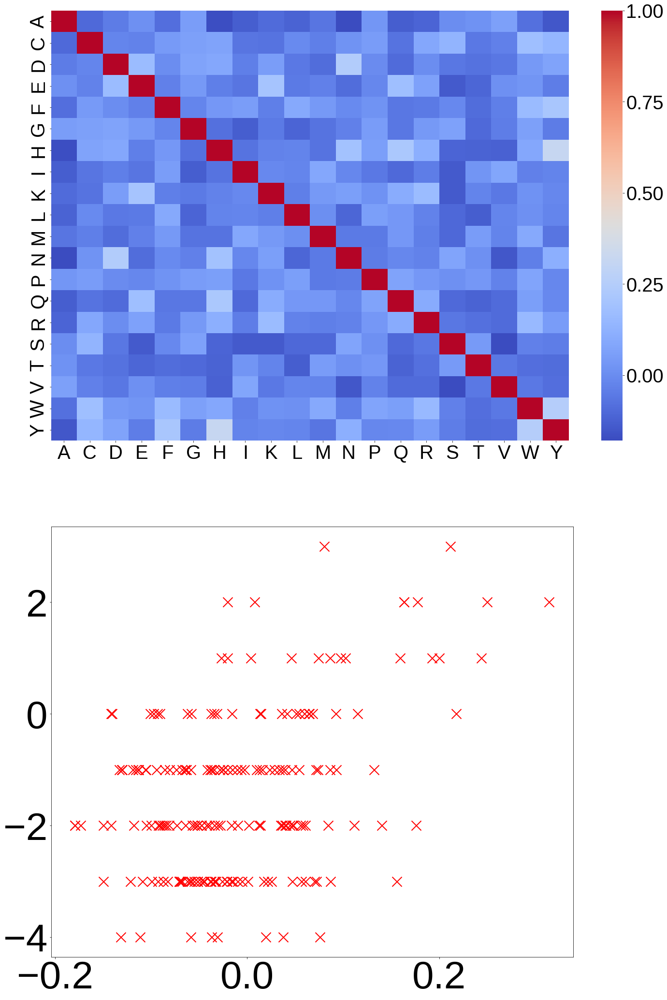

Pearson's correlation: 0.417
Prot Bert BFD


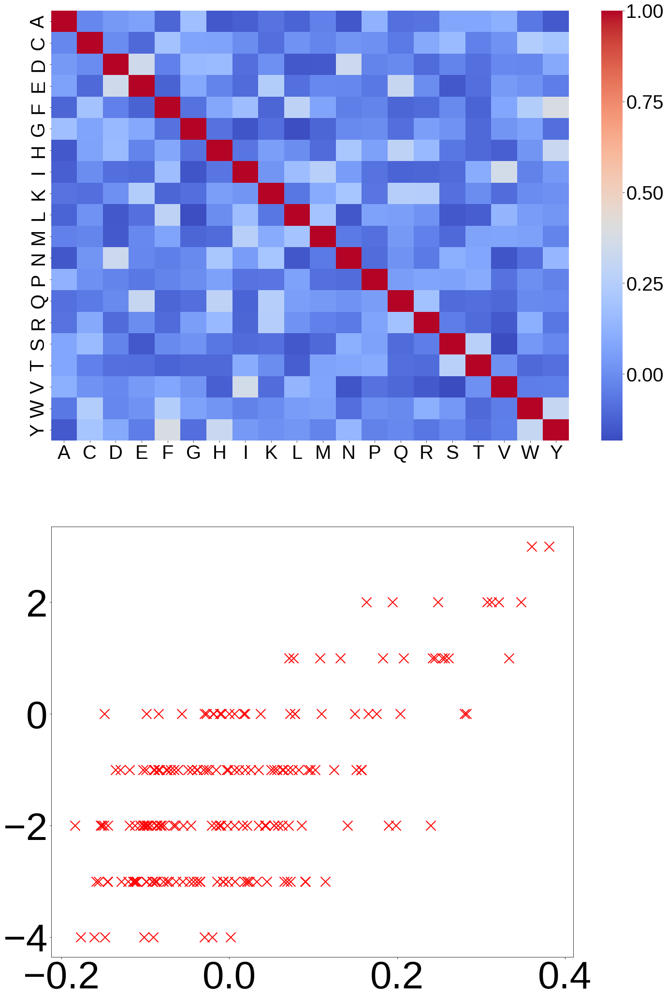

Pearson's correlation: 0.648
Prot T5 XL BFD


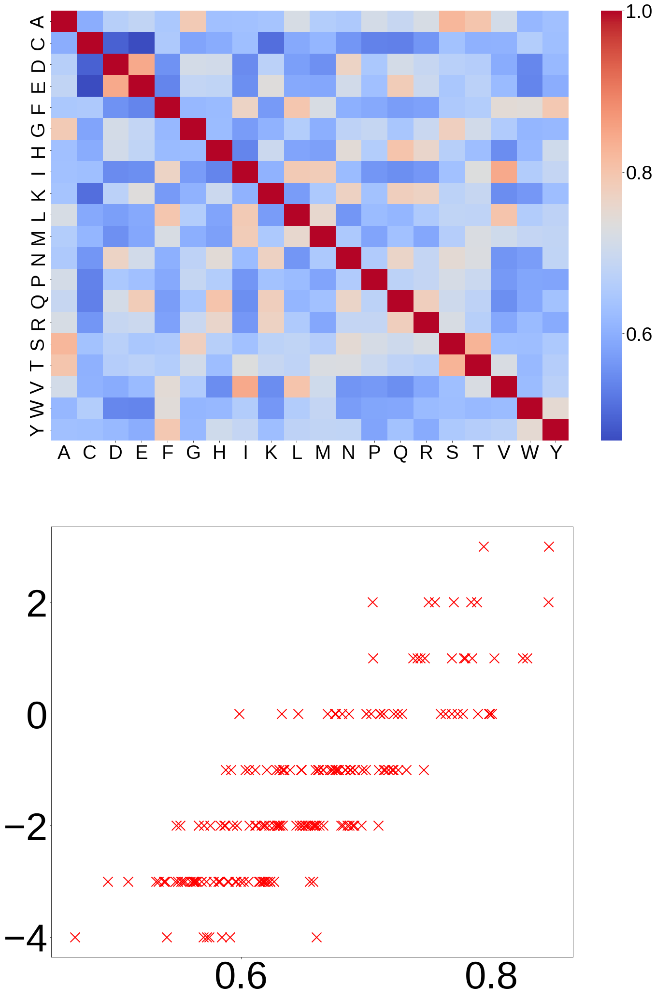

Pearson's correlation: 0.828
Prot XLNet


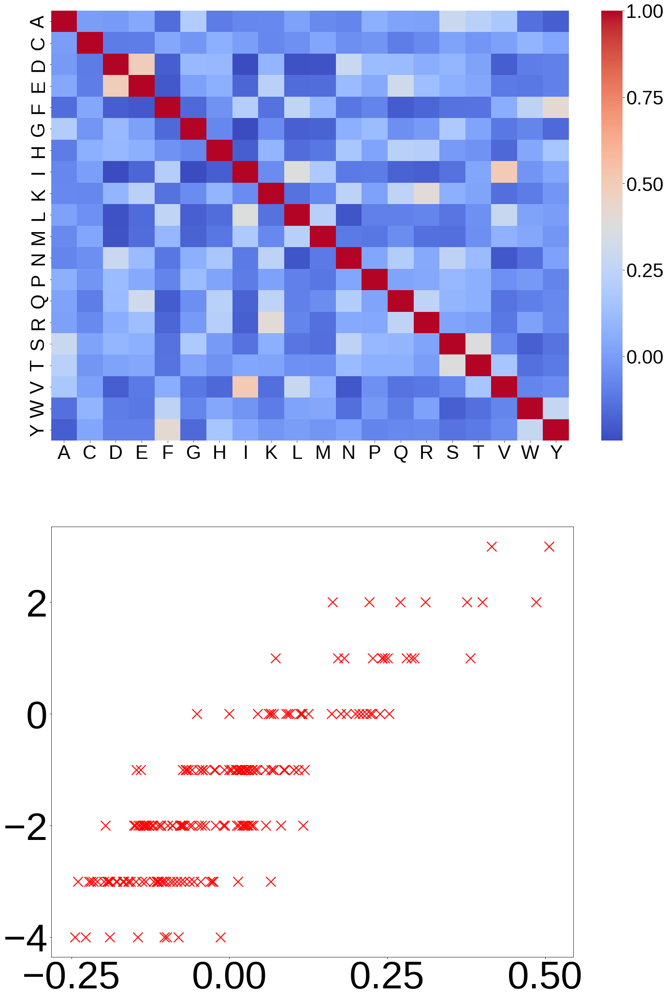

Pearson's correlation: 0.863
Prot Albert


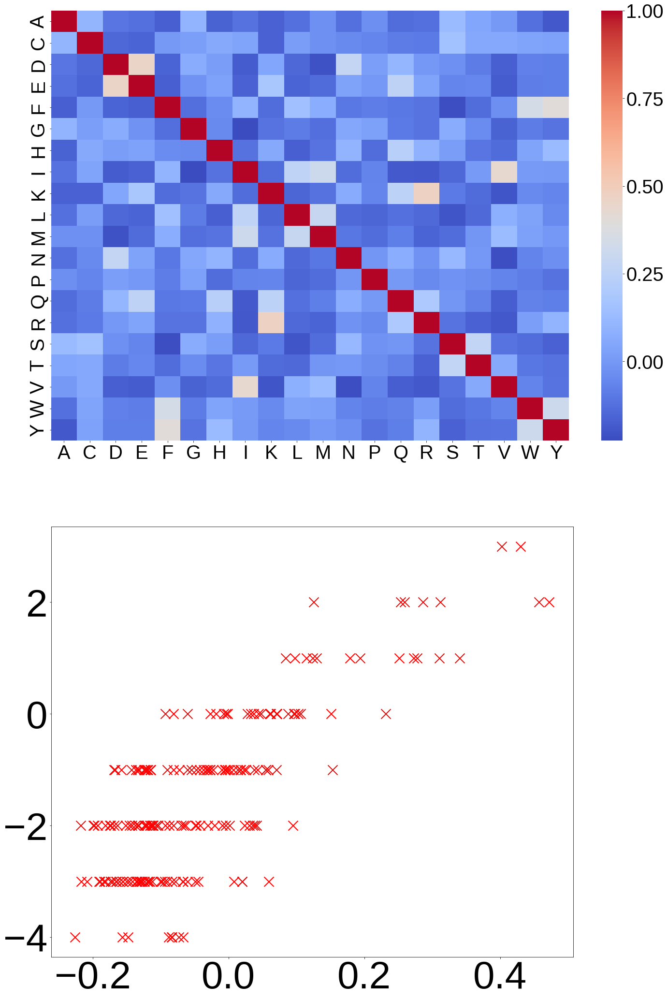

Pearson's correlation: 0.785
Prot GPT2


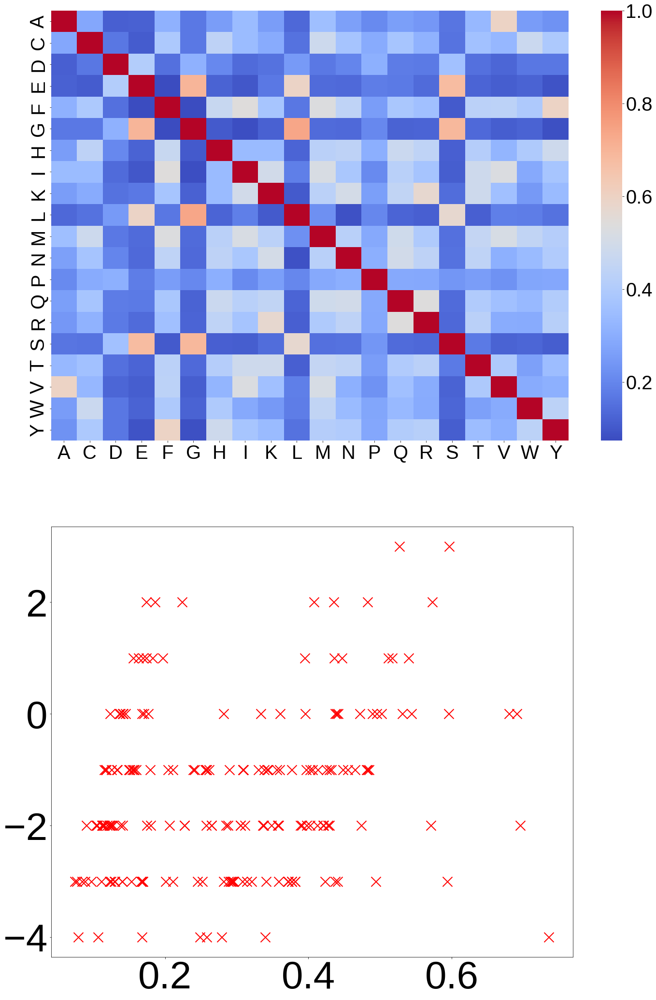

Pearson's correlation: 0.250
TAPE Bert


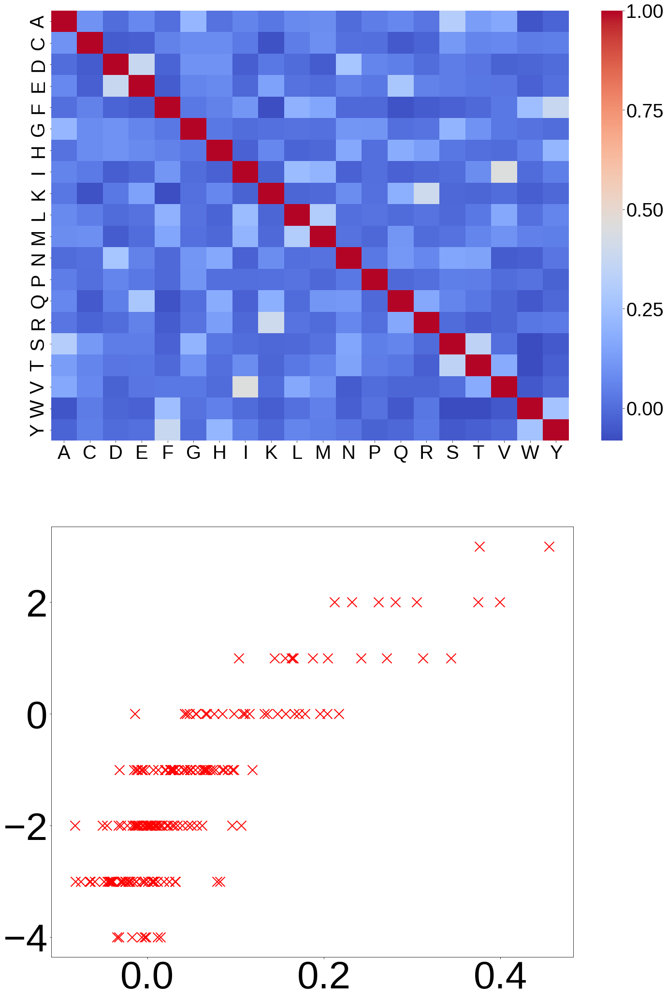

Pearson's correlation: 0.833


In [61]:
# plot embeddings and correlation for ProtBert
print("Prot Bert")
process_embeddings_and_plot(embeddings_matrix_protbert, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtBert".format(folder_path))

# plot embeddings and correlation for ProtBertBFD
print("Prot Bert BFD")
process_embeddings_and_plot(embeddings_matrix_prot_bert_bfd, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtBertBFD".format(folder_path))

# plot embeddings and correlation for ProtT5
print("Prot T5 XL BFD")
process_embeddings_and_plot(embeddings_matrix_prot_t5_xl_bfd, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtT5XLBFD".format(folder_path))

# plot embeddings and correlation for ProtXLNet
print("Prot XLNet")
process_embeddings_and_plot(embeddings_matrix_prot_xlnet, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtXLNet".format(folder_path))

# plot embeddings and correlation for ProtAlbert
print("Prot Albert")
process_embeddings_and_plot(embeddings_matrix_prot_albert, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtAlbert".format(folder_path))

# plot embeddings and correlation for ProtGPT2
print("Prot GPT2")
process_embeddings_and_plot(embeddings_matrix_protgpt2, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_ProtGPT2".format(folder_path))

# plot embeddings and correlation for TAPE Bert
print("TAPE Bert")
process_embeddings_and_plot(embeddings_matrix_tape_bert, amino_acids, amino_dict, blosum62_normalized_flat, "{}/model_evaluation/adobe_plots/correlation_cosine_BLOSUM62_scatter_TAPEBert".format(folder_path))

In [46]:
# load training data
train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

import numpy as np
import torch
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Import the necessary libraries
import random

# 2. Modify the train_array to have 10,00 random samples
random_indices = np.random.choice(train_array.shape[0], 1000, replace=False)
train_array_random = train_array[random_indices]

# 3. Create a function to process a single data pair and return the average attention heatmap
def process_data_pair(model_use, task_target, dec_comple_peptide_pred, device):
    dec_prob, dec_attention_weight_seq = evaluate_single(model_use, task_target, dec_comple_peptide_pred, amino_dict, prediction_length + 2, device, save_attention_weights=True, print_info=False)
    decoder_encoder_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in dec_attention_weight_seq[-1][1]]
    decoder_encoder_attention = [torch.tensor(np.delete(layer_attention.detach().numpy(), -1, 3)) for layer_attention in decoder_encoder_attention_raw]
    decoder_encoder_attention_avg = [torch.mean(layer_attention, dim=1) for layer_attention in decoder_encoder_attention]
    decoder_encoder_attention_blocks_avg = torch.mean(torch.stack(decoder_encoder_attention_avg, dim=0), dim=0)
    
    return decoder_encoder_attention_blocks_avg

# 4. Loop through the randomly selected data pairs, process them, and print the informative messages
attention_blocks_avg_list = []

for i, data_pair in enumerate(train_array_random):
    task_target, dec_comple_peptide_pred, _ = data_pair
    attention_blocks_avg = process_data_pair(model_use, task_target, dec_comple_peptide_pred, device)
    attention_blocks_avg_list.append(attention_blocks_avg)
    
    if (i + 1) % 100 == 0:
        print(f'Processed {i + 1} data pairs.')


# Modify the encoder_text to have subscript
encoder_text = ['$X_1$', '$X_2$', '$X_3$', '$X_4$', '$X_5$', '$X_6$', '$X_7$', '$X_8$', '<eos>']
decoder_text = ['<bos>', '$Y_1$', '$Y_2$', '$Y_3$', '$Y_4$', '$Y_5$', '$Y_6$', '$Y_7$', '$Y_8$']
# 5. Calculate the average attention heatmap over all the 1,000 data pairs
final_attention_blocks_avg = torch.mean(torch.stack(attention_blocks_avg_list, dim=0), dim=0).squeeze()


Processed 100 data pairs.
Processed 200 data pairs.
Processed 300 data pairs.
Processed 400 data pairs.
Processed 500 data pairs.
Processed 600 data pairs.
Processed 700 data pairs.
Processed 800 data pairs.
Processed 900 data pairs.
Processed 1000 data pairs.


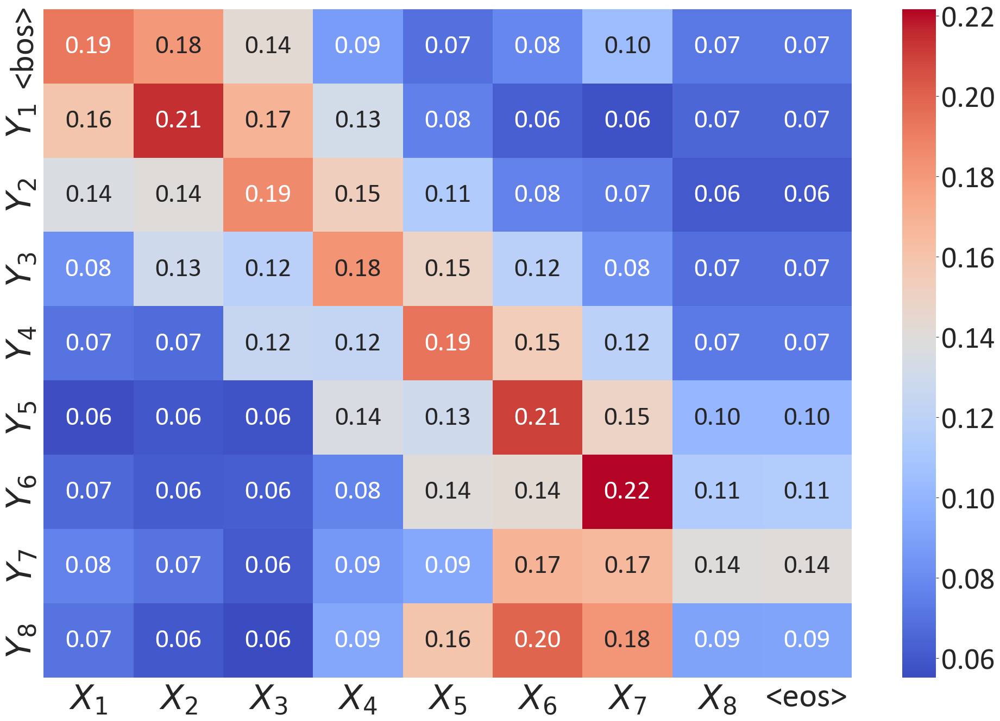

In [47]:
def plot_attention_heatmap(attention_matrix, encoder_text, decoder_text, title, save_path=None):
    plt.rcParams.update({
        'font.size': 40,
        'font.family': 'Calibri',
        'lines.linewidth': 3,
    })
    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    ax = sns.heatmap(attention_matrix, cmap="coolwarm", annot=True, fmt=".2f")
    # Modify xticklabels and yticklabels font size
    ax.set_xticklabels(encoder_text, fontsize=45)  # size can be changed
    ax.set_yticklabels(decoder_text, fontsize=45)  # size can be changed
    
    # Ensure annotation inside heatmap remains the same size
    for t in ax.texts:
        t.set_size(35)  # size can be changed
    
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()

# 6. Plot the final average attention heatmap
plot_attention_heatmap(final_attention_blocks_avg.detach().numpy(), encoder_text, decoder_text, 'Average Cross Attention Heatmap', save_path='{}/model_evaluation/adobe_plots/avg_attention_heatmap.png'.format(folder_path))

#### specific attention maps

In [3]:
# load training data
train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

# Sort based on the third column (convert it to integers for proper comparison)
sorted_train_array = train_array[train_array[:,2].astype(int).argsort()[::-1]]

In [4]:
# Get the top N data
N = 50
top_N_data = sorted_train_array[:N]

print("Top N data: ", top_N_data)

Top N data:  [['RALRLEDL' 'PTVRFAAL' '52354']
 ['ALRLEDLR' 'TVRFAALI' '19000']
 ['KTHVTHHP' 'LAWCRLTA' '11676']
 ['ALRLEDLR' 'TMRFAALI' '10162']
 ['RKVARVRL' 'TYVRTCVG' '8370']
 ['GVCTRVYT' 'LRVRAVKR' '8370']
 ['AAIVNLVP' 'KEKIEAFK' '7571']
 ['RKVARVRL' 'TYVRTCTG' '7241']
 ['GTCTRVYT' 'LRVRAVKR' '7241']
 ['LRSQCAYD' 'TLHYVSAL' '6600']
 ['GVHRLVRI' 'VSAFSTHR' '5923']
 ['PVLPTVHY' 'IGTPHFQV' '5784']
 ['VQFHPTGI' 'YHVTPLVP' '5784']
 ['CIIVCSIE' 'RVVEMEYE' '5549']
 ['GVCTRVYT' 'LRVKAVKR' '5411']
 ['RKVAKVRL' 'TYVRTCVG' '5411']
 ['GELGIFLI' 'AEVRVYLE' '5301']
 ['ELYVRVEA' 'ILFIGLEG' '5301']
 ['IAVKARRV' 'EIPVQHTS' '5013']
 ['ARELMCIR' 'AEKIVAVI' '4528']
 ['RALRLEDL' 'PTMRFAAL' '4463']
 ['SVYTGTII' 'LESRYYIG' '4308']
 ['GIYYRSEL' 'IITGTYVS' '4308']
 ['GVCTRVYT' 'LRVRCVKR' '3983']
 ['RKVCRVRL' 'TYVRTCVG' '3983']
 ['AFFQFYVA' 'QYLQCSLK' '3875']
 ['AKVKLARH' 'KGITKLLR' '3774']
 ['HTLNGSGL' 'VIQVMEVK' '3736']
 ['GNWDLVGN' 'TYFKVAFG' '3642']
 ['GFAVKFYT' 'NGVLDWNG' '3642']
 ['VCYAGIDT' 'FAVRGAGK'

In [6]:
['KTHVTHHP', 'LAWCRLTA', '11676']

['KTHVTHHP', 'LAWCRLTA', '11676']

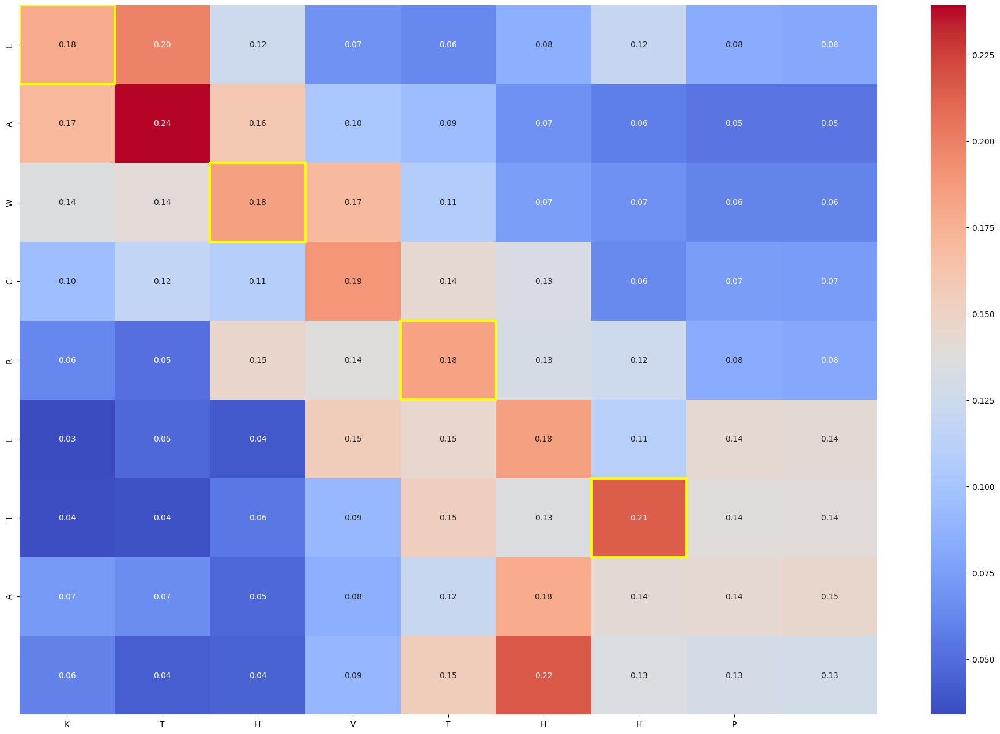

In [5]:
import numpy as np
import torch
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Import the necessary libraries
import random

# 3. Create a function to process a single data pair and return the average attention heatmap
def process_data_pair(model_use, task_target, dec_comple_peptide_pred, device):
    dec_prob, dec_attention_weight_seq = evaluate_single(model_use, task_target, dec_comple_peptide_pred, amino_dict, prediction_length + 2, device, save_attention_weights=True, print_info=False)
    decoder_encoder_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in dec_attention_weight_seq[-1][1]]
    decoder_encoder_attention = [torch.tensor(np.delete(layer_attention.detach().numpy(), -1, 3)) for layer_attention in decoder_encoder_attention_raw]
    decoder_encoder_attention_avg = [torch.mean(layer_attention, dim=1) for layer_attention in decoder_encoder_attention]
    decoder_encoder_attention_blocks_avg = torch.mean(torch.stack(decoder_encoder_attention_avg, dim=0), dim=0)

    return decoder_encoder_attention_blocks_avg

def highlight_hydrogen_bonds(attention_map, interactions, encoder_text, decoder_text, save_path=None):
    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    sns.heatmap(attention_map, xticklabels=encoder_text, yticklabels=decoder_text, cmap="coolwarm", annot=True, fmt=".2f")

    for bond in interactions:
        # Extract residue positions from interaction
        encoder_residue = int(bond[0][-1]) - 1  # Using the last character of the first element
        decoder_residue = int(bond[1][-1]) - 1  # Using the last character of the second element

        # Highlight the corresponding cell in the heatmap
        plt.gca().add_patch(plt.Rectangle((encoder_residue, decoder_residue), 1, 1, fill=False, edgecolor='yellow', lw=3))

    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()

# Given peptide-target pair
target = 'KTHVTHHP'
peptide = 'LAWCRLTA'
# peptide = 'AAAAAAAA'

# List of specified hydrogen bond interactions (as provided)
interactions = [
    ('K1', 'L1'),
    ('H3', 'W3'),
    ('T5', 'R5'),
    ('H7', 'T7')
]

# Generate attention map for the provided peptide-target pair
attention_map_for_pair = process_data_pair(model_use, target, peptide, device).detach().numpy()
attention_map_2d = attention_map_for_pair[0]

# Plot attention map with highlighted hydrogen bonds
# highlight_hydrogen_bonds(attention_map_for_pair, interactions, list(peptide), list(target), save_path='{}/model_evaluation/adobe_plots/specific_hydrogen_bond_attention_map.png'.format(folder_path))
highlight_hydrogen_bonds(attention_map_2d, interactions, list(target), list(peptide))

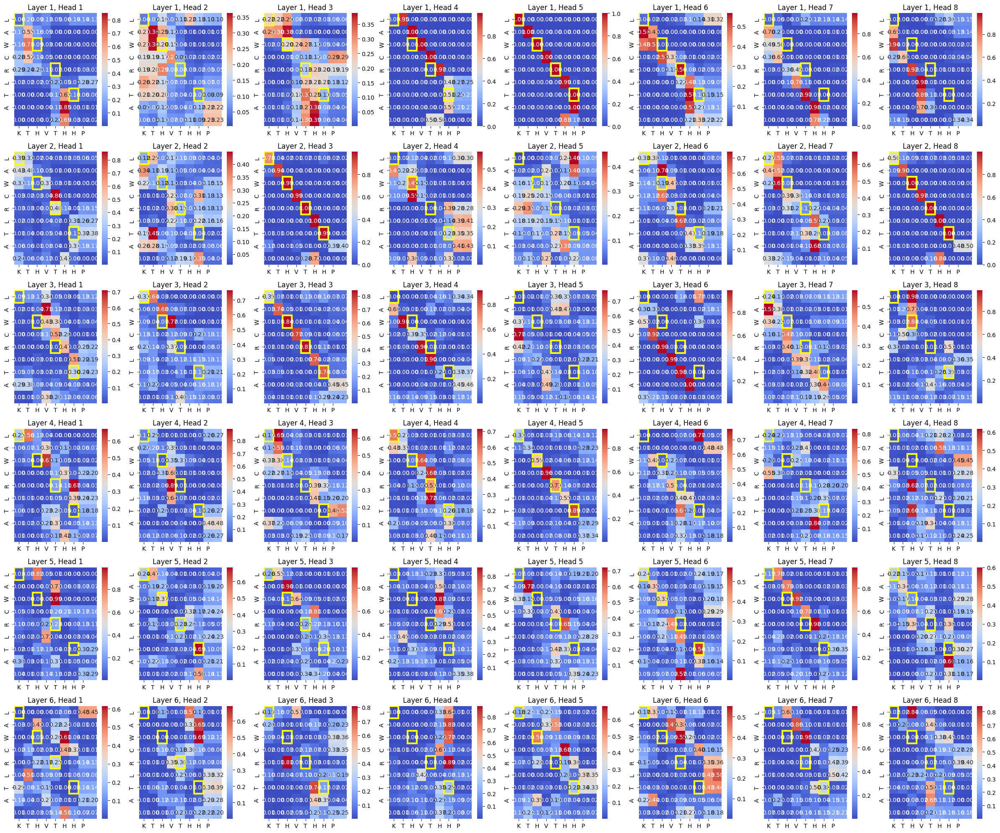

In [7]:
import numpy as np
import torch
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Import the necessary libraries
import random

# 3. Create a function to process a single data pair and return the attention heatmaps for all layers and heads
def process_data_pair(model_use, task_target, dec_comple_peptide_pred, device):
    dec_prob, dec_attention_weight_seq = evaluate_single(model_use, task_target, dec_comple_peptide_pred, amino_dict, prediction_length + 2, device, save_attention_weights=True, print_info=False)
    print()
    decoder_encoder_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in dec_attention_weight_seq[-1][1]]
    decoder_encoder_attention = [torch.tensor(np.delete(layer_attention.detach().numpy(), -1, 3)) for layer_attention in decoder_encoder_attention_raw]
    return decoder_encoder_attention

def highlight_hydrogen_bonds(ax, attention_map, interactions, encoder_text, decoder_text):
    sns.heatmap(attention_map, xticklabels=encoder_text, yticklabels=decoder_text, cmap="coolwarm", annot=True, fmt=".2f", ax=ax)

    for bond in interactions:
        # Extract residue positions from interaction
        encoder_residue = int(bond[0][-1]) - 1
        decoder_residue = int(bond[1][-1]) - 1

        # Highlight the corresponding cell in the heatmap
        ax.add_patch(plt.Rectangle((encoder_residue, decoder_residue), 1, 1, fill=False, edgecolor='yellow', lw=3))

# Given peptide-target pair
target = 'KTHVTHHP'
peptide = 'LAWCRLTA'

# List of specified hydrogen bond interactions (as provided)
interactions = [
    ('K1', 'L1'),
    ('H3', 'W3'),
    ('T5', 'R5'),
    ('H7', 'T7')
]

attention_maps = process_data_pair(model_use, target, peptide, device)

fig, axes = plt.subplots(6, 8, figsize=(24, 20))  # 6 layers, 8 heads

for i, layer in enumerate(attention_maps):
    for j, head in enumerate(layer[0]):  # removing the batch dimension
        attention_map = head.numpy()
        ax = axes[i, j]
        sns.heatmap(attention_map, xticklabels=list(target), yticklabels=list(peptide), cmap="coolwarm", annot=True, fmt=".2f", ax=ax)

        # Highlight hydrogen bonds
        for bond in interactions:
            encoder_residue = int(bond[0][-1]) - 1
            decoder_residue = int(bond[1][-1]) - 1
            ax.add_patch(plt.Rectangle((encoder_residue, decoder_residue), 1, 1, fill=False, edgecolor='yellow', lw=3))

        ax.set_title(f"Layer {i+1}, Head {j+1}")

plt.tight_layout()
# optional save
plt.savefig('{}/model_evaluation/adobe_plots/attention_maps_all_layers.png'.format(folder_path), bbox_inches='tight')
# save as a pdf
plt.savefig('{}/model_evaluation/adobe_plots/attention_maps_all_layers.pdf'.format(folder_path), bbox_inches='tight')
plt.show()

## Evaluate RBMDiff subset 8

In [1]:
# load RBMDiff data from datasets/DiffRBM/contacts_ang4_fin.tsv
import pandas as pd

rbmdiff_data = pd.read_csv('datasets/DiffRBM/contacts_ang4_fin.tsv', sep='\t')

In [6]:
rbmdiff_data.head()

,Unnamed: 0,PDB,Ligand,Ligand full,HLA,CDR3 seq,CDR3 seq al,TCR contact positions,HLA contact positions,Pep contact positions (TCRbeta),Pep contact positions (CDR3beta),Mutations
0,0,1ao7,LLFGYPVYV,LLFGYPVYV,HLA-A*02:01,CASRPGLAGGRPEQYF,CASR----PGLAGGRPEQYF,1 5 7 8,1 2 3 5 6 7 8 9,28 92 95 97 98 100,4 7 9 10 12,beta-2 microglobulin
1,1,1bd2,LLFGYPVYV,LLFGYPVYV,HLA-A*02:01,CASSYPGGGFYEQYF,CASSY-----PGGGFYEQYF,1 5 7 8,1 2 3 5 6 7 8 9,93 94 95 99,5 6 7 11,no
2,2,1lp9,ALWGFFPVL,ALWGFFPVL,HLA-A*02:01,CASSDWVSYEQYF,CASS-------DWVSYEQYF,3 5 6 8,1 2 3 5 6 7 8 9,31 96 98,6 8,no
3,3,1oga,GILGFVFTL,GILGFVFTL,HLA-A*02:01,CASSSRSSYEQYF,CASS-------SRSSYEQYF,5 6 8,2 3 5 6 7 8 9,28 48 49 94 95 96,6 7 8,no
4,4,1qrn,LLFGYAVYV,LLFGYAVYV,HLA-A*02:01,CASRPGLAGGRPEQYF,CASR----PGLAGGRPEQYF,5 7 8,1 2 3 5 6 7 8 9,28 92 95 96 97 98 100,4 7 8 9 10 12,no


## prediction (Hamming distance)

In [64]:
task_target = 'QPRTFLLK'
# task_target = 'LEILDITP'
# task_target = 'TLEILDIT'
# task_target = 'LCGEDLII'

num_candidates = 10000

# read peptide candidates from a txt file in a model prediction folder
with open('{}/model_prediction/{}_{}candidates.txt'.format(folder_path, task_target, num_candidates), 'r') as f:
    peptide_candidates = []
    for line in f:
        peptide_candidates.append(line.strip().split('\t'))
peptide_candidates = np.array(peptide_candidates)

In [65]:
task_hamming_dict = {}
num_data_run = 500
num_folds = 20
for fold_num in range(0, num_folds):
    task_hamming_dict_fold = np.load('{}/train_l8_anti/{}_training_hamming_distance_dict_fold'.format(dataset_path, task_target)+str(fold_num)+'.npy', allow_pickle=True)
    task_hamming_dict_fold = task_hamming_dict_fold.tolist()
    for batch_num, data_dict in task_hamming_dict_fold.items():
        task_hamming_dict[batch_num+fold_num*num_data_run] = data_dict


from collections import defaultdict

def plot_box_plot(minimum_hamming_distance, probabilities, filename):
    plt.rcParams.update({
        'font.size': 80,
        'font.family': 'Liberation Sans',
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    # Group probabilities by hamming distances
    grouped_probs = defaultdict(list)
    for dist, prob in zip(minimum_hamming_distance, probabilities):
        grouped_probs[dist].append(prob)
    
    # Prepare data for boxplot
    distances = sorted(list(grouped_probs.keys()))
    box_plot_data = []
    for dist in distances:
        data = grouped_probs[dist]
        box_plot_data.append(data)
        print(f'Hamming distance {dist}: {len(data)} data points')

    # Create the box plot
    bp = plt.boxplot(box_plot_data, positions=range(len(distances)), widths=0.5, showfliers=True, patch_artist=True)

    # Set box colors
    colors = ['blue'] * len(distances)
    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)

    # Set the median line style and color
    for median in bp['medians']:
        median.set(color='black', linewidth=3)

    # Set the x-axis labels
    plt.xticks(range(len(distances)), distances)

    # Set the y-axis to log scale
    plt.gca().set_yscale('log')

    plt.grid(True)

    # Save the plot
    plt.savefig(filename, bbox_inches='tight')

    # Show the plot
    plt.show()

Hamming distance 0: 36 data points
Hamming distance 1: 1388 data points
Hamming distance 2: 7880 data points
Hamming distance 3: 696 data points


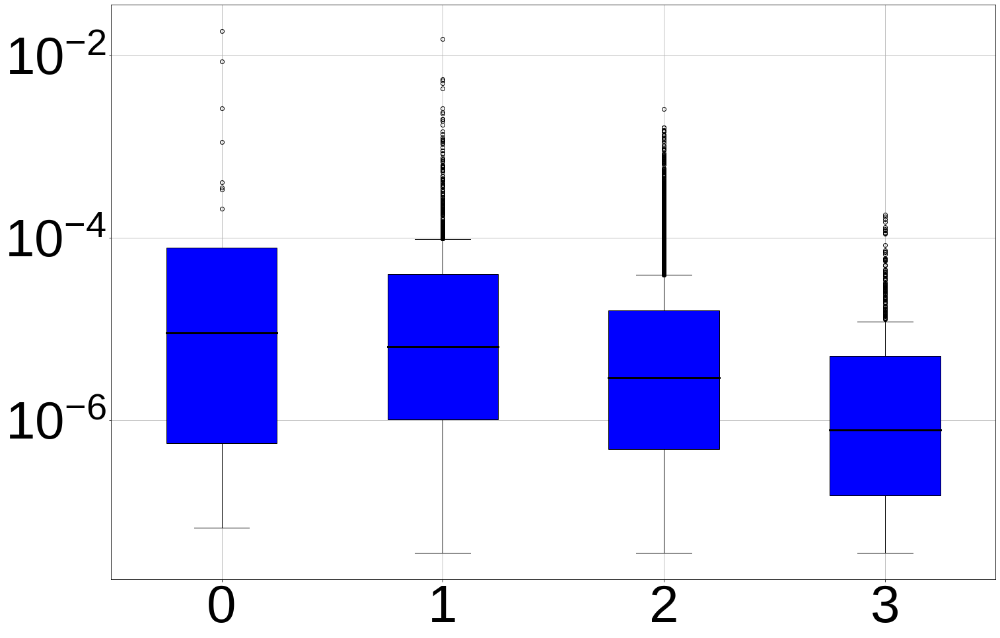

In [66]:
minimum_hamming_distance = []
for i in range(len(peptide_candidates)):
    minimum_hamming_distance.append(min(task_hamming_dict[i].keys()))
plot_box_plot(minimum_hamming_distance, peptide_candidates[:, 1].astype(float), '{}/model_evaluation/adobe_plots/hamming_vs_prob_{}_{}.png'.format(folder_path, task_target, num_candidates))

## prediction (Hamming distance)

In [67]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn_extra.cluster import KMedoids 
import scipy.spatial.distance as ssd
from sklearn.metrics import silhouette_score

font_size = 80

In [68]:
# K-medoids
peptide_candidates_num, peptide_candidates_num_copy = seq2num(peptide_candidates[:, 0], peptide_candidates[:, 0], amino_dict)

# Calculate the pairwise Hamming distance matrix
condensed_distance_matrix = ssd.pdist(peptide_candidates_num, 'hamming')
distance_matrix = ssd.squareform(condensed_distance_matrix)

# Run K-medoids clustering with different numbers of clusters and store the silhouette scores
silhouette_scores = []
max_clusters = 50  # You can adjust this depending on the desired range of cluster numbers to test
for i in range(2, max_clusters + 1):  # Start from 2 clusters as silhouette score is not defined for 1 cluster
    kmedoids = KMedoids(n_clusters=i, init='k-medoids++', random_state=42, metric='precomputed')
    kmedoids.fit(distance_matrix)
    cluster_labels = kmedoids.labels_
    silhouette_avg = silhouette_score(distance_matrix, cluster_labels, metric='precomputed')
    silhouette_scores.append(silhouette_avg)

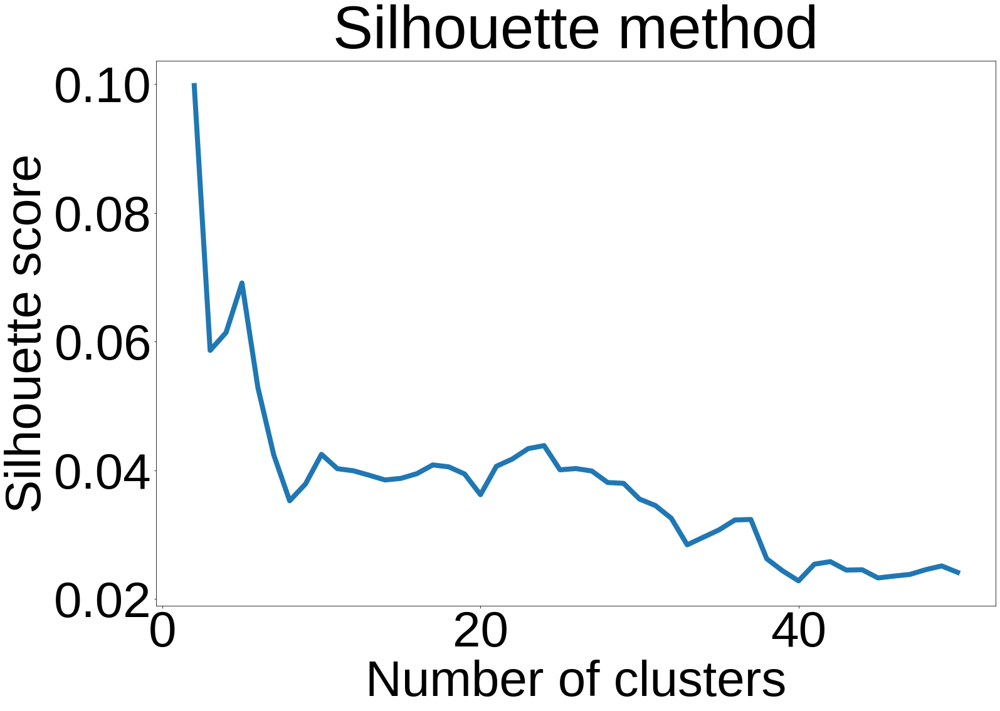

In [69]:
# Plot the silhouette scores curve
plt.rcParams.update({
    'font.size': font_size,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 8,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot(range(2, max_clusters + 1), silhouette_scores)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette score')
plt.title('Silhouette method')
plt.show()

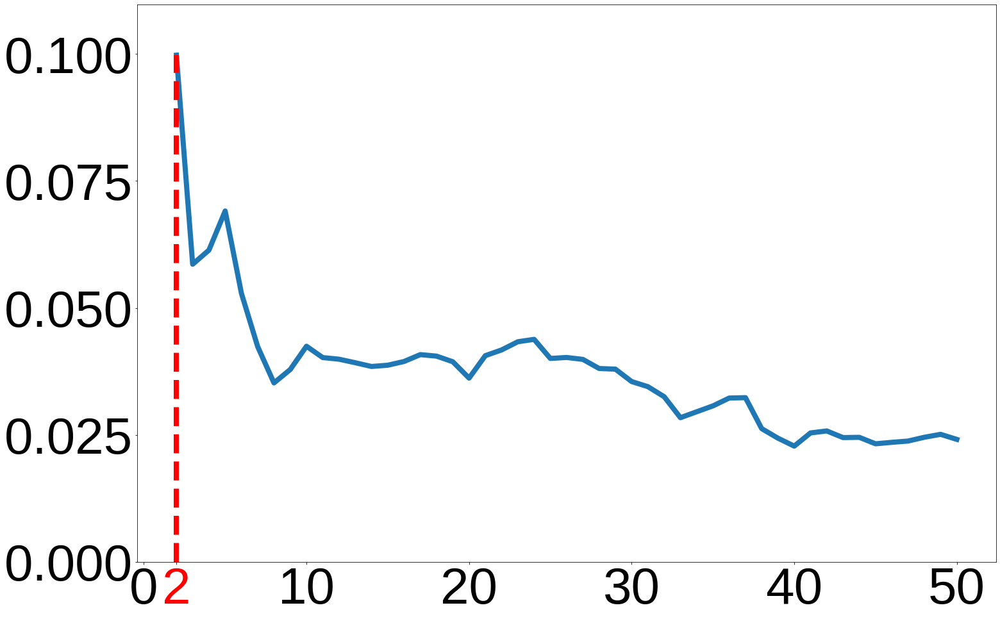

In [70]:
optimal_clusters = silhouette_scores.index(max(silhouette_scores)) + 2

# Plot the silhouette scores curve
fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))
ax.plot(range(2, max_clusters + 1), silhouette_scores)

# Draw a dotted red line from the optimal cluster point on the x-axis to the curve
ax.plot([optimal_clusters, optimal_clusters], [0, silhouette_scores[optimal_clusters - 2]], color='red', linestyle='--', clip_on=True)

# Set y-axis limit to avoid the red line going outside the graph
ax.set_ylim(0, max(silhouette_scores) * 1.1)

# Set x-tick labels with the optimal cluster labeled and other labels at an interval of 10
x_tick_labels = list(range(0, max_clusters + 1, 10))
x_tick_labels.insert(x_tick_labels.index((optimal_clusters // 10) * 10) + 1, optimal_clusters)
ax.set_xticks(x_tick_labels)
ax.set_xticklabels([str(x) if x != optimal_clusters else f'{optimal_clusters}' for x in x_tick_labels])

# Get the x-tick labels and set the color of the optimal cluster label to red
xtick_labels = ax.get_xticklabels()
xtick_labels[x_tick_labels.index(optimal_clusters)].set_color('red')

# plt.xlabel('Number of clusters')
# plt.ylabel('Silhouette Scores')
# plt.title('Silhouette Scores Method')
# plt.savefig('model_prediction/clustering_kmedoids_silhouette_{}_{}.png'.format(task_target, num_candidates), bbox_inches='tight')
plt.savefig('{}/model_evaluation/adobe_plots/clustering_kmedoids_silhouette_{}_{}.png'.format(folder_path, task_target, num_candidates), bbox_inches='tight')
plt.show()

In [71]:
# Perform K-medoids clustering with the optimal number of clusters
optimal_clusters = silhouette_scores.index(max(silhouette_scores)) + 2
kmedoids = KMedoids(n_clusters=optimal_clusters, init='k-medoids++', random_state=42, metric='precomputed')
cluster_labels = kmedoids.fit_predict(distance_matrix)

# Perform t-SNE dimensionality reduction using the precomputed Hamming distance matrix
tsne = TSNE(n_components=2, random_state=42, perplexity=30, metric='precomputed')
peptide_candidates_tsne = tsne.fit_transform(distance_matrix)

/rds/general/user/hz3519/home/anaconda3/envs/UROP_transformer/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/rds/general/user/hz3519/home/anaconda3/envs/UROP_transformer/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


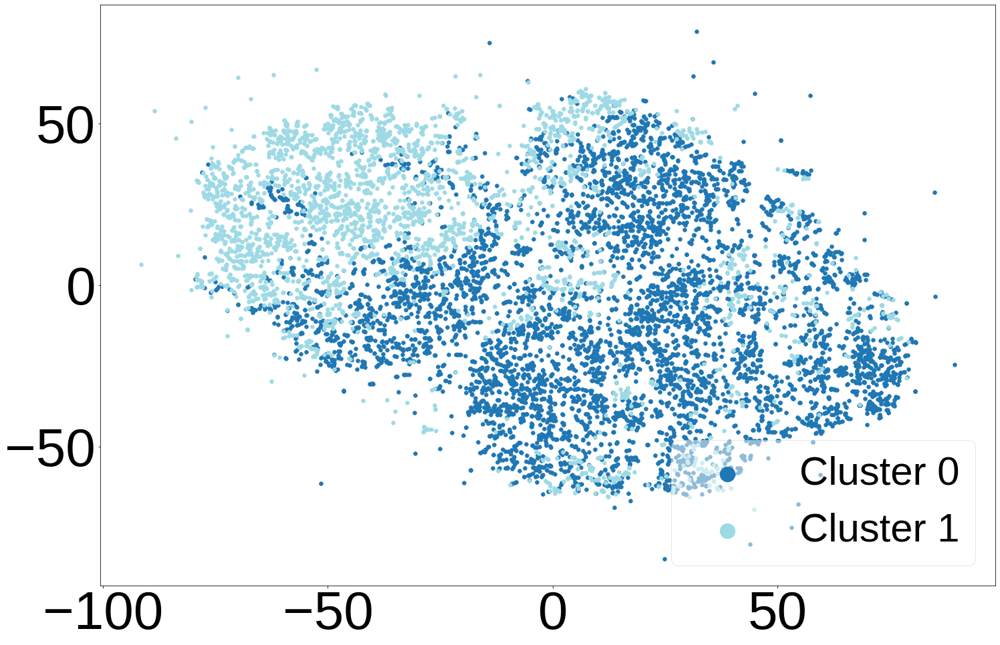

In [72]:
# Plot the clusters
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
cmap = plt.cm.get_cmap('tab20', optimal_clusters)  # Color map with enough colors for the optimal number of clusters

for i in range(optimal_clusters):
    plt.scatter(peptide_candidates_tsne[cluster_labels == i, 0], peptide_candidates_tsne[cluster_labels == i, 1], s=30, c=[cmap(i)], label=f'Cluster {i}')

# Get current legend
legend = plt.legend(loc='lower right', fontsize=60, framealpha=0.5)

# Set legend marker size
legend_handle_size = 500  # You can adjust this value as needed
for handle in legend.legendHandles:
    handle._sizes = [legend_handle_size]

# plt.title('t-SNE visualization of peptide clusters')
# plt.xlabel('t-SNE 1')
# plt.ylabel('t-SNE 2')
# plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.03))
# plt.savefig('model_prediction/clustering_kmedoids_tsne_{}_{}.png'.format(task_target, num_candidates), bbox_inches='tight')
plt.savefig('{}/model_evaluation/adobe_plots/clustering_kmedoids_tsne_{}_{}.png'.format(folder_path, task_target, num_candidates), bbox_inches='tight')
plt.show()

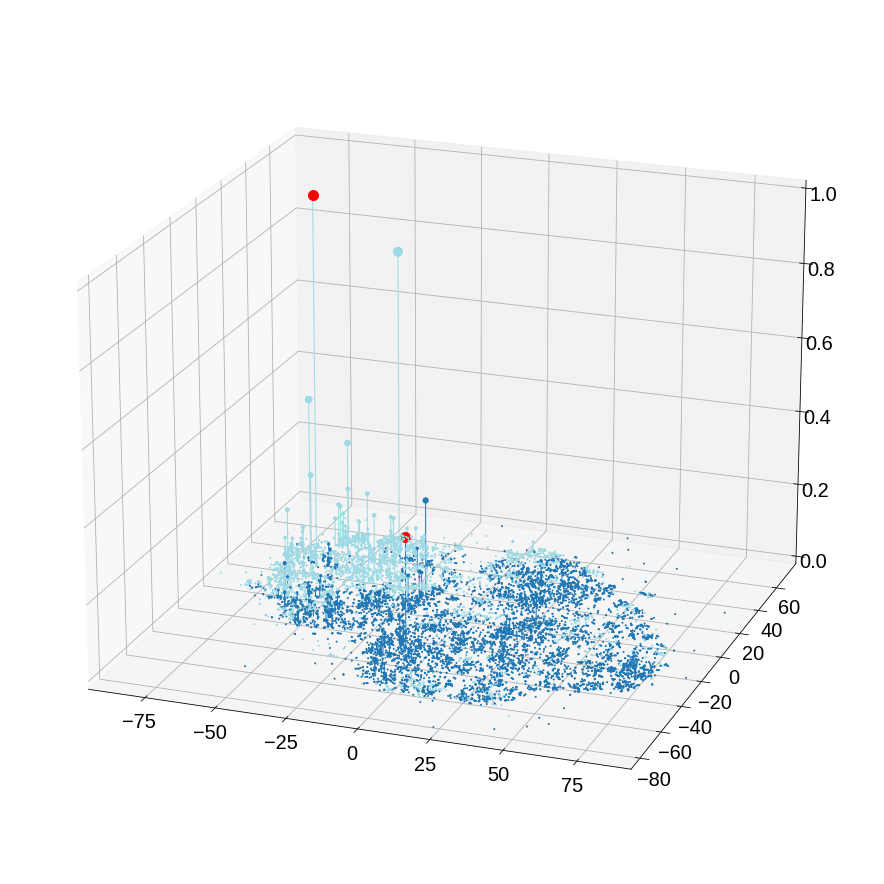

In [73]:
# Scale the x and y coordinates for better visualization
scaling_factor = 1  # You can adjust this factor based on your needs
x = peptide_candidates_tsne[:, 0] * scaling_factor
y = peptide_candidates_tsne[:, 1] * scaling_factor

# Calculate the third coordinate using the probability values from peptide_candidates
z = peptide_candidates[:, 1].astype(float)

# Normalize the probability values for better visualization
z_normalized = (z - np.min(z)) / (np.max(z) - np.min(z))

# Calculate the size of the scatter points based on their probabilities
min_size = 1  # You can adjust the minimum size of the points
max_size = 100  # You can adjust the maximum size of the points
sizes = min_size + z_normalized * (max_size - min_size)

# Find the indices of the peptides with the highest probability in each cluster
highest_prob_indices = []
for i in range(optimal_clusters):
    cluster_indices = np.where(cluster_labels == i)[0]
    highest_prob_index = cluster_indices[np.argmax(peptide_candidates[cluster_labels == i, 1].astype(float))]
    highest_prob_indices.append(highest_prob_index)

# Create a 3D scatter plot
font_size = 40
plt.rcParams.update({
    'font.size': 20,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

fig = plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
ax = fig.add_subplot(111, projection='3d')

# Define the colors for each cluster
colors = [cmap(cluster) for cluster in cluster_labels]

# Plot the points with colors based on their cluster assignments and sizes based on their probabilities
x_remove = []
y_remove = []
z_remove = []
color_remove = []
size_remove = []
for i, (x_coord, y_coord, z_coord, color, size) in enumerate(zip(x, y, z_normalized, colors, sizes)):
    if i not in highest_prob_indices:
        x_remove.append(x_coord)
        y_remove.append(y_coord)
        z_remove.append(z_coord)
        color_remove.append(color)
        size_remove.append(size)
                
ax.scatter(x_remove, y_remove, z_remove, c=color_remove, s=size_remove, alpha = 1)

for i, (x_coord, y_coord, z_coord, color, size) in enumerate(zip(x, y, z_normalized, colors, sizes)):
    if i in highest_prob_indices:
        ax.scatter(x_coord, y_coord, z_coord, color='red', s=max_size, alpha = 1)
    ax.plot([x_coord, x_coord], [y_coord, y_coord], [0, z_coord], c=color, lw=1, alpha = 1)

# ax.set_xlabel('t-SNE 1', fontsize = font_size, labelpad=30)
# ax.set_ylabel('t-SNE 2', fontsize = font_size, labelpad=30)
# ax.set_zlabel('Normalized Probability', fontsize = font_size, labelpad=30)

ax.set_xlim(min(x), max(x))
ax.set_ylim(min(y), max(y))
ax.set_zlim(min(z_normalized), max(z_normalized))

elevation_angle = 20  # You can adjust the elevation angle (in degrees)
azimuth_angle = -70  # You can adjust the azimuth angle (in degrees)
ax.view_init(elevation_angle, azimuth_angle)

# plt.title('3D Probability Distribution Plot', fontsize = 35, pad=5)

# plt.savefig('model_prediction/clustering_kmedoids_3dprob_{}_{}.png'.format(task_target, num_candidates), bbox_inches='tight')
plt.savefig('{}/model_evaluation/adobe_plots/clustering_kmedoids_3dprob_{}_{}.png'.format(folder_path, task_target, num_candidates), bbox_inches='tight')
plt.show()

#### explore cascade database

In [3]:
import pickle
import numpy as np
import torch
import torch.nn as nn
from d2l import torch as d2l
import os

from TransformerBeta import *
import warnings
warnings.filterwarnings("ignore", message="mybio.py module not found")
warnings.filterwarnings("ignore", message="zyggregator not found!!!")

"""---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------"""
"""Data preprocessing"""

amino_dict = {
		'<bos>': 0, 
		'<eos>': 1, 
		'<pad>': 2, 
		'<unk>': 3,
		'A': 4,
		'C': 5,
		'D': 6, 
		'E': 7,
		'F': 8, 
		'G': 9, 
		'H': 10,
		'I': 11, 
		'K': 12, 
		'L': 13, 
		'M': 14, 
		'N': 15, 
		'P': 16, 
		'Q': 17, 
		'R': 18, 
		'S': 19, 
		'T': 20, 
		'V': 21, 
		'W': 22, 
		'Y': 23 
		}


data_list_antiparallel= []
data_list_parallel= []

for i in range(1, 9):
	with open('BSn_libraries/BSn_libraries_copy/anti_frag_dic_{}.pkl'.format(i), 'rb') as f:
		data = pickle.load(f, encoding='latin1')
		data_list_antiparallel.append(data)

	with open('BSn_libraries/BSn_libraries_copy/para_frag_dic_{}.pkl'.format(i), 'rb') as f:
		data = pickle.load(f, encoding='latin1')
		data_list_parallel.append(data)

# target, complementary_seq, counts, promiscuity, length, working_score, hb_pattern, para/anti, freq
BSn_data = []
least_length = 3

for frag_i_data in data_list_parallel[least_length-1:]:
	for keys in frag_i_data.keys():

		length = len(keys)
		freq = len(frag_i_data[keys])
		for element in frag_i_data[keys]:

			working_score = length**2 * element.count_score - 0.01 * length * element.promiscuity_score
			list_i = [keys, element.complementary_sequence, element.count_score, element.promiscuity_score, length, working_score, element.hb_pattern, 0, freq]
			BSn_data.append(list_i)

for frag_i_data in data_list_antiparallel[least_length-1:]:
	for keys in frag_i_data.keys():

		length = len(keys)
		freq = len(frag_i_data[keys])
		for element in frag_i_data[keys]:

			working_score = length**2 * element.count_score - 0.01 * length * element.promiscuity_score
			list_i = [keys, element.complementary_sequence, element.count_score, element.promiscuity_score, length, working_score, element.hb_pattern, 1, freq]
			BSn_data.append(list_i)

# target, complementary_seq, counts, promiscuity, length, working_score, hb_pattern, para/anti, freq

BSn_data_dataset_sequence = np.array(BSn_data, dtype=object)
BSn_data_dataset2 = np.array(BSn_data_dataset_sequence)

target_indices = np.arange(BSn_data_dataset2.shape[0]).reshape(-1, 1)
BSn_data_dataset2_indices = np.hstack([BSn_data_dataset2, target_indices])

condition1 = np.nonzero(np.array([len(sequence)==8 and type ==1 for type, sequence in zip(BSn_data_dataset2_indices[:, 7], BSn_data_dataset2_indices[:, 0])]))
BSn_data_dataset2_indices_length8 = BSn_data_dataset2_indices[condition1]

WARNING mybio.py module not found - excecution may fail
WARNING zyggregator not found!!!


In [ ]:
# load training data
train_dict = np.load('{}/train_l8_anti/train_dict_fold0.npy'.format(dataset_path), allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

In [14]:
# assign data to use 
BSn_database = BSn_data_dataset2_indices_length8[:, [0, 1]]

def is_in_training_set(target, comp, train_array):
    for entry in train_array:
        if entry[0] == target and entry[1] == comp:
            print(entry)
            return True
    return False

# combine the true or false array to the BSn_database
num = 50 # number of data points to check
BSn_database_true_false = []
for i in range(num):
	target = BSn_database[i][0]
	comp = BSn_database[i][1]
	BSn_database_true_false.append(is_in_training_set(target, comp, train_array))
    
BSn_database_true_false = np.array(BSn_database_true_false)
BSn_database_subset = BSn_database[:num, :]
BSn_database_subset = np.hstack([BSn_database_subset, BSn_database_true_false.reshape(-1, 1)])

['FHLYLMHK' 'YTAHRLSW' '29']
['LALLIGYG' 'RVVQAAYS' '164']
['RDFVVLRT' 'LVYQYIET' '67']
['KPEQLAIR' 'DLAHWVFS' '33']
['VNIRVAVL' 'TCVDVRLT' '24']
['LVVQAGLF' 'AYLAFCLR' '13']


In [15]:
BSn_database_subset

array([['VTPRVSYA', 'YDAGVIVQ', False],
       ['SIHVVEVQ', 'VTSTLKYH', False],
       ['SIHVVEVQ', 'ILIVGAFG', False],
       ['CNKSWRCG', 'YAQYYGKY', False],
       ['VLEVRGEV', 'RYVLSLAV', False],
       ['FHLYLMHK', 'YTAHRLSW', True],
       ['VLVNYIYF', 'FLASGTSI', False],
       ['SIHVVEVK', 'VTSTLKYV', False],
       ['LALLIGYG', 'RVVQAAYS', True],
       ['GKYELKVL', 'AQFNYTDY', False],
       ['TLERRYWL', 'SLSWRVRQ', False],
       ['LRLCLSRT', 'VSLTGIVT', False],
       ['TYTFQLQD', 'VVTSHNTA', False],
       ['YLVTIVLN', 'RTITMRVR', False],
       ['SLSSSVTV', 'KVLCGLTV', False],
       ['RDFVVLRT', 'LVYQYIET', True],
       ['YDFELIFS', 'IRSTARKS', False],
       ['TFSQPVTI', 'TGSFTTTG', False],
       ['RLFKGIVK', 'YGIVTKFY', False],
       ['FQLSLAFP', 'SKQTYSAG', False],
       ['ANLNFEFF', 'GHLLAEIH', False],
       ['TISVVFKR', 'TVTVWRDY', False],
       ['FLVSADII', 'ISTRLSCL', False],
       ['ATFNVSYR', 'FERVAEAT', False],
       ['ELLARVYA', 'RGQVTAQW', False],
   

In [48]:
task_target = 'SIHVVEVQ'
comp_target = 'VTSTLKYH'

# dataset same search
print("Training Dataset search result: \n", search_target(train_array, task_target))

# dataset similar search
print("Training Dataset similar search result: \n", search_target_similar(train_array, task_target, insimilarity_num=2))

Training Dataset search result: 
 []
Training Dataset similar search result: 
 [['SYHVVRVQ' 'NNIVIDYC' '5' '2']
 ['SIVVYEVQ' 'ILQIQKLS' '6' '2']
 ['SIHVVNVL' 'IVASCEIV' '54' '2']
 ['SIHVVNVL' 'VVSSCEIV' '6' '2']
 ['EIQVVEVQ' 'SAGEIEVI' '7' '2']]


In [49]:
import os
import numpy as np

def length_sorter(length_folder_name):
    try:
        return int(length_folder_name.split('_')[1])
    except ValueError:
        return float('inf')  # Assuming '20more' means it's the largest

# Function to search through the database
def search_database(base_path, task_target, comp_target):
    target_length = max(len(task_target), len(comp_target))
    
    length_list = os.listdir(os.path.join(base_path, 'antiparallel'))
    length_list.sort(key=length_sorter)

    for length in length_list:
        length_name = length_sorter(length)
        if length_name < target_length:
            continue

        length_subfolders = os.listdir(os.path.join(base_path, 'antiparallel', length))
        for subfolder in length_subfolders:
            data = np.load(os.path.join(base_path, 'antiparallel', length, subfolder), allow_pickle=True).tolist()
            
            # Search for task_target and comp_target in the data
            for key, comps in data.items():
                key_fragments = [key[i:i+target_length] for i in range(0, len(key)-target_length+1)]
                comp_fragments = [[comp[i:i+target_length] for i in range(0, len(comp)-target_length+1)] for comp in comps.keys()]

                for key_fragment in key_fragments:
                    if key_fragment == task_target or key_fragment == comp_target[::-1]:
                        comp_index = 0
                        for comp_fragment_list in comp_fragments:
                            for comp_fragment in comp_fragment_list:
                                if comp_fragment == comp_target or comp_fragment == task_target[::-1]:
                                    print(f"Found matching pair in database:")
                                    # print the original key and comp
                                    print(f"Key: {key}, Comp: {list(comps.keys())[comp_index]}, Count: {list(comps.values())[comp_index]}") 
                            comp_index += 1

            # Print indicator after searching through one subfolder
            print(f"Finished searching through subfolder '{subfolder}' with length {length_name}. Number of data points checked: {len(data)}")

# Specify the base path to your database
base_path = "AF2_beta_strand_database"
# Call the function to start the search
search_database(base_path, task_target, comp_target)

Finished searching through subfolder 'data_0.npy' with length 8. Number of data points checked: 5000000
Finished searching through subfolder 'data_1.npy' with length 8. Number of data points checked: 5000000
Finished searching through subfolder 'data_2.npy' with length 8. Number of data points checked: 5000000
Finished searching through subfolder 'data_3.npy' with length 8. Number of data points checked: 5000000
Finished searching through subfolder 'data_4.npy' with length 8. Number of data points checked: 5000000
Finished searching through subfolder 'data_5.npy' with length 8. Number of data points checked: 3053716
Finished searching through subfolder 'data_0.npy' with length 9. Number of data points checked: 5000000
Finished searching through subfolder 'data_1.npy' with length 9. Number of data points checked: 5000000
Finished searching through subfolder 'data_2.npy' with length 9. Number of data points checked: 5000000
Finished searching through subfolder 'data_3.npy' with length 9.

In [26]:
# Calculate amino frequencies
amino_freq_BSn = calculate_amino_freq(BSn_database)
amino_freq_train = calculate_amino_freq(train_array)
print("frequency calculation done")

frequency calculation done


BSn data, 1-site:
R2: 0.8928232682389943
Mean Absolute Error: 0.0076951027
Pearson's correlation coefficient: 0.9448932575899743
color bar: 'Normalized Density'


findfont: Font family ['Calibre'] not found. Falling back to DejaVu Sans.


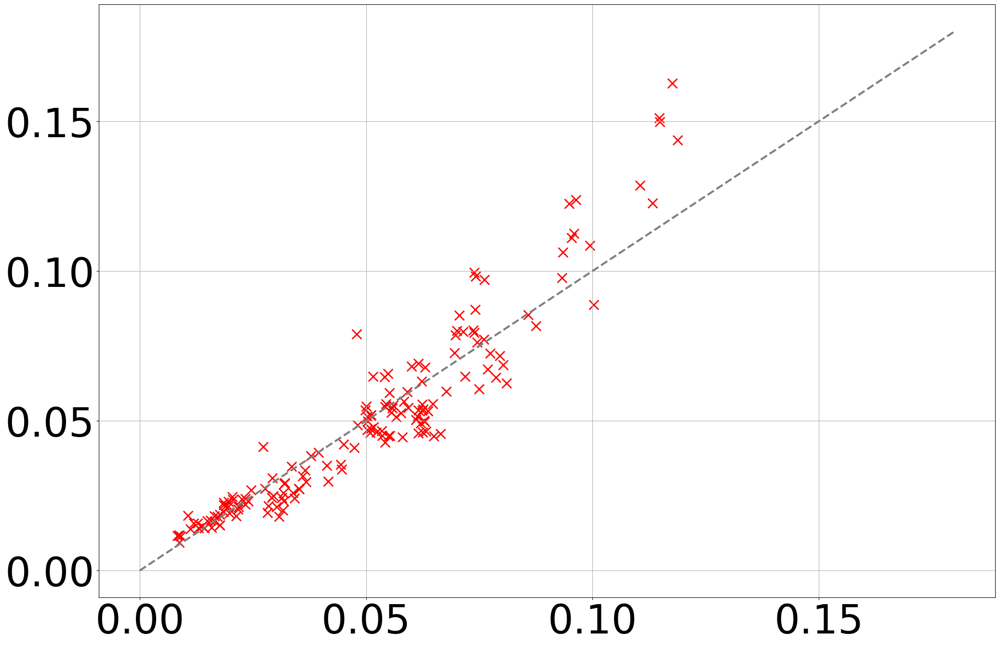

In [27]:
plt.rcParams.update({
    'font.size': 60,
    'font.family': 'Calibre',
    'lines.linewidth': 3,
})

# Plot data for amino acid frequencies and correlations and 3-site correlations
plot_data_exclude_diagonal(amino_freq_BSn, amino_freq_train, "BSn data, 1-site", 0, 0.18)